In [ ]:
!rm -rf sample_data

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [1]:
# !unzip drive/MyDrive/tiles_896.zip

In [ ]:
# !du -chad1 tiles_896/

In [ ]:
# import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy import ndimage as ndi
from skimage import exposure
# from skimage import exposure, filters, morphology, measure
# from skimage.segmentation import clear_border

In [ ]:
from pathlib import Path

def get_images(
    root_dir,
    recursive=False,
    exts=(".jpg", ".jpeg", ".png", ".tif", ".tiff", ".bmp")
):
    """
    Return a sorted list of image paths.

    Args:
        root_dir (str | Path): directory to search
        recursive (bool): if True, search sub-directories recursively
        exts (tuple): allowed image extensions (lowercase)

    Returns:
        List[Path]
    """
    root = Path(root_dir)
    if not root.exists():
        raise FileNotFoundError(root)

    if recursive:
        paths = [p for p in root.rglob("*") if p.suffix.lower() in exts]
    else:
        paths = [p for p in root.iterdir() if p.is_file() and p.suffix.lower() in exts]

    return sorted(paths)

def read_res_float(path):
    im = cv2.imread(str(path), cv2.IMREAD_UNCHANGED)
    if im is None:
        return None
    if im.ndim == 3:
        im = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    arr = im.astype(np.float32)
    if arr.max() > 1.0:
        arr = arr / 255.0
    return arr

def imread_gray(path):
    bgr = cv2.imread(path)
    if bgr is None:
        raise FileNotFoundError(path)
    gray = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY)
    return gray.astype(np.float32), cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)

def show(img, title="", cmap=None):
    plt.figure(figsize=(8,6)); plt.title(title)
    if img.ndim==2:
        plt.imshow(img, cmap=cmap or 'gray')
    else:
        plt.imshow(img)
    plt.show()

In [ ]:
def my_func(img_gray, N_PEAKS=11, PEAK_RADIUS=8, DC_SUPPRESS_RADIUS=3, RESIDUAL_SMOOTH=5):
    img_eq = exposure.equalize_adapthist(img_gray.astype(np.uint8), clip_limit=0.02)
    img = img_eq.astype(np.float32)
    F = np.fft.fft2(img - img.mean())
    Fshift = np.fft.fftshift(F)
    mag = np.log1p(np.abs(Fshift))
    h,w = img.shape
    cy, cx = h//2, w//2
    mag_copy = mag.copy()

    # Suppress DC
    y, x = np.ogrid[:h, :w]
    mask_dc = (x - cx)**2 + (y - cy)**2 <= (DC_SUPPRESS_RADIUS**2)
    mag_copy[mask_dc] = 0.0

    # Pick top N_PEAKS
    flat_idx = np.argsort(mag_copy.ravel())[::-1]
    peak_coords = []
    count = 0
    for idx in flat_idx:
        if count >= N_PEAKS: break
        yy = idx // w; xx = idx % w
        if mag_copy[yy,xx] <= 0: continue
        if any((yy - py)**2 + (xx - px)**2 <= (PEAK_RADIUS*1.5)**2 for (py,px) in peak_coords):
            continue
        peak_coords.append((yy,xx))
        count += 1
    mask = np.zeros_like(mag, dtype=np.uint8)
    for (py,px) in peak_coords:
        yy, xx = np.ogrid[:h, :w]
        disk = (yy - py)**2 + (xx - px)**2 <= (PEAK_RADIUS**2)
        mask[disk] = 1
        symy = (h - py) % h
        symx = (w - px) % w
        disk2 = (yy - symy)**2 + (xx - symx)**2 <= (PEAK_RADIUS**2)
        mask[disk2] = 1
    mask[cy-2:cy+3, cx-2:cx+3] = 1

    # Reconstruct background
    Fmasked = Fshift * mask
    Fmasked_unshift = np.fft.ifftshift(Fmasked)
    recon = np.fft.ifft2(Fmasked_unshift)
    recon_norm = (np.real(recon) - np.real(recon).min())/(np.real(recon).max()-np.real(recon).min()+1e-12)
    orig_norm = (img - img.min())/(img.max()-img.min()+1e-12)
    residual = np.abs(orig_norm - recon_norm)
    res_s = ndi.gaussian_filter(residual, sigma=RESIDUAL_SMOOTH)
    # show(res_s, "Residual (smoothed)")
    return orig_norm, recon_norm, residual, res_s

In [ ]:
# !rm -rf normal_res

In [ ]:
import os
import cv2
import numpy as np
from tqdm import tqdm

# -----------------------
# Config
# -----------------------
TILE_DIR = "tiles_896/Faults/miss pick"        # existing raw tiles
# TILE_DIR = "tiles_896/normal"
OUT_RES  = "misspick_res"    # where residuals go
# OUT_RES  = "normal_res"

N_PEAKS = 11
PEAK_RADIUS = 8
RESIDUAL_SMOOTH = 5

os.makedirs(OUT_RES, exist_ok=True)

# -----------------------
# Loop
# -----------------------
tile_paths = get_images(TILE_DIR, recursive=True)

skipped = 0
saved   = 0

for tile_path in tqdm(tile_paths):
    bgr = cv2.imread(tile_path)
    if bgr is None:
        skipped += 1
        continue

    gray = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY).astype(np.float32)

    try:
        _, _,res,_ = my_func(
            gray,
            N_PEAKS=N_PEAKS,
            PEAK_RADIUS=PEAK_RADIUS,
            RESIDUAL_SMOOTH=RESIDUAL_SMOOTH
        )
    except Exception as e:
        print(f"WARN: residual failed for {tile_path}: {e}")
        skipped += 1
        continue

    # normalize residual safely
    maxv = res.max()
    if maxv > 0:
        res_norm = res / maxv
    else:
        res_norm = res.copy()

    res_uint8 = (255 * res_norm).astype(np.uint8)

    out_path = os.path.join(OUT_RES, os.path.basename(tile_path))
    cv2.imwrite(out_path, res_uint8)

    saved += 1

print(f"Saved residuals: {saved}")
print(f"Skipped tiles: {skipped}")
print(f"Residual dir: {OUT_RES}")

100%|██████████| 1097/1097 [07:16<00:00,  2.51it/s]

Saved residuals: 1097
Skipped tiles: 0
Residual dir: misspick_res


In [ ]:
IMAGE_PATH = "/content/tiles_896/Faults/miss pick/getEVSImageServe (1)__jfif_x1792.jpg"

N_PEAKS = 11
PEAK_RADIUS = 8
DC_SUPPRESS_RADIUS = 3
RESIDUAL_SMOOTH = 5

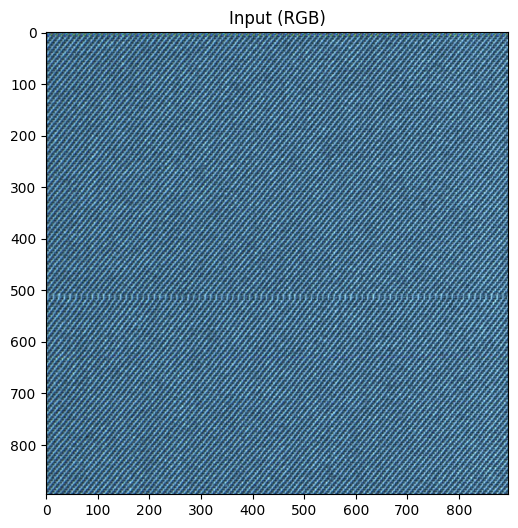

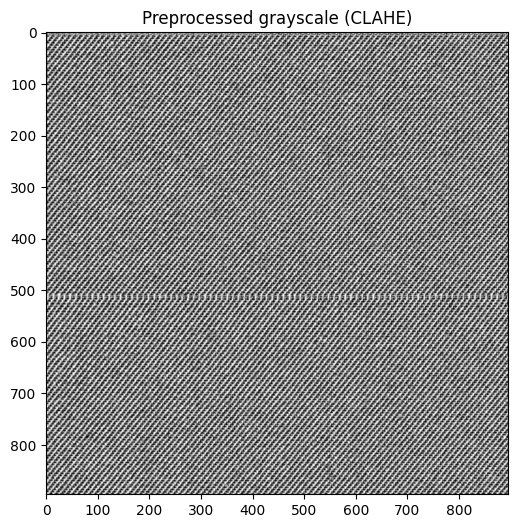

In [ ]:
img_gray, img_rgb = imread_gray(IMAGE_PATH)
img_eq = exposure.equalize_adapthist(img_gray.astype(np.uint8), clip_limit=0.02)
img = img_eq.astype(np.float32)

show(img_rgb, "Input (RGB)")
show(img, "Preprocessed grayscale (CLAHE)")

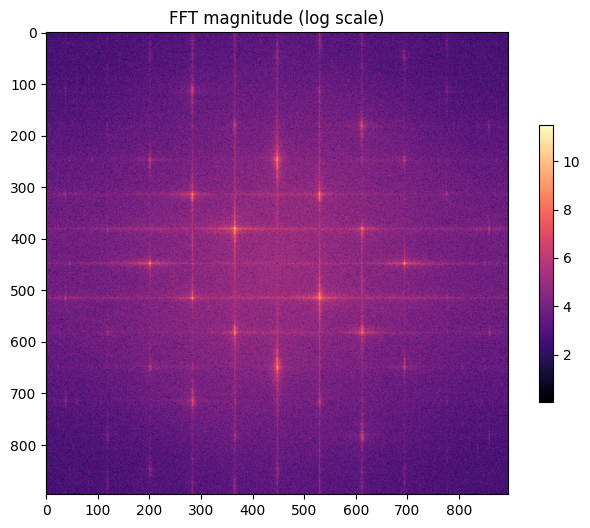

In [ ]:
F = np.fft.fft2(img - img.mean())
Fshift = np.fft.fftshift(F)
mag = np.log1p(np.abs(Fshift))

plt.figure(figsize=(8,6))
plt.title("FFT magnitude (log scale)")
plt.imshow(mag, cmap='magma')
plt.colorbar(shrink=0.6)
# plt.axis('off')
plt.show()

Selected FFT peak coords: [(np.int64(381), np.int64(366)), (np.int64(515), np.int64(530)), (np.int64(248), np.int64(448)), (np.int64(648), np.int64(448)), (np.int64(315), np.int64(530)), (np.int64(581), np.int64(366)), (np.int64(448), np.int64(695)), (np.int64(448), np.int64(201)), (np.int64(314), np.int64(284)), (np.int64(582), np.int64(612)), (np.int64(381), np.int64(612))]


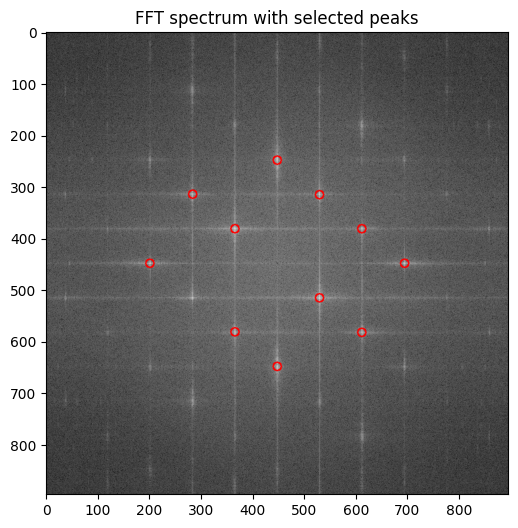

In [ ]:
h,w = img.shape
cy, cx = h//2, w//2
mag_copy = mag.copy()

# Suppress DC
y, x = np.ogrid[:h, :w]
mask_dc = (x - cx)**2 + (y - cy)**2 <= (DC_SUPPRESS_RADIUS**2)
mag_copy[mask_dc] = 0.0

# Pick top N_PEAKS
flat_idx = np.argsort(mag_copy.ravel())[::-1]
peak_coords = []
count = 0
for idx in flat_idx:
    if count >= N_PEAKS: break
    yy = idx // w; xx = idx % w
    if mag_copy[yy,xx] <= 0: continue
    if any((yy - py)**2 + (xx - px)**2 <= (PEAK_RADIUS*1.5)**2 for (py,px) in peak_coords):
        continue
    peak_coords.append((yy,xx))
    count += 1

print("Selected FFT peak coords:", peak_coords)

# Visualize peaks
spec_vis = np.stack([ (mag - mag.min())/(mag.max()-mag.min()+1e-12) ]*3, axis=-1)
for (py,px) in peak_coords:
    cv2.circle(spec_vis, (px,py), PEAK_RADIUS, (1.0,0.0,0.0), 2)
show(spec_vis, "FFT spectrum with selected peaks")

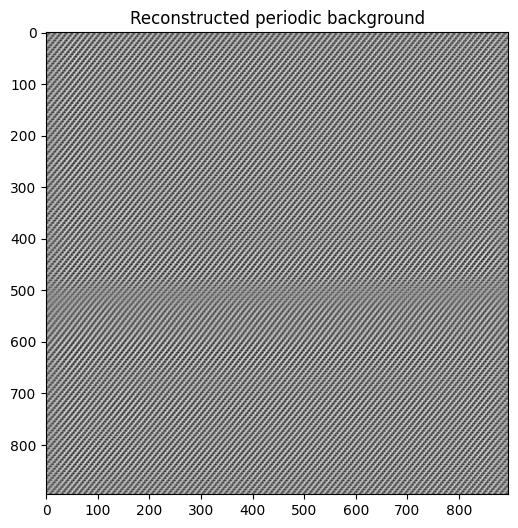

In [ ]:
mask = np.zeros_like(mag, dtype=np.uint8)
for (py,px) in peak_coords:
    yy, xx = np.ogrid[:h, :w]
    disk = (yy - py)**2 + (xx - px)**2 <= (PEAK_RADIUS**2)
    mask[disk] = 1
    symy = (h - py) % h
    symx = (w - px) % w
    disk2 = (yy - symy)**2 + (xx - symx)**2 <= (PEAK_RADIUS**2)
    mask[disk2] = 1
mask[cy-2:cy+3, cx-2:cx+3] = 1

# Reconstruct background
Fmasked = Fshift * mask
Fmasked_unshift = np.fft.ifftshift(Fmasked)
recon = np.fft.ifft2(Fmasked_unshift)
recon_norm = (np.real(recon) - np.real(recon).min())/(np.real(recon).max()-np.real(recon).min()+1e-12)

show(recon_norm, "Reconstructed periodic background")

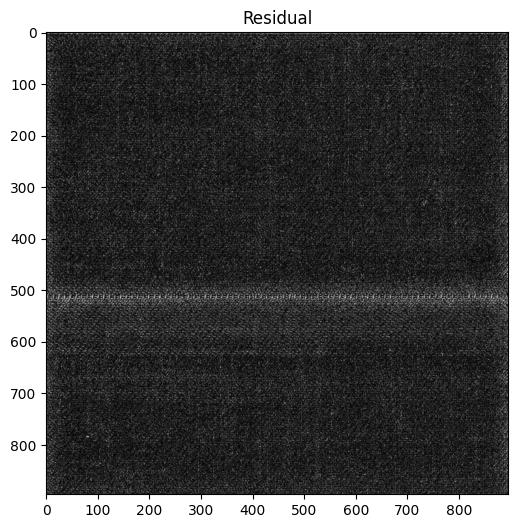

In [ ]:
orig_norm = (img - img.min())/(img.max()-img.min()+1e-12)
res = np.abs(orig_norm - recon_norm)
show(res, "Residual")



---



---



---



In [ ]:
f_path = "/content/misspick_res/getEVSImageServe (1)__jfif_x1792.jpg" #faulty
n_path = "/content/normal_res/getEVSImageServe (11)__jfif_x1792.jpg" #normal

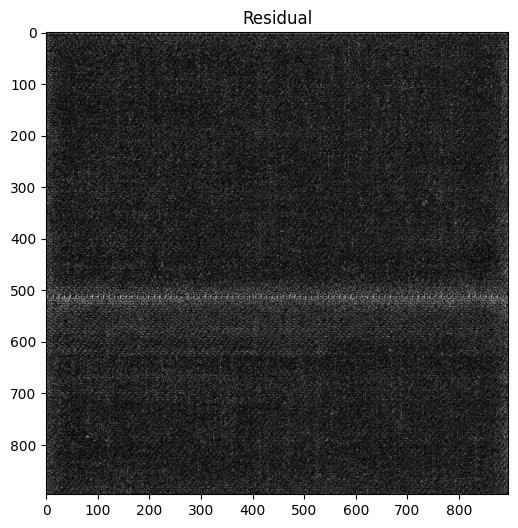

In [ ]:
f_res = read_res_float(f_path)
show(f_res, "Residual")

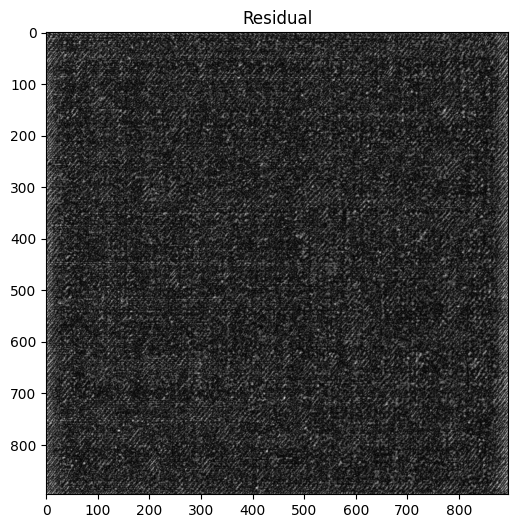

In [ ]:
n_res = read_res_float(n_path)
show(n_res, "Residual")

In [ ]:
def crop_border(arr, frac):
    if frac <= 0:
        return arr, (0,0)
    h,w = arr.shape
    dh = int(h*frac)
    dw = int(w*frac)
    if dh<=0 and dw<=0:
        return arr.copy(), (0,0)
    return arr[dh:h-dh, dw:w-dw], (dh,dw)

In [ ]:
# CROP_FRAC = 0.05
# res_crop, (dh,dw) = crop_border(res, CROP_FRAC)
# show(res_crop)

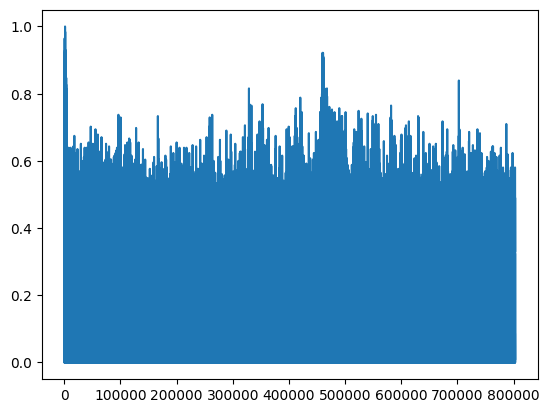

In [ ]:
f_v = f_res.ravel()
plt.plot(f_v)

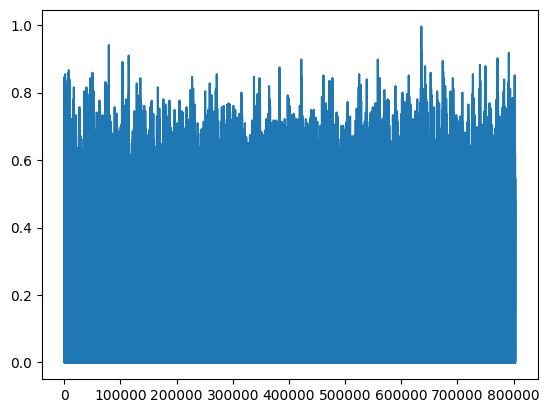

In [ ]:
n_v = n_res.ravel()
plt.plot(n_v)

In [ ]:
PCTS = np.arange(1,100,5)

def global_stats(res):
    v = res.ravel()
    return {
        "mean": float(v.mean()),
        "median": float(np.median(v)),
        "std": float(v.std()),
        "max": float(v.max()),
        "min": float(v.min()),
        "energy": float((v**2).mean()),
        **{f"p{p}":float(np.percentile(v,p)) for p in PCTS}
    }

In [ ]:
f_global_stats = global_stats(f_res)
f_global_stats

{'mean': 0.1429557502269745,
 'median': 0.12156862765550613,
 'std': 0.10973405092954636,
 'max': 1.0,
 'min': 0.0,
 'energy': 0.03247791528701782,
 'p1': 0.0,
 'p6': 0.0117647061124444,
 'p11': 0.0235294122248888,
 'p16': 0.03529411926865578,
 'p21': 0.0470588244497776,
 'p26': 0.05882352963089943,
 'p31': 0.07450980693101883,
 'p36': 0.08627451211214066,
 'p41': 0.09803921729326248,
 'p46': 0.10980392247438431,
 'p51': 0.125490203499794,
 'p56': 0.13725490868091583,
 'p61': 0.15294118225574493,
 'p66': 0.16862745583057404,
 'p71': 0.1882352977991104,
 'p76': 0.2078431397676468,
 'p81': 0.23137255012989044,
 'p86': 0.26274511218070984,
 'p91': 0.3019607961177826,
 'p96': 0.364705890417099}

In [ ]:
n_global_stats = global_stats(n_res)
n_global_stats

{'mean': 0.163266122341156,
 'median': 0.1411764770746231,
 'std': 0.12218386679887772,
 'max': 0.9960784316062927,
 'min': 0.0,
 'energy': 0.041584715247154236,
 'p1': 0.0,
 'p6': 0.01568627543747425,
 'p11': 0.027450980618596077,
 'p16': 0.04313725605607033,
 'p21': 0.054901961237192154,
 'p26': 0.07058823853731155,
 'p31': 0.08235294371843338,
 'p36': 0.09803921729326248,
 'p41': 0.11372549086809158,
 'p46': 0.12941177189350128,
 'p51': 0.14509804546833038,
 'p56': 0.16078431904315948,
 'p61': 0.1764705926179886,
 'p66': 0.19607843458652496,
 'p71': 0.21568627655506134,
 'p76': 0.239215686917305,
 'p81': 0.2666666805744171,
 'p86': 0.2980392277240753,
 'p91': 0.34117648005485535,
 'p96': 0.4156862795352936}

In [ ]:
BINS_HIST = 10

def hist_features(res, bins=BINS_HIST):
    h,_ = np.histogram(res.ravel(), bins=bins, range=(0.0,1.0), density=True)
    # name them hist_0 .. hist_{bins-1}
    return {f"hist_{i}": float(h[i]) for i in range(len(h))}

In [ ]:
f_hists = hist_features(f_res, bins=BINS_HIST)
f_hists

{'hist_0': 4.1840346355165465,
 'hist_1': 3.1712496537969934,
 'hist_2': 1.7397135522062122,
 'hist_3': 0.6353012775033866,
 'hist_4': 0.18940829413400187,
 'hist_5': 0.05393513541892287,
 'hist_6': 0.01776248243654241,
 'hist_7': 0.006390005651248831,
 'hist_8': 0.0018933361362934405,
 'hist_9': 0.0003114037841739196}

In [ ]:
n_hists = hist_features(n_res, bins=BINS_HIST)
n_hists

{'hist_0': 3.6568901918409975,
 'hist_1': 2.996141038740499,
 'hist_2': 1.9868560883051005,
 'hist_3': 0.8757798074620239,
 'hist_4': 0.33716320568322783,
 'hist_5': 0.1065000941874805,
 'hist_6': 0.0316261871713753,
 'hist_7': 0.007722813847513206,
 'hist_8': 0.0012331597203490171,
 'hist_9': 8.719305956869749e-05}

In [ ]:
from scipy.signal import find_peaks

ROW_PEAK_PROM = 0.1
ROW_PEAK_HEIGHT = 0.1
ROW_PEAK_DISTANCE = 10

def robust_row_features(res_s):
    # row projection pipeline: smooth already applied outside
    row_sum = res_s.sum(axis=1)
    # baseline removal via low-percentile per row across columns
    # Actually compute baseline as percentile across columns per row may be noisy; instead subtract global low percentile across columns
    col_low = np.percentile(res_s, 10, axis=1)  # per-row low value
    row_bgsub = row_sum - col_low  # per-row baseline subtraction (vectorized)
    row_bgsub = np.maximum(row_bgsub, 0.0)
    if row_bgsub.max() > 0:
        row_norm = row_bgsub / (np.percentile(row_bgsub, 99) + 1e-12)
    else:
        row_norm = row_bgsub
    # peaks
    peaks, props = find_peaks(row_norm, height=ROW_PEAK_HEIGHT, prominence=ROW_PEAK_PROM, distance=ROW_PEAK_DISTANCE)
    peak_heights = props.get("peak_heights", np.array([]))
    f = {
        "row_sum_max": float(row_sum.max()),
        "row_sum_p99": float(np.percentile(row_sum, 99)),
        "row_peak_count": int(len(peaks)),
        "row_peak_max_height": float(peak_heights.max() if len(peak_heights)>0 else 0.0),
    }
    return f

In [ ]:
f_row_feats = robust_row_features(f_res)
f_row_feats

{'row_sum_max': 370.64312744140625,
 'row_sum_p99': 283.69647216796875,
 'row_peak_count': 46,
 'row_peak_max_height': 1.3064662218093872}

In [ ]:
n_row_feats = robust_row_features(n_res)
n_row_feats

{'row_sum_max': 271.54119873046875,
 'row_sum_p99': 196.26309204101562,
 'row_peak_count': 49,
 'row_peak_max_height': 1.043145775794983}

In [ ]:
MATCHED_FILTER_LENGTHS = [64, 128, 256]
MF_THRESHRATIO = 0.5

def matched_filter_features(res_s, lengths=MATCHED_FILTER_LENGTHS, thr_ratio=MF_THRESHRATIO):
    H,W = res_s.shape
    agg = np.zeros_like(res_s, dtype=np.float32)
    mf_maxes = {}
    for L in lengths:
        Lc = min(int(L), W)
        kernel = np.ones((1, Lc), dtype=np.float32)/Lc
        # use filter2D on floats scaled up to avoid small values
        resp = cv2.filter2D((res_s*255).astype(np.float32), -1, kernel)/255.0
        if resp.max()>0:
            rnorm = (resp - resp.min())/(resp.max()-resp.min()+1e-12)
        else:
            rnorm = resp
        agg = np.maximum(agg, rnorm)
        mf_maxes[f"mf_max_L{Lc}"] = float(rnorm.max())
    mf_maxes["mf_agg_max"] = float(agg.max())
    # area above threshold of agg
    thr = mf_maxes["mf_agg_max"] * thr_ratio
    mask = agg >= thr
    mf_stats = {
        "mf_mask_area": int(mask.sum()),
        "mf_mask_frac": float(mask.sum()/(H*W))
    }
    mf_maxes.update(mf_stats)
    return mf_maxes

In [ ]:
f_mf_feats = matched_filter_features(f_res)
f_mf_feats

{'mf_max_L64': 1.0,
 'mf_max_L128': 1.0,
 'mf_max_L256': 1.0,
 'mf_agg_max': 1.0,
 'mf_mask_area': 15310,
 'mf_mask_frac': 0.019070372289540817}

In [ ]:
n_mf_feats = matched_filter_features(n_res)
n_mf_feats

{'mf_max_L64': 1.0,
 'mf_max_L128': 1.0,
 'mf_max_L256': 1.0,
 'mf_agg_max': 1.0,
 'mf_mask_area': 58961,
 'mf_mask_frac': 0.07344273158482142}



---



---



---



In [ ]:
faulty_list = get_images("/content/misspick_res", recursive=True)
normal_list = get_images("/content/normal_res", recursive=True)

In [ ]:
faulty_list = faulty_list[:100]
normal_list = normal_list[:100]

In [ ]:
# === Build classifier from two lists of residuals (normal vs faulty) ===
# Usage:
# 1) Create plain text files with one path per line:
#      normal_list.txt
#      faulty_list.txt
#    OR define Python lists `normal_list` and `faulty_list` before running this cell.
#
# 2) Run this cell. Outputs:
#    - features_with_labels.csv
#    - predictions.csv  (cross-validated probabilities and labels)
#    - rf_model.joblib  (final model trained on all data)
#
# NOTE: This assumes each residual file is grayscale float (0..1) or uint8; paths must be valid.

import os, sys
from pathlib import Path
import cv2
import numpy as np
import pandas as pd
from tqdm import tqdm
from scipy import ndimage as ndi
from scipy.signal import find_peaks
from skimage import measure, morphology
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import StratifiedKFold, cross_val_predict
from sklearn.metrics import roc_auc_score, average_precision_score, classification_report, confusion_matrix
import joblib

# ----------------- CONFIG -----------------
# If you have text files listing paths (one per line) set these filenames (or leave as None)
NORMAL_LIST_FILE = "None"
FAULTY_LIST_FILE = "None"

# OR define Python lists BEFORE running this cell:
# normal_list = ["center_residuals/imgA.png", ...]
# faulty_list = ["center_residuals/imgB.png", ...]

OUT_FEATURES = "features_with_labels.csv"
OUT_PRED = "predictions.csv"
OUT_MODEL = "rf_model.joblib"

# Feature extraction params
CROP_FRAC = 0.02
SMOOTH_SIGMA = 2.5
PCTS = np.arange(1,100,5)
# PCTS = [50,75,90,95,97,99]
MATCHED_FILTER_LENGTHS = [64, 128, 256]
MF_THRESHRATIO = 0.5
BLOB_PCTS = [95, 97, 99]
HIST_BINS = 10
ROW_PEAK_HEIGHT = 0.05
ROW_PEAK_PROM = 0.02
ROW_PEAK_DISTANCE = 8

# RF params
RF_N_ESTIMATORS = 200
RF_MAX_DEPTH = 12
CV_SPLITS = 5
RANDOM_STATE = 0
# ------------------------------------------

# ---------- helpers & feature functions ----------
def read_residual_float(p):
    im = cv2.imread(str(p), cv2.IMREAD_UNCHANGED)
    if im is None:
        return None
    if im.ndim == 3:
        im = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    arr = im.astype(np.float32)
    if arr.max() > 1.0:
        arr /= 255.0
    return arr

def crop_and_smooth(res, frac=CROP_FRAC, sigma=SMOOTH_SIGMA):
    if frac and frac > 0:
        h,w = res.shape
        dh = int(h*frac); dw = int(w*frac)
        if dh >= h//2 or dw >= w//2:
            res_crop = res.copy()
            dh = dw = 0
        else:
            res_crop = res[dh:h-dh, dw:w-dw]
    else:
        res_crop = res.copy(); dh = dw = 0
    if sigma and sigma > 0:
        res_s = ndi.gaussian_filter(res_crop, sigma=sigma)
    else:
        res_s = res_crop.copy()
    return res_s, (dh, dw)

def global_stats(res_s, pcts=PCTS, bins=HIST_BINS):
    v = res_s.ravel()
    stats = {
        "mean": float(v.mean()),
        "median": float(np.median(v)),
        "std": float(v.std()),
        "max": float(v.max()),
        "min": float(v.min()),
        "energy": float((v**2).mean())
    }
    for p in pcts:
        stats[f"p{p}"] = float(np.percentile(v, p))
    h,_ = np.histogram(v, bins=bins, range=(0.0,1.0), density=True)
    for i,val in enumerate(h):
        stats[f"hist_{i}"] = float(val)
    return stats

def row_features(res_s):
    row_sum = res_s.sum(axis=1)
    # robust baseline removal: subtract low-percentile across columns per row (vector)
    per_row_low = np.percentile(res_s, 10, axis=1)
    row_bgsub = row_sum - per_row_low
    row_bgsub = np.maximum(row_bgsub, 0.0)
    scale = np.percentile(row_bgsub, 99) if row_bgsub.max()>0 else 1.0
    row_norm = row_bgsub / (scale + 1e-12)
    peaks, props = find_peaks(row_norm, height=ROW_PEAK_HEIGHT, prominence=ROW_PEAK_PROM, distance=ROW_PEAK_DISTANCE)
    peak_heights = props.get("peak_heights", np.array([]))
    return {
        "row_sum_max": float(row_sum.max()),
        "row_p99": float(np.percentile(row_sum, 99)),
        "row_peak_count": int(len(peaks)),
        "row_peak_max_height": float(peak_heights.max() if len(peak_heights)>0 else 0.0)
    }

def matched_filter_feats(res_s, lengths=MATCHED_FILTER_LENGTHS, thr_ratio=MF_THRESHRATIO):
    H,W = res_s.shape
    agg = np.zeros_like(res_s, dtype=np.float32)
    feats = {}
    for L in lengths:
        Lc = min(int(L), W)
        kernel = np.ones((1, Lc), dtype=np.float32)/Lc
        resp = cv2.filter2D((res_s*255).astype(np.float32), -1, kernel)/255.0
        if resp.max() > 0:
            rnorm = (resp - resp.min())/(resp.max()-resp.min()+1e-12)
        else:
            rnorm = resp
        agg = np.maximum(agg, rnorm)
        feats[f"mf_max_L{Lc}"] = float(rnorm.max())
    feats["mf_agg_max"] = float(agg.max())
    thr = feats["mf_agg_max"] * thr_ratio
    mask = agg >= thr
    feats["mf_mask_area"] = int(mask.sum())
    feats["mf_mask_frac"] = float(mask.sum()/(H*W))
    return feats

def blob_feats(res_s, pcts=BLOB_PCTS):
    feats = {}
    for p in pcts:
        thr = np.percentile(res_s, p)
        mask = res_s > thr
        mask = morphology.remove_small_objects(mask, min_size=8)
        label = measure.label(mask)
        props = measure.regionprops(label)
        areas = [pr.area for pr in props]
        feats[f"n_blobs_p{p}"] = int(len(areas))
        feats[f"largest_blob_p{p}"] = int(max(areas) if areas else 0)
        feats[f"total_blob_area_p{p}"] = int(sum(areas))
    return feats

def fft_feats(res_s):
    F = np.fft.fft2(res_s - res_s.mean())
    Fsh = np.fft.fftshift(F)
    mag = np.abs(Fsh)
    h,w = mag.shape
    cy,cx = h//2, w//2
    mag[cy-2:cy+3, cx-2:cx+3] = 0.0
    return {"fft_logsum": float(np.log1p(mag).sum()), "fft_band_energy": float(mag.sum())}

def extract_features_for_path(p):
    res = read_residual_float(p)
    if res is None:
        return None
    res_s, (dh,dw) = crop_and_smooth(res, frac=CROP_FRAC, sigma=SMOOTH_SIGMA)
    feats = {"filename": str(p)}
    feats.update(global_stats(res_s))
    feats.update(row_features(res_s))
    feats.update(matched_filter_feats(res_s))
    feats.update(blob_feats(res_s))
    feats.update(fft_feats(res_s))
    return feats

# ----------------- load lists -----------------
def load_list_from_file(fname):
    p = Path(fname)
    if not p.exists():
        return None
    lines = [l.strip() for l in p.read_text().splitlines() if l.strip()]
    return lines

normal_paths = None
faulty_paths = None

# try text files first
if Path(NORMAL_LIST_FILE).exists() and Path(FAULTY_LIST_FILE).exists():
    normal_paths = load_list_from_file(NORMAL_LIST_FILE)
    faulty_paths = load_list_from_file(FAULTY_LIST_FILE)
else:
    # try Python lists (user may have defined them earlier)
    if 'normal_list' in globals() and 'faulty_list' in globals():
        normal_paths = globals()['normal_list']
        faulty_paths = globals()['faulty_list']

if normal_paths is None or faulty_paths is None:
    raise RuntimeError(
        "No lists provided. Provide two text files 'normal_list.txt' and 'faulty_list.txt' "
        "or define Python lists 'normal_list' and 'faulty_list' before running this cell."
    )

# normalize to Path objects and verify
normal_paths = [Path(p) for p in normal_paths]
faulty_paths = [Path(p) for p in faulty_paths]

all_paths = []
labels = []
for p in normal_paths:
    if not p.exists():
        print("WARN: normal path not found:", p)
    else:
        all_paths.append(p); labels.append(0)
for p in faulty_paths:
    if not p.exists():
        print("WARN: faulty path not found:", p)
    else:
        all_paths.append(p); labels.append(1)

if len(all_paths) == 0:
    raise RuntimeError("No valid residual files found in the supplied lists.")

# ---------- extract features ----------
rows = []
failed = []
for p in tqdm(all_paths, desc="extracting features"):
    feats = extract_features_for_path(p)
    if feats is None:
        failed.append(str(p))
    else:
        rows.append(feats)

if failed:
    print("Some files failed to read:", failed[:10])

df = pd.DataFrame(rows).set_index("filename")
# align labels
df['label'] = [labels[i] for i,p in enumerate(all_paths) if str(p) in df.index]

# save features
df.to_csv(OUT_FEATURES)
print("Saved features to", OUT_FEATURES)

# ----------------- train & CV evaluate -----------------
X = df.drop(columns=['label']).fillna(0)
y = df['label'].values.astype(int)

clf = RandomForestClassifier(n_estimators=RF_N_ESTIMATORS, max_depth=RF_MAX_DEPTH, random_state=RANDOM_STATE, n_jobs=-1)
skf = StratifiedKFold(n_splits=CV_SPLITS, shuffle=True, random_state=RANDOM_STATE)

cross-validated predicted probabilities (positive class)
y_proba_cv = cross_val_predict(clf, X, y, cv=skf, method='predict_proba', n_jobs=-1)[:,1]
y_pred_cv = (y_proba_cv >= 0.5).astype(int)

roc = roc_auc_score(y, y_proba_cv)
ap = average_precision_score(y, y_proba_cv)
print(f"Cross-validated ROC AUC: {roc:.4f}")
print(f"Cross-validated Average Precision (AP): {ap:.4f}")

print("\nClassification report (CV preds):")
print(classification_report(y, y_pred_cv, digits=4))
print("Confusion matrix:")
print(confusion_matrix(y, y_pred_cv))

# save predictions CSV
pred_df = pd.DataFrame({
    "filename": X.index,
    "label": y,
    "proba_cv": y_proba_cv,
    "pred_cv": y_pred_cv
}).set_index("filename")
pred_df.to_csv(OUT_PRED)
print("Saved predictions (CV) to", OUT_PRED)

# fit final model on all data and save
clf.fit(X, y)
joblib.dump(clf, OUT_MODEL)
print("Saved RandomForest model to", OUT_MODEL)

# print top feature importances
importances = pd.Series(clf.feature_importances_, index=X.columns).sort_values(ascending=False)
print("\nTop 20 feature importances:")
print(importances.head(20))

# done
print("Done. Inspect features CSV, predictions CSV, and the trained model file.")

Cross-validated ROC AUC: 0.8575
Cross-validated Average Precision (AP): 0.8963

Classification report (CV preds):
              precision    recall  f1-score   support

           0     0.7521    0.8800    0.8111       100
           1     0.8554    0.7100    0.7760       100

    accuracy                         0.7950       200
   macro avg     0.8038    0.7950    0.7935       200
weighted avg     0.8038    0.7950    0.7935       200

Confusion matrix:
[[88 12]
 [29 71]]
Saved predictions (CV) to predictions.csv
Saved RandomForest model to rf_model.joblib

Top 20 feature importances:
largest_blob_p95       0.084906
n_blobs_p97            0.070007
total_blob_area_p99    0.062331
row_sum_max            0.055871
n_blobs_p99            0.052913
row_p99                0.050317
largest_blob_p97       0.046944
hist_3                 0.040517
max                    0.040298
total_blob_area_p97    0.037952
largest_blob_p99       0.033661
n_blobs_p95            0.032727
row_peak_count         

In [ ]:
pred_df

,label,proba_cv,pred_cv
filename,,,
/content/normal_res/getEVSImageServe (100)__jpg_x2688.jpg,0,0.1650,0
/content/normal_res/getEVSImageServe (100)__jpg_x3584.jpg,0,0.2075,0
/content/normal_res/getEVSImageServe (100)__jpg_x4480.jpg,0,0.4050,0
/content/normal_res/getEVSImageServe (100)__jpg_x5376.jpg,0,0.2650,0
/content/normal_res/getEVSImageServe (100)__jpg_x6080.jpg,0,0.2750,0
...,...,...,...
/content/misspick_res/getEVSImageServe (16)__jpg_x2688.jpg,1,0.9900,1
/content/misspick_res/getEVSImageServe (16)__jpg_x3584.jpg,1,0.9950,1
/content/misspick_res/getEVSImageServe (16)__jpg_x4480.jpg,1,1.0000,1


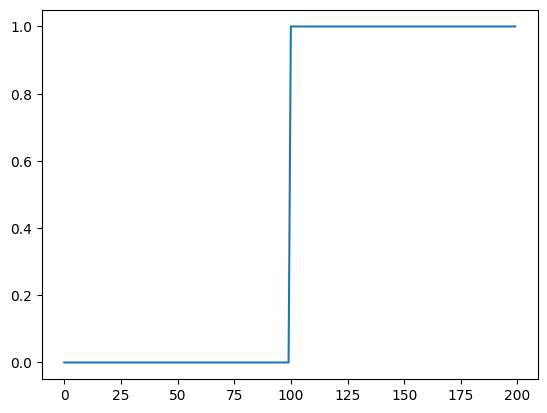

In [ ]:
plt.plot(pred_df['label'].to_numpy())

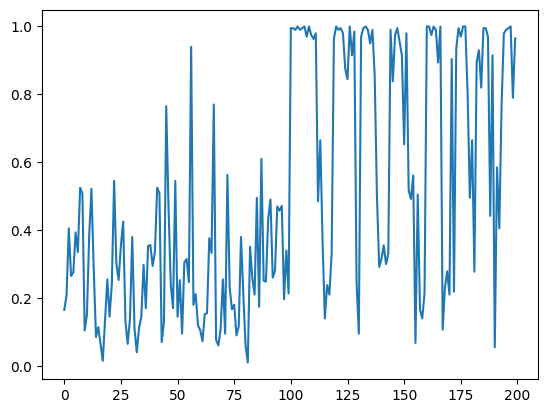

In [ ]:
plt.plot(pred_df['proba_cv'].to_numpy())



---



---



---



In [ ]:
# test on few images
normal_tiles = get_images("/content/tiles_896/normal", recursive=True)
faulty_tiles = get_images("/content/tiles_896/Faults/miss pick", recursive=True)

In [ ]:
# test new my_func
NORMAL_TILE = normal_tiles[0]
FAULTY_TILE = faulty_tiles[0]

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import exposure

In [ ]:
bgr_n = cv2.imread(NORMAL_TILE)
bgr_f = cv2.imread(FAULTY_TILE)

gray_n = cv2.cvtColor(bgr_n, cv2.COLOR_BGR2GRAY).astype(np.float32)
gray_f = cv2.cvtColor(bgr_f, cv2.COLOR_BGR2GRAY).astype(np.float32)

print(f"Normal tile shape : {gray_n.shape}, range: [{gray_n.min():.0f}, {gray_n.max():.0f}]")
print(f"Faulty tile shape : {gray_f.shape}, range: [{gray_f.min():.0f}, {gray_f.max():.0f}]")

Normal tile shape : (896, 896), range: [17, 236]
Faulty tile shape : (896, 896), range: [21, 238]


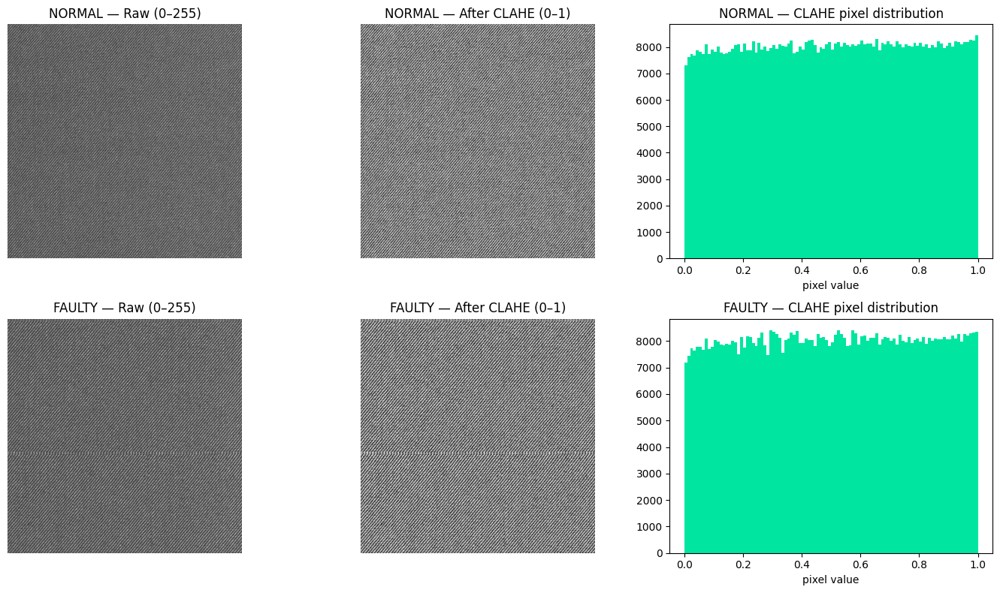


NORMAL after CLAHE: mean=0.5039  std=0.2880
FAULTY after CLAHE: mean=0.5038  std=0.2877


In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL A — Stage 1: Raw input vs after CLAHE
# What CLAHE does: boosts LOCAL contrast in dark/bright regions.
# Doesn't change the global structure, just makes weave more visible.
# Expected: values go from 0-255 → 0-1, distribution more uniform.
# ════════════════════════════════════════════════════════════════

def apply_clahe(gray):
    img_norm = gray / 255.0
    return exposure.equalize_adapthist(img_norm, clip_limit=0.02).astype(np.float32)

img_n = apply_clahe(gray_n)
img_f = apply_clahe(gray_f)

fig, axes = plt.subplots(2, 3, figsize=(14, 8))

for row, (raw, clahe, title) in enumerate([
    (gray_n, img_n, "NORMAL"),
    (gray_f, img_f, "FAULTY"),
]):
    axes[row, 0].imshow(raw,   cmap="gray", vmin=0,   vmax=255)
    axes[row, 0].set_title(f"{title} — Raw (0–255)")

    axes[row, 1].imshow(clahe, cmap="gray", vmin=0,   vmax=1)
    axes[row, 1].set_title(f"{title} — After CLAHE (0–1)")

    axes[row, 2].hist(clahe.ravel(), bins=100, color="#00e5a0", edgecolor="none")
    axes[row, 2].set_title(f"{title} — CLAHE pixel distribution")
    axes[row, 2].set_xlabel("pixel value")

for ax in axes.ravel():
    ax.axis("off") if ax.get_images() else None
plt.tight_layout()
plt.show()

print(f"\nNORMAL after CLAHE: mean={img_n.mean():.4f}  std={img_n.std():.4f}")
print(f"FAULTY after CLAHE: mean={img_f.mean():.4f}  std={img_f.std():.4f}")

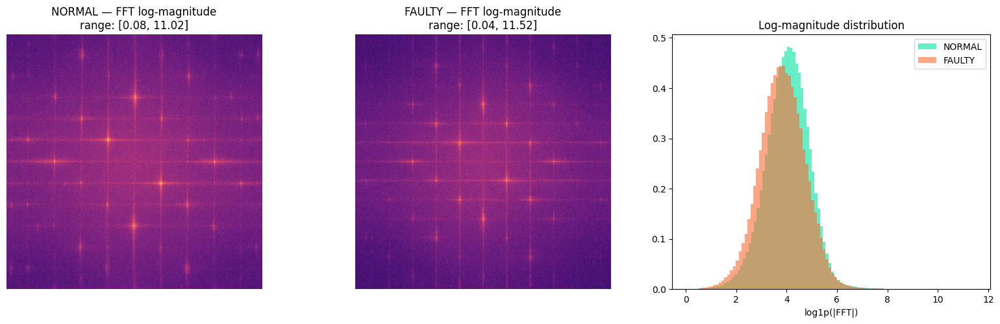


NORMAL FFT mag: mean=4.038  max=11.016
FAULTY FFT mag: mean=3.834  max=11.518


In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL B — Stage 2: The FFT magnitude spectrum
#
# What you're looking at:
#   - Center = DC (low frequency / overall brightness) — suppressed
#   - Bright spots away from center = repeating patterns (weave)
#   - A regular weave → clean, symmetric bright spots
#   - A faulty tile → same spots (weave still there) + possibly
#     some smearing or extra energy near the spots
#
# We show log1p(|FFT|) because raw magnitudes span 0 → ~100,000.
# Without log, everything looks dark except DC.
#
# Expected range of log magnitude: roughly 0–12 for 896×896 tiles.
# ════════════════════════════════════════════════════════════════

def compute_fft_mag(img):
    F      = np.fft.fft2(img - img.mean())
    Fshift = np.fft.fftshift(F)
    mag    = np.log1p(np.abs(Fshift))
    return F, Fshift, mag

F_n, Fshift_n, mag_n = compute_fft_mag(img_n)
F_f, Fshift_f, mag_f = compute_fft_mag(img_f)

fig, axes = plt.subplots(1, 3, figsize=(16, 5))

axes[0].imshow(mag_n, cmap="magma")
axes[0].set_title(f"NORMAL — FFT log-magnitude\nrange: [{mag_n.min():.2f}, {mag_n.max():.2f}]")

axes[1].imshow(mag_f, cmap="magma")
axes[1].set_title(f"FAULTY — FFT log-magnitude\nrange: [{mag_f.min():.2f}, {mag_f.max():.2f}]")

axes[2].hist(mag_n.ravel(), bins=100, alpha=0.6, color="#00e5a0", label="NORMAL",  density=True)
axes[2].hist(mag_f.ravel(), bins=100, alpha=0.6, color="#ff6b35", label="FAULTY",  density=True)
axes[2].set_title("Log-magnitude distribution")
axes[2].set_xlabel("log1p(|FFT|)")
axes[2].legend()

for ax in axes[:2]:
    ax.axis("off")
plt.tight_layout()
plt.show()

# KEY THING TO LOOK FOR: are the bright peaks sharper/different
# in faulty vs normal? Any extra energy between peaks?
print(f"\nNORMAL FFT mag: mean={mag_n.mean():.3f}  max={mag_n.max():.3f}")
print(f"FAULTY FFT mag: mean={mag_f.mean():.3f}  max={mag_f.max():.3f}")

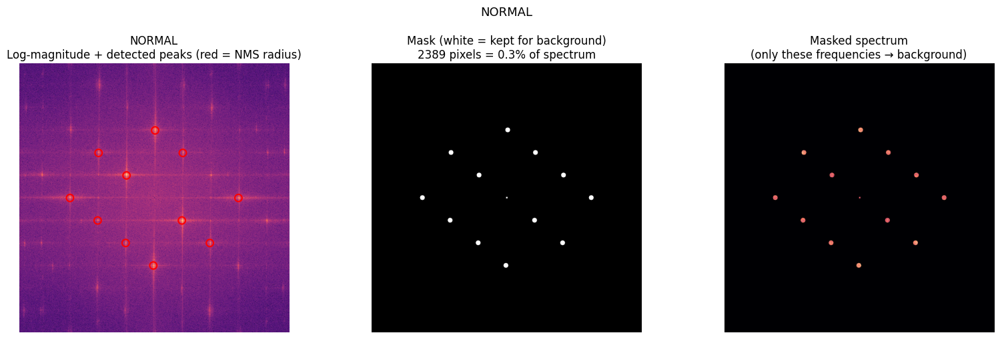


NORMAL: 11 peaks found
Peak coordinates (y, x): [(np.int64(373), np.int64(356)), (np.int64(523), np.int64(540)), (np.int64(448), np.int64(168)), (np.int64(448), np.int64(728)), (np.int64(598), np.int64(353)), (np.int64(298), np.int64(543)), (np.int64(673), np.int64(445)), (np.int64(223), np.int64(451)), (np.int64(298), np.int64(263)), (np.int64(598), np.int64(633)), (np.int64(523), np.int64(260))]


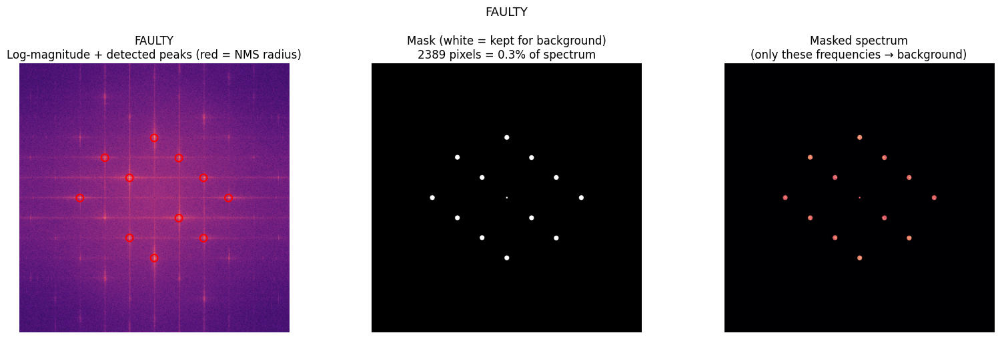


FAULTY: 11 peaks found
Peak coordinates (y, x): [(np.int64(381), np.int64(366)), (np.int64(515), np.int64(530)), (np.int64(248), np.int64(448)), (np.int64(648), np.int64(448)), (np.int64(315), np.int64(530)), (np.int64(581), np.int64(366)), (np.int64(448), np.int64(695)), (np.int64(448), np.int64(201)), (np.int64(314), np.int64(284)), (np.int64(582), np.int64(612)), (np.int64(381), np.int64(612))]


In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL C — Stage 3: Peak picking + mask
#
# What you're looking at:
#   - Red circles = the N_PEAKS frequency peaks that were detected
#   - White overlay = the mask region (what gets KEPT for background)
#   - Everything outside the mask = what becomes the residual
#
# Key questions to answer visually:
#   1. Are the peaks landing on the weave frequencies? (they should)
#   2. Is N_PEAKS=11 too few or too many? (if it's picking noise → too many)
#   3. PEAK_RADIUS too small? → background leaks into residual
#      PEAK_RADIUS too large? → fault signal gets absorbed into background
# ════════════════════════════════════════════════════════════════

N_PEAKS         = 11
PEAK_RADIUS     = 8
DC_SUPPRESS_RADIUS = 3

def pick_peaks_and_mask(mag, h, w, n_peaks, peak_radius, dc_radius):
    cy, cx   = h // 2, w // 2
    mag_copy = mag.copy()

    y, x = np.ogrid[:h, :w]
    mag_copy[(x - cx)**2 + (y - cy)**2 <= dc_radius**2] = 0.0

    flat_idx    = np.argsort(mag_copy.ravel())[::-1]
    peak_coords = []
    for idx in flat_idx:
        if len(peak_coords) >= n_peaks:
            break
        yy, xx = idx // w, idx % w
        if mag_copy[yy, xx] <= 0:
            continue
        if any((yy - py)**2 + (xx - px)**2 <= (peak_radius * 1.5)**2
               for (py, px) in peak_coords):
            continue
        peak_coords.append((yy, xx))

    mask = np.zeros((h, w), dtype=np.uint8)
    for (py, px) in peak_coords:
        yy, xx = np.ogrid[:h, :w]
        disk  = (yy - py)**2 + (xx - px)**2 <= peak_radius**2
        mask[disk] = 1
        symy, symx = (h - py) % h, (w - px) % w
        disk2 = (yy - symy)**2 + (xx - symx)**2 <= peak_radius**2
        mask[disk2] = 1
    mask[cy-2:cy+3, cx-2:cx+3] = 1

    return peak_coords, mask

h, w = img_n.shape
peak_coords_n, mask_n = pick_peaks_and_mask(mag_n, h, w, N_PEAKS, PEAK_RADIUS, DC_SUPPRESS_RADIUS)
peak_coords_f, mask_f = pick_peaks_and_mask(mag_f, h, w, N_PEAKS, PEAK_RADIUS, DC_SUPPRESS_RADIUS)

def overlay_peaks(mag, peak_coords, mask, title):
    fig, axes = plt.subplots(1, 3, figsize=(16, 5))

    # Raw spectrum with peak locations
    axes[0].imshow(mag, cmap="magma")
    for (py, px) in peak_coords:
        circle = plt.Circle((px, py), PEAK_RADIUS * 1.5, color="red", fill=False, linewidth=1.5)
        axes[0].add_patch(circle)
    axes[0].set_title(f"{title}\nLog-magnitude + detected peaks (red = NMS radius)")
    axes[0].axis("off")

    # The mask
    axes[1].imshow(mask, cmap="gray")
    axes[1].set_title(f"Mask (white = kept for background)\n{mask.sum()} pixels = {mask.mean()*100:.1f}% of spectrum")
    axes[1].axis("off")

    # Masked spectrum — what background reconstruction uses
    axes[2].imshow(np.log1p(np.abs(np.fft.ifftshift(np.fft.fftshift(np.fft.fft2(img_n - img_n.mean()))) * mask)),
                   cmap="magma")
    axes[2].set_title("Masked spectrum\n(only these frequencies → background)")
    axes[2].axis("off")

    plt.suptitle(title, fontsize=13, y=1.01)
    plt.tight_layout()
    plt.show()

    print(f"\n{title}: {len(peak_coords)} peaks found")
    print(f"Peak coordinates (y, x): {peak_coords}")

overlay_peaks(mag_n, peak_coords_n, mask_n, "NORMAL")
overlay_peaks(mag_f, peak_coords_f, mask_f, "FAULTY")

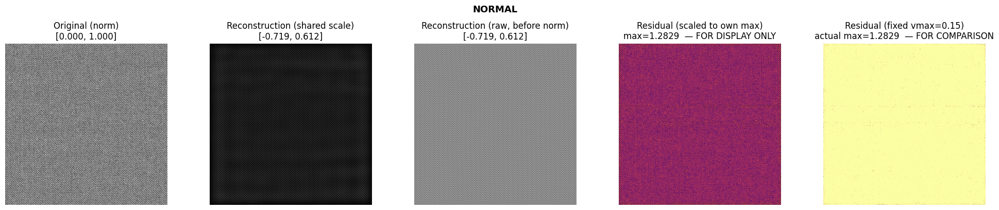


NORMAL residual stats (raw):
  mean=0.50399  std=0.13764  max=1.28288  p95=0.72624


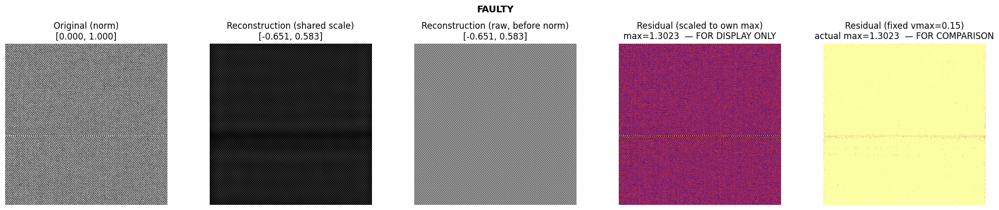


FAULTY residual stats (raw):
  mean=0.50394  std=0.12830  max=1.30226  p95=0.70857


In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL D — Stage 4: Background reconstruction quality check
#
# This is the most important diagnostic cell.
# You should see:
#   - recon ≈ original for NORMAL tiles (weave pattern visible)
#   - recon ≈ original background for FAULTY tiles (fault NOT visible)
#
# If recon looks totally wrong → N_PEAKS or PEAK_RADIUS needs tuning
# ════════════════════════════════════════════════════════════════

def reconstruct_bg(Fshift, mask, img):
    Fmasked      = Fshift * mask
    recon_raw    = np.real(np.fft.ifft2(np.fft.ifftshift(Fmasked))).astype(np.float32)

    orig_min, orig_max = img.min(), img.max()
    denom = orig_max - orig_min + 1e-12

    orig_norm  = (img       - orig_min) / denom
    recon_norm = (recon_raw - orig_min) / denom   # shared scale
    residual   = np.abs(orig_norm - recon_norm)

    return orig_norm, recon_norm, recon_raw, residual

orig_n, recon_n, recon_raw_n, res_n = reconstruct_bg(Fshift_n, mask_n, img_n)
orig_f, recon_f, recon_raw_f, res_f = reconstruct_bg(Fshift_f, mask_f, img_f)

for label, orig, recon, recon_raw, res in [
    ("NORMAL", orig_n, recon_n, recon_raw_n, res_n),
    ("FAULTY", orig_f, recon_f, recon_raw_f, res_f),
]:
    fig, axes = plt.subplots(1, 5, figsize=(20, 4))

    axes[0].imshow(orig,     cmap="gray", vmin=0, vmax=1)
    axes[0].set_title(f"Original (norm)\n[{orig.min():.3f}, {orig.max():.3f}]")

    axes[1].imshow(recon,    cmap="gray", vmin=0, vmax=1)
    axes[1].set_title(f"Reconstruction (shared scale)\n[{recon.min():.3f}, {recon.max():.3f}]")

    axes[2].imshow(recon_raw, cmap="gray")
    axes[2].set_title(f"Reconstruction (raw, before norm)\n[{recon_raw.min():.3f}, {recon_raw.max():.3f}]")

    # Residual at full dynamic range (per-tile scaled — OLD approach style, for visibility)
    axes[3].imshow(res, cmap="inferno", vmin=0, vmax=res.max())
    axes[3].set_title(f"Residual (scaled to own max)\nmax={res.max():.4f}  — FOR DISPLAY ONLY")

    # Residual at FIXED scale (GLOBAL — correct approach)
    VMAX = 0.15  # adjust if needed
    axes[4].imshow(res, cmap="inferno", vmin=0, vmax=VMAX)
    axes[4].set_title(f"Residual (fixed vmax={VMAX})\nactual max={res.max():.4f}  — FOR COMPARISON")

    for ax in axes:
        ax.axis("off")
    plt.suptitle(label, fontsize=13, fontweight="bold", y=1.01)
    plt.tight_layout()
    plt.show()

    print(f"\n{label} residual stats (raw):")
    print(f"  mean={res.mean():.5f}  std={res.std():.5f}  max={res.max():.5f}  p95={np.percentile(res, 95):.5f}")


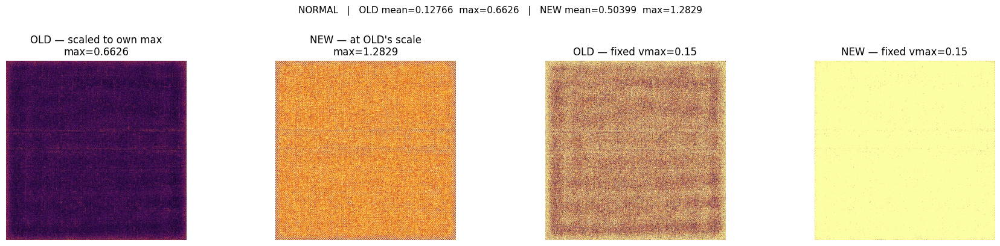

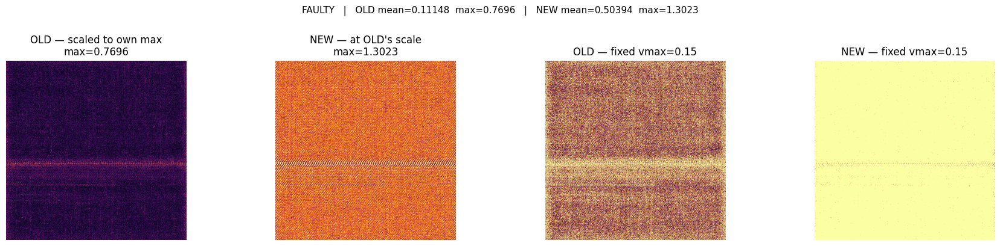

In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL E — The contrast paradox: old vs new normalisation
#
# This directly shows WHY the old version had higher contrast,
# and whether that contrast was "real" or artificial.
#
# Plots 4 versions of the residual for both tiles so you can
# decide which is most useful for YOUR downstream task.
# ════════════════════════════════════════════════════════════════

def residual_old_style(Fshift, mask, img):
    """Original my_func: both independently min-max normalised."""
    Fmasked   = Fshift * mask
    recon_raw = np.real(np.fft.ifft2(np.fft.ifftshift(Fmasked))).astype(np.float32)
    orig_norm  = (img       - img.min())       / (img.max()       - img.min()       + 1e-12)
    recon_norm = (recon_raw - recon_raw.min()) / (recon_raw.max() - recon_raw.min() + 1e-12)
    return np.abs(orig_norm - recon_norm)

def residual_new_style(Fshift, mask, img):
    """Fixed: shared normalisation by original's range."""
    Fmasked   = Fshift * mask
    recon_raw = np.real(np.fft.ifft2(np.fft.ifftshift(Fmasked))).astype(np.float32)
    denom     = img.max() - img.min() + 1e-12
    orig_norm  = (img       - img.min()) / denom
    recon_norm = (recon_raw - img.min()) / denom
    return np.abs(orig_norm - recon_norm)

for label, Fshift, mask, img in [
    ("NORMAL", Fshift_n, mask_n, img_n),
    ("FAULTY", Fshift_f, mask_f, img_f),
]:
    old = residual_old_style(Fshift, mask, img)
    new = residual_new_style(Fshift, mask, img)

    fig, axes = plt.subplots(1, 4, figsize=(18, 4))
    VMAX_OLD = max(old.max(), 0.01)
    VMAX_NEW = 0.15  # fixed global for honest comparison

    axes[0].imshow(old, cmap="inferno", vmin=0, vmax=VMAX_OLD)
    axes[0].set_title(f"OLD — scaled to own max\nmax={old.max():.4f}")

    axes[1].imshow(new, cmap="inferno", vmin=0, vmax=VMAX_OLD)
    axes[1].set_title(f"NEW — at OLD's scale\nmax={new.max():.4f}")

    axes[2].imshow(old, cmap="inferno", vmin=0, vmax=VMAX_NEW)
    axes[2].set_title(f"OLD — fixed vmax={VMAX_NEW}")

    axes[3].imshow(new, cmap="inferno", vmin=0, vmax=VMAX_NEW)
    axes[3].set_title(f"NEW — fixed vmax={VMAX_NEW}")

    for ax in axes:
        ax.axis("off")
    plt.suptitle(
        f"{label}   |   OLD mean={old.mean():.5f}  max={old.max():.4f}   |   "
        f"NEW mean={new.mean():.5f}  max={new.max():.4f}",
        fontsize=11, y=1.01
    )
    plt.tight_layout()
    plt.show()

Computing stats for NORMAL tiles...
Computing stats for FAULTY tiles...


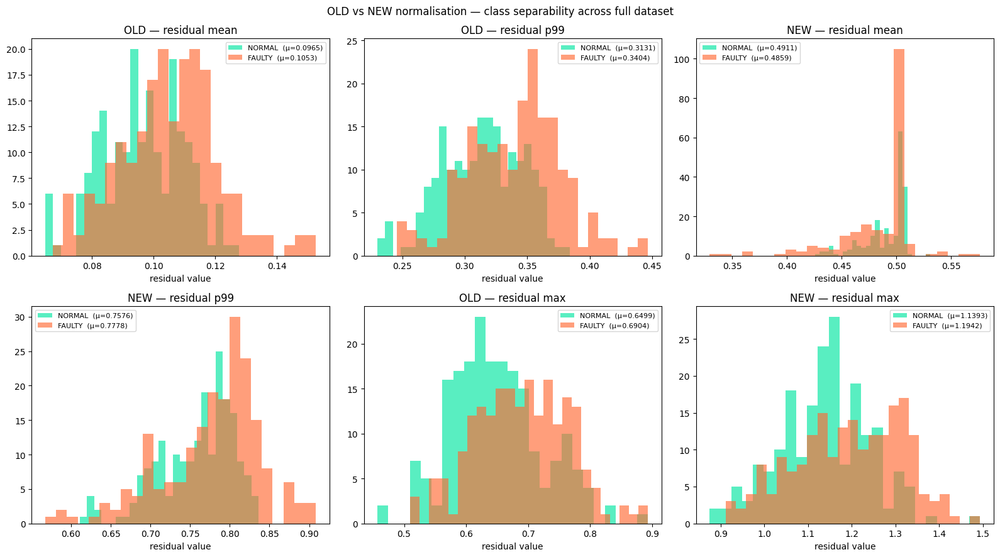

OLD — residual mean                  KS stat=0.265  p=0.0000  ✗ overlapping
OLD — residual p99                   KS stat=0.320  p=0.0000  ✗ overlapping
NEW — residual mean                  KS stat=0.110  p=0.1779  ✗ overlapping
NEW — residual p99                   KS stat=0.275  p=0.0000  ✗ overlapping
OLD — residual max                   KS stat=0.255  p=0.0000  ✗ overlapping
NEW — residual max                   KS stat=0.260  p=0.0000  ✗ overlapping


In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL F — The real question: are N vs F residuals separable?
#
# After seeing individual tiles, this cell computes stats across
# your FULL dataset (both classes) and plots the distributions.
# This tells you whether thresholding will work at all, and
# whether old or new normalisation gives better separation.
#
# Run this once you have enough tiles processed.
# ════════════════════════════════════════════════════════════════
import os, glob, pandas as pd

def batch_residual_stats(tile_dir, n_tiles=50):
    """Sample n_tiles from a dir, compute old/new residual stats for each."""
    paths = glob.glob(os.path.join(tile_dir, "**", "*.jpg"), recursive=True)[:n_tiles]
    rows  = []
    for p in paths:
        bgr  = cv2.imread(p)
        if bgr is None:
            continue
        gray = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY).astype(np.float32)
        img  = apply_clahe(gray)
        _, Fshift, mag = compute_fft_mag(img)
        peak_coords, mask = pick_peaks_and_mask(mag, *img.shape, N_PEAKS, PEAK_RADIUS, DC_SUPPRESS_RADIUS)

        old = residual_old_style(Fshift, mask, img)
        new = residual_new_style(Fshift, mask, img)

        rows.append({
            "path"         : p,
            "old_mean"     : old.mean(),
            "old_p99"      : np.percentile(old, 99),
            "old_max"      : old.max(),
            "new_mean"     : new.mean(),
            "new_p99"      : np.percentile(new, 99),
            "new_max"      : new.max(),
        })
    return pd.DataFrame(rows)

print("Computing stats for NORMAL tiles...")
df_n = batch_residual_stats("tiles_896/normal",          n_tiles=200)
df_n["label"] = "NORMAL"

print("Computing stats for FAULTY tiles...")
df_f = batch_residual_stats("tiles_896/Faults/miss pick", n_tiles=200)
df_f["label"] = "FAULTY"

df = pd.concat([df_n, df_f], ignore_index=True)

fig, axes = plt.subplots(2, 3, figsize=(16, 9))
metrics = [("old_mean", "OLD — residual mean"),
           ("old_p99",  "OLD — residual p99"),
           ("new_mean", "NEW — residual mean"),
           ("new_p99",  "NEW — residual p99"),
           ("old_max",  "OLD — residual max"),
           ("new_max",  "NEW — residual max")]

for ax, (col, title) in zip(axes.ravel(), metrics):
    dn = df[df.label == "NORMAL"][col]
    df_ = df[df.label == "FAULTY"][col]
    ax.hist(dn,  bins=25, alpha=0.65, color="#00e5a0", label=f"NORMAL  (μ={dn.mean():.4f})")
    ax.hist(df_, bins=25, alpha=0.65, color="#ff6b35", label=f"FAULTY  (μ={df_.mean():.4f})")
    ax.set_title(title)
    ax.legend(fontsize=8)
    ax.set_xlabel("residual value")

plt.suptitle("OLD vs NEW normalisation — class separability across full dataset", fontsize=12)
plt.tight_layout()
plt.show()

# Overlap coefficient (lower = better separation)
from scipy.stats import ks_2samp
for col, title in metrics:
    stat, pval = ks_2samp(df[df.label=="NORMAL"][col], df[df.label=="FAULTY"][col])
    print(f"{title:35s}  KS stat={stat:.3f}  p={pval:.4f}  {'✓ SEPARABLE' if stat > 0.4 else '✗ overlapping'}")

━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━
  Best threshold : 0.3016
  F1             : 0.680
  Precision      : 0.567
  Recall         : 0.850
━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

✗  Threshold not enough. Go straight to the classifier below.


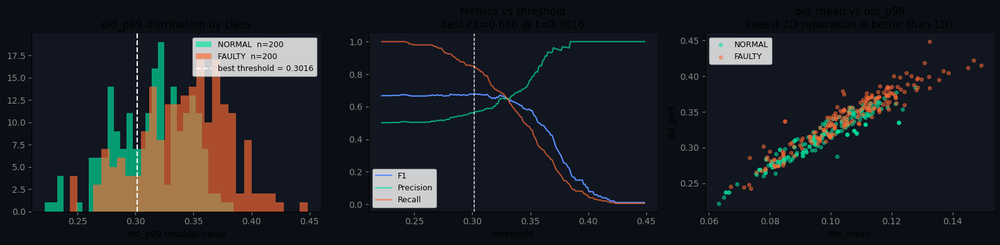

In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 1 — Confirm the decision visually
# Plot the ONE metric that separates best (old_p99)
# and find the threshold that maximises F1.
# Run this first. It tells you if a threshold alone is enough.
# ════════════════════════════════════════════════════════════════

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, precision_score, recall_score

# ── Reuse df from Cell F in previous notebook ────────────────────
# df has columns: old_mean, old_p99, old_max, new_*, label
# If you don't have it, re-run Cell F from the exploration notebook.

y_true = (df["label"] == "FAULTY").astype(int).values
scores = df["old_p99"].values   # ← our best feature

# Sweep thresholds and compute F1, precision, recall
thresholds = np.linspace(scores.min(), scores.max(), 200)
results = []
for t in thresholds:
    y_pred = (scores >= t).astype(int)
    results.append({
        "threshold" : t,
        "f1"        : f1_score(y_true, y_pred, zero_division=0),
        "precision" : precision_score(y_true, y_pred, zero_division=0),
        "recall"    : recall_score(y_true, y_pred, zero_division=0),
    })

res_df = pd.DataFrame(results)
best   = res_df.loc[res_df["f1"].idxmax()]

print("━" * 50)
print(f"  Best threshold : {best['threshold']:.4f}")
print(f"  F1             : {best['f1']:.3f}")
print(f"  Precision      : {best['precision']:.3f}")
print(f"  Recall         : {best['recall']:.3f}")
print("━" * 50)
print()
if best["f1"] > 0.85:
    print("✓  Single threshold on old_p99 is likely sufficient.")
    print("   Consider using this as your production baseline.")
elif best["f1"] > 0.70:
    print("~  Threshold alone is borderline. Add 1–2 more features → RF.")
else:
    print("✗  Threshold not enough. Go straight to the classifier below.")

# ── Plot ──────────────────────────────────────────────────────────
fig, axes = plt.subplots(1, 3, figsize=(16, 4))

# Histogram with threshold line
dn  = df[df.label == "NORMAL"]["old_p99"]
df_ = df[df.label == "FAULTY"]["old_p99"]
axes[0].hist(dn,  bins=30, alpha=0.65, color="#00e5a0", label=f"NORMAL  n={len(dn)}")
axes[0].hist(df_, bins=30, alpha=0.65, color="#ff6b35", label=f"FAULTY  n={len(df_)}")
axes[0].axvline(best["threshold"], color="white", linestyle="--", linewidth=1.5,
                label=f"best threshold = {best['threshold']:.4f}")
axes[0].set_title("old_p99 distribution by class")
axes[0].set_xlabel("old_p99 residual value")
axes[0].legend(fontsize=9)

# F1 / precision / recall vs threshold
axes[1].plot(res_df["threshold"], res_df["f1"],        color="#5b8fff", label="F1")
axes[1].plot(res_df["threshold"], res_df["precision"], color="#00e5a0", label="Precision", alpha=0.7)
axes[1].plot(res_df["threshold"], res_df["recall"],    color="#ff6b35", label="Recall",    alpha=0.7)
axes[1].axvline(best["threshold"], color="white", linestyle="--", linewidth=1)
axes[1].set_title(f"Metrics vs threshold\nbest F1={best['f1']:.3f} @ t={best['threshold']:.4f}")
axes[1].set_xlabel("threshold")
axes[1].legend(fontsize=9)

# Scatter: old_mean vs old_p99 coloured by class
axes[2].scatter(df[df.label=="NORMAL"]["old_mean"], df[df.label=="NORMAL"]["old_p99"],
                alpha=0.5, color="#00e5a0", s=15, label="NORMAL")
axes[2].scatter(df[df.label=="FAULTY"]["old_mean"], df[df.label=="FAULTY"]["old_p99"],
                alpha=0.5, color="#ff6b35", s=15, label="FAULTY")
axes[2].set_xlabel("old_mean")
axes[2].set_ylabel("old_p99")
axes[2].set_title("old_mean vs old_p99\n(see if 2D separation is better than 1D)")
axes[2].legend(fontsize=9)

for ax in axes:
    ax.set_facecolor("#111620")
fig.patch.set_facecolor("#0b0e14")
for ax in axes:
    ax.tick_params(colors="#888")
    ax.spines[["top","right"]].set_visible(False)
plt.tight_layout()
plt.show()

In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 2 — Minimal RF using old normalisation features only
#
# Uses only 3 features derived from OLD-style residuals.
# If Cell 1 showed threshold F1 < 0.85, run this.
# Stratified 5-fold so results are reliable even with small n.
# ════════════════════════════════════════════════════════════════

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import StratifiedKFold, cross_validate
from sklearn.metrics import classification_report
import warnings
warnings.filterwarnings("ignore")

# ── Build feature matrix from the df you already have ────────────
# These are all from OLD normalisation — which we now know is better.
feature_cols = ["old_mean", "old_p99", "old_max"]

X = df[feature_cols].values
y = (df["label"] == "FAULTY").astype(int).values

print(f"Dataset: {(y==0).sum()} NORMAL  |  {(y==1).sum()} FAULTY")
print(f"Features: {feature_cols}\n")

clf = RandomForestClassifier(
    n_estimators  = 300,
    class_weight  = "balanced",    # handles imbalanced classes
    max_features  = "sqrt",
    random_state  = 42,
    max_depth     = 5,
    min_samples_leaf = 3,
)

cv      = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
scoring = ["f1", "roc_auc", "precision", "recall"]
results = cross_validate(clf, X, y, cv=cv, scoring=scoring, return_train_score=True)

print("5-Fold Cross-Validation Results")
print("━" * 45)
for metric in scoring:
    test_scores  = results[f"test_{metric}"]
    train_scores = results[f"train_{metric}"]
    print(f"  {metric:12s}  "
          f"test={test_scores.mean():.3f} ± {test_scores.std():.3f}   "
          f"train={train_scores.mean():.3f}")
print("━" * 45)

# ── Feature importance ───────────────────────────────────────────
clf.fit(X, y)
importances = dict(zip(feature_cols, clf.feature_importances_))
print("\nFeature importances:")
for feat, imp in sorted(importances.items(), key=lambda x: -x[1]):
    bar = "█" * int(imp * 40)
    print(f"  {feat:15s}  {imp:.3f}  {bar}")

# ── What to try next based on results ───────────────────────────
test_f1 = results["test_f1"].mean()
gap     = results["train_f1"].mean() - test_f1

print(f"\n{'━'*45}")
if test_f1 >= 0.90:
    print(f"✓  F1={test_f1:.3f}. You're done — ship this.")
elif test_f1 >= 0.80 and gap < 0.1:
    print(f"~  F1={test_f1:.3f}. Add connected-component features next.")
    print(f"   (n_blobs, max_blob_area) from the exploration notebook.")
elif gap >= 0.15:
    print(f"⚠  Train/test gap={gap:.3f} — overfitting on small data.")
    print(f"   Try: max_depth=5, min_samples_leaf=3, or get more tiles.")
else:
    print(f"✗  F1={test_f1:.3f}. Features aren't separating well enough.")
    print(f"   Next: add spatial grid (Cell 4 from feature notebook)")
    print(f"   or check whether PEAK_RADIUS is absorbing fault signal.")
print("━" * 45)

Dataset: 200 NORMAL  |  200 FAULTY
Features: ['old_mean', 'old_p99', 'old_max']

5-Fold Cross-Validation Results
━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━
  f1            test=0.625 ± 0.034   train=0.776
  roc_auc       test=0.703 ± 0.051   train=0.909
  precision     test=0.727 ± 0.047   train=0.874
  recall        test=0.550 ± 0.042   train=0.699
━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

Feature importances:
  old_p99          0.408  ████████████████
  old_mean         0.319  ████████████
  old_max          0.273  ██████████

━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━
⚠  Train/test gap=0.152 — overfitting on small data.
   Try: max_depth=5, min_samples_leaf=3, or get more tiles.
━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━


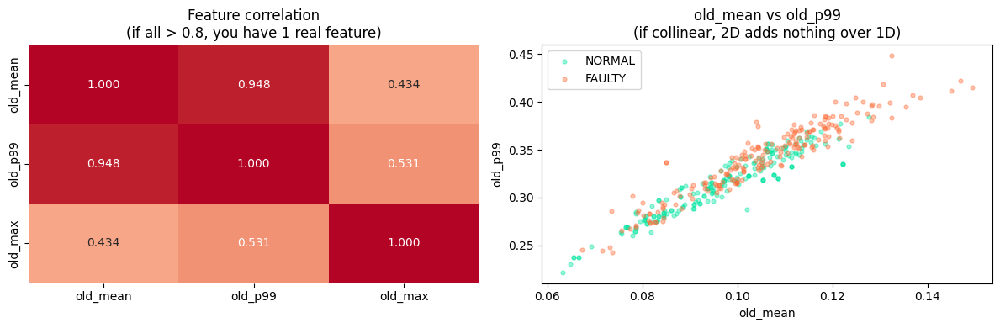

Correlations between current features:
          old_mean   old_p99   old_max
old_mean  1.000000  0.947913  0.433899
old_p99   0.947913  1.000000  0.531288
old_max   0.433899  0.531288  1.000000

If all correlations > 0.80: you have 1 effective feature.
Solution: add STRUCTURAL features that measure WHERE and HOW, not just HOW MUCH.



In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 1 — Why your 3 features are basically 1 feature
# Run this to confirm the correlation problem before adding more.
# ════════════════════════════════════════════════════════════════

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Using df from previous session (old_mean, old_p99, old_max, label)
fig, axes = plt.subplots(1, 2, figsize=(12, 4))

# Correlation matrix
corr = df[["old_mean", "old_p99", "old_max"]].corr()
sns.heatmap(corr, annot=True, fmt=".3f", cmap="coolwarm",
            ax=axes[0], vmin=-1, vmax=1, cbar=False)
axes[0].set_title("Feature correlation\n(if all > 0.8, you have 1 real feature)")

# Scatter pairs coloured by class
for label, color in [("NORMAL", "#00e5a0"), ("FAULTY", "#ff6b35")]:
    sub = df[df.label == label]
    axes[1].scatter(sub["old_mean"], sub["old_p99"],
                    alpha=0.4, color=color, s=12, label=label)
axes[1].set_xlabel("old_mean")
axes[1].set_ylabel("old_p99")
axes[1].set_title("old_mean vs old_p99\n(if collinear, 2D adds nothing over 1D)")
axes[1].legend()

plt.tight_layout()
plt.show()

print("Correlations between current features:")
print(corr.to_string())
print("\nIf all correlations > 0.80: you have 1 effective feature.")
print("Solution: add STRUCTURAL features that measure WHERE and HOW, not just HOW MUCH.\n")

In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 2 — Full structural feature extractor
#
# Replaces and extends extract_features() from before.
# Every feature group here measures something DIFFERENT:
#
#   GROUP A — Intensity (what you had)
#   GROUP B — Spatial concentration  ← new: WHERE is the signal?
#   GROUP C — Connected components   ← new: HOW MANY blobs?
#   GROUP D — Blob shape             ← new: WHAT SHAPE are they?
#   GROUP E — Spatial grid           ← new: WHICH PART of tile?
#   GROUP F — Residual texture       ← new: smooth or structured?
#
# Expected outcome: 40–50 features, low inter-group correlation.
# ════════════════════════════════════════════════════════════════

import cv2
from scipy import stats as scipy_stats

def extract_all_features(res: np.ndarray, thresh_low=0.10, thresh_high=0.20) -> dict:
    """
    res     : 2D float32 residual map from OLD-style normalisation, values ~0..1
    Returns : flat dict of features (one row in your DataFrame)

    All features are cheap to compute — full 896×896 tile takes <50ms.
    """
    h, w   = res.shape
    flat   = res.ravel()
    feats  = {}

    # ── GROUP A: Intensity (your existing 3, keep them) ──────────
    feats["mean"]   = flat.mean()
    feats["std"]    = flat.std()
    feats["p75"]    = np.percentile(flat, 75)
    feats["p95"]    = np.percentile(flat, 95)
    feats["p99"]    = np.percentile(flat, 99)
    feats["max"]    = flat.max()
    feats["skew"]   = float(scipy_stats.skew(flat))
    feats["kurt"]   = float(scipy_stats.kurtosis(flat))
    # Fraction of pixels above thresholds — measures "spread of anomaly"
    feats["frac_above_low"]  = float((flat > thresh_low).mean())
    feats["frac_above_high"] = float((flat > thresh_high).mean())

    # ── GROUP B: Spatial concentration ───────────────────────────
    # Gini coefficient of residual: 0 = perfectly uniform, 1 = all in one spot
    # Faulty tiles: fault is localised → high Gini
    # Normal tiles: residual is diffuse/uniform → low Gini
    sorted_flat    = np.sort(flat)
    n              = len(sorted_flat)
    cumsum         = np.cumsum(sorted_flat)
    gini           = (2 * np.sum((np.arange(1, n+1) * sorted_flat))) / (n * cumsum[-1] + 1e-12) - (n + 1) / n
    feats["gini"]  = float(gini)

    # Centre of mass deviation — where is the residual mass?
    # Normal: CoM near centre. Faulty: CoM shifts toward the fault region.
    ys, xs = np.mgrid[0:h, 0:w]
    total  = res.sum() + 1e-12
    com_y  = (ys * res).sum() / total
    com_x  = (xs * res).sum() / total
    # Normalise to [-1, 1] range
    feats["com_y_norm"] = (com_y / h) * 2 - 1
    feats["com_x_norm"] = (com_x / w) * 2 - 1
    feats["com_dist"]   = float(np.sqrt((com_y/h - 0.5)**2 + (com_x/w - 0.5)**2))

    # ── GROUP C: Connected components (blobs above threshold) ─────
    for thresh, tname in [(thresh_low, "lo"), (thresh_high, "hi")]:
        binary    = (res > thresh).astype(np.uint8)
        n_labels, label_map, stats_cc, centroids = \
            cv2.connectedComponentsWithStats(binary, connectivity=8)

        # stats_cc rows: [left, top, width, height, area] — row 0 is background
        areas = stats_cc[1:, cv2.CC_STAT_AREA]   # skip background

        feats[f"n_blobs_{tname}"]        = max(0, len(areas))
        feats[f"max_blob_area_{tname}"]  = int(areas.max())  if len(areas) > 0 else 0
        feats[f"sum_blob_area_{tname}"]  = int(areas.sum())  if len(areas) > 0 else 0
        feats[f"mean_blob_area_{tname}"] = float(areas.mean()) if len(areas) > 0 else 0
        # Coverage: what fraction of tile is "active"
        feats[f"coverage_{tname}"]       = float(binary.mean())

    # ── GROUP D: Shape of the largest blob ───────────────────────
    # Miss-pick faults are typically elongated (missing thread row/col)
    # Normal residual blobs are small and roughly circular
    binary_hi = (res > thresh_high).astype(np.uint8)
    n_labels, label_map, stats_cc, centroids = \
        cv2.connectedComponentsWithStats(binary_hi, connectivity=8)

    if n_labels > 1:  # at least one non-background blob
        areas      = stats_cc[1:, cv2.CC_STAT_AREA]
        largest_id = np.argmax(areas) + 1          # +1 because 0 = background
        lstat      = stats_cc[largest_id]
        bw         = lstat[cv2.CC_STAT_WIDTH]  + 1e-3
        bh         = lstat[cv2.CC_STAT_HEIGHT] + 1e-3
        blob_mask  = (label_map == largest_id).astype(np.uint8)

        feats["largest_blob_ar"]       = float(max(bw, bh) / min(bw, bh))  # aspect ratio
        feats["largest_blob_extent"]   = float(areas[largest_id-1] / (bw * bh))  # how filled is bbox
        feats["largest_blob_rel_area"] = float(areas[largest_id-1] / (h * w))    # fraction of tile

        # Solidity: area / convex hull area (elongated faults → low solidity)
        contours, _ = cv2.findContours(blob_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        if contours:
            hull     = cv2.convexHull(contours[0])
            hull_area = cv2.contourArea(hull) + 1e-3
            feats["largest_blob_solidity"] = float(cv2.contourArea(contours[0]) / hull_area)
        else:
            feats["largest_blob_solidity"] = 0.0
    else:
        feats["largest_blob_ar"]       = 1.0
        feats["largest_blob_extent"]   = 0.0
        feats["largest_blob_rel_area"] = 0.0
        feats["largest_blob_solidity"] = 0.0

    # ── GROUP E: Spatial grid (3×3 regions) ──────────────────────
    # Captures WHICH PART of the tile has high residual.
    # A miss-pick fault spanning one row → the 3 grid cells in that
    # row all light up. Uniform normal tiles → all cells similar.
    for i in range(3):
        for j in range(3):
            region = res[i*h//3:(i+1)*h//3, j*w//3:(j+1)*w//3]
            feats[f"grid_{i}{j}_mean"] = float(region.mean())
            feats[f"grid_{i}{j}_max"]  = float(region.max())

    # Grid variance: how non-uniform is the residual across regions?
    grid_means = [feats[f"grid_{i}{j}_mean"] for i in range(3) for j in range(3)]
    feats["grid_mean_std"]  = float(np.std(grid_means))   # high = localised fault
    feats["grid_max_ratio"] = float(max(grid_means) / (np.mean(grid_means) + 1e-12))

    # ── GROUP F: Texture / smoothness of residual ─────────────────
    # Gradient magnitude of residual: sharp edges = structured fault
    # Normal residual is smooth/noisy, fault edges are sharp
    grad_y = np.gradient(res, axis=0)
    grad_x = np.gradient(res, axis=1)
    grad_mag = np.sqrt(grad_x**2 + grad_y**2)
    feats["grad_mean"] = float(grad_mag.mean())
    feats["grad_p95"]  = float(np.percentile(grad_mag, 95))
    feats["grad_max"]  = float(grad_mag.max())

    return feats

FAULTY  : 100%|██████████| 200/200 [01:21<00:00,  2.45it/s]


Total features : 51
Dataset        : 200 NORMAL  |  200 FAULTY

Sample features:
                       mean         std       min         max
mean               0.101073    0.015171  0.063209    0.149385
std                0.020216    0.005150  0.009203    0.039987
p75                0.107185    0.015947  0.068395    0.168465
p95                0.142081    0.026600  0.083086    0.212133
p99                0.179180    0.030406  0.109000    0.284709
max                0.242736    0.035315  0.159370    0.477118
skew               2.018250    0.533490  0.080563    3.251553
kurt               6.267769    3.002688 -0.776746   17.040714
frac_above_low     0.448851    0.290168  0.020782    0.998092
frac_above_high    0.007948    0.010775  0.000000    0.068129
gini               0.098261    0.020348  0.058949    0.224879
com_y_norm        -0.004505    0.015414 -0.063225    0.040968
com_x_norm        -0.003161    0.021469 -0.084357    0.158450
com_dist           0.009659    0.009417  0.000412  

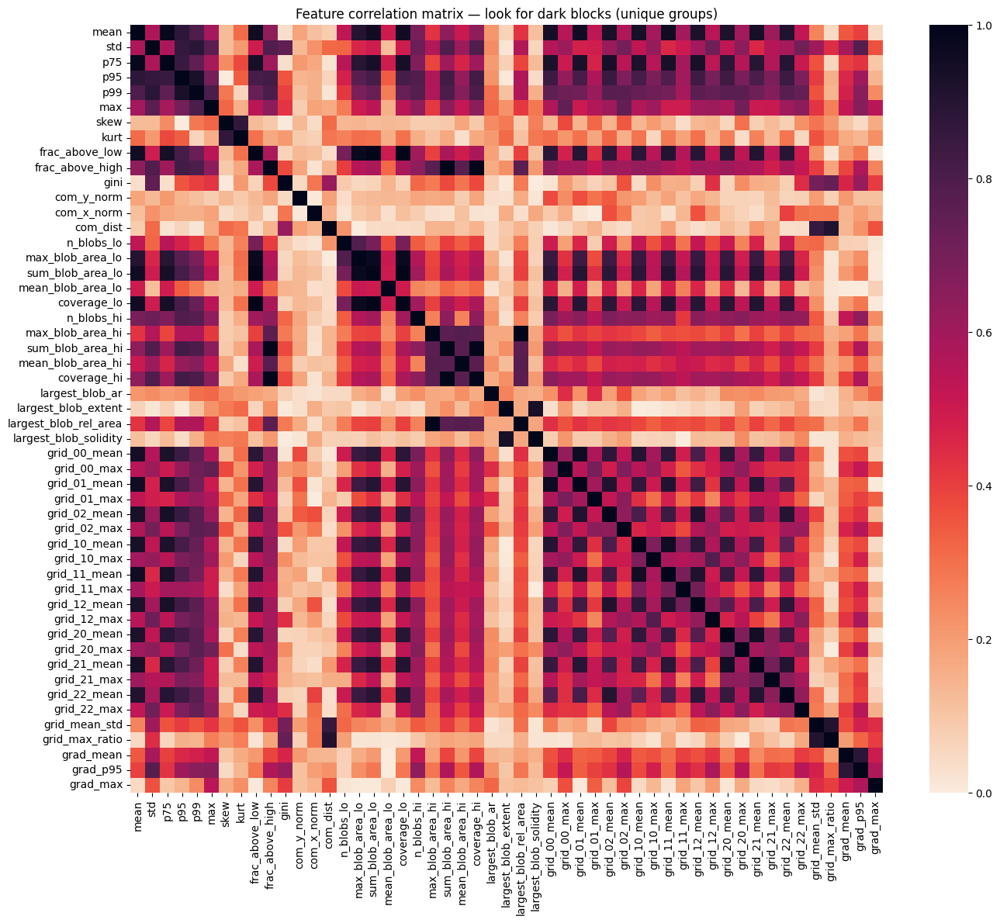

In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 3 — Rebuild dataset with full feature set + check correlation
# ════════════════════════════════════════════════════════════════

import os, glob
from tqdm import tqdm

def load_and_featurise(tile_dir, label, n_max=None):
    """Load raw tiles, compute OLD-style residual, extract all features."""
    paths = glob.glob(os.path.join(tile_dir, "**", "*.jpg"), recursive=True)
    if n_max:
        paths = paths[:n_max]

    rows = []
    for p in tqdm(paths, desc=f"{'NORMAL' if label==0 else 'FAULTY':8s}"):
        bgr = cv2.imread(p)
        if bgr is None:
            continue
        gray = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY).astype(np.float32)
        img  = apply_clahe(gray)   # from earlier cells

        _, Fshift, mag = compute_fft_mag(img)
        peak_coords, mask = pick_peaks_and_mask(
            mag, *img.shape, N_PEAKS, PEAK_RADIUS, DC_SUPPRESS_RADIUS
        )

        # OLD-style residual (independent normalisation — we know this is better)
        res = residual_old_style(Fshift, mask, img)
        # Smooth before feature extraction (same as production pipeline)
        res_s = ndi.gaussian_filter(res, sigma=5)

        feats = extract_all_features(res_s)
        feats["label"] = label
        feats["path"]  = p
        rows.append(feats)

    return pd.DataFrame(rows)

df_n2 = load_and_featurise("tiles_896/normal",           label=0, n_max=200)
df_f2 = load_and_featurise("tiles_896/Faults/miss pick", label=1, n_max=200)
df2   = pd.concat([df_n2, df_f2], ignore_index=True)

feature_cols = [c for c in df2.columns if c not in ("label", "path")]
print(f"Total features : {len(feature_cols)}")
print(f"Dataset        : {(df2.label==0).sum()} NORMAL  |  {(df2.label==1).sum()} FAULTY")
print(f"\nSample features:\n{df2[feature_cols].describe().T[['mean','std','min','max']].head(15)}")

# Feature correlation heatmap (spot redundancy early)
corr_mat = df2[feature_cols].corr().abs()
fig, ax = plt.subplots(figsize=(14, 12))
sns.heatmap(corr_mat, cmap="rocket_r", ax=ax, xticklabels=True, yticklabels=True,
            vmin=0, vmax=1)
ax.set_title("Feature correlation matrix — look for dark blocks (unique groups)")
plt.tight_layout()
plt.show()

In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 4 — Per-feature KS stats: see which new features help most
# ════════════════════════════════════════════════════════════════

from scipy.stats import ks_2samp

ks_rows = []
for col in feature_cols:
    n_vals = df2[df2.label==0][col].dropna()
    f_vals = df2[df2.label==1][col].dropna()
    stat, pval = ks_2samp(n_vals, f_vals)
    ks_rows.append({"feature": col, "ks_stat": stat, "pval": pval})

ks_df = pd.DataFrame(ks_rows).sort_values("ks_stat", ascending=False)

print("\nTop 20 features by KS separation:")
print("─" * 60)
for _, row in ks_df.head(20).iterrows():
    bar   = "█" * int(row["ks_stat"] * 30)
    sig   = "✓" if row["pval"] < 0.01 else "✗"
    print(f"  {sig} {row['feature']:30s}  KS={row['ks_stat']:.3f}  {bar}")
print("─" * 60)
print("\nBottom 5 (probably safe to drop):")
for _, row in ks_df.tail(5).iterrows():
    print(f"  ✗ {row['feature']:30s}  KS={row['ks_stat']:.3f}  p={row['pval']:.3f}")


Top 20 features by KS separation:
────────────────────────────────────────────────────────────
  ✓ grid_mean_std                   KS=0.460  █████████████
  ✓ grid_max_ratio                  KS=0.410  ████████████
  ✓ p95                             KS=0.375  ███████████
  ✓ grid_11_max                     KS=0.375  ███████████
  ✓ std                             KS=0.370  ███████████
  ✓ grad_p95                        KS=0.365  ██████████
  ✓ com_dist                        KS=0.360  ██████████
  ✓ kurt                            KS=0.325  █████████
  ✓ grid_12_mean                    KS=0.320  █████████
  ✓ p99                             KS=0.315  █████████
  ✓ gini                            KS=0.300  █████████
  ✓ sum_blob_area_hi                KS=0.300  █████████
  ✓ coverage_hi                     KS=0.300  █████████
  ✓ frac_above_high                 KS=0.300  █████████
  ✓ grid_11_mean                    KS=0.295  ████████
  ✓ grad_mean                       KS=0.290  ████

In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 5 — Re-run RF with full feature set
# Compare directly to previous 3-feature result.
# ════════════════════════════════════════════════════════════════

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import StratifiedKFold, cross_validate
import warnings
warnings.filterwarnings("ignore")

X2 = df2[feature_cols].fillna(0).values
y2 = df2["label"].values

clf2 = RandomForestClassifier(
    n_estimators   = 300,
    max_depth      = 10,          # constrain to reduce overfitting
    min_samples_leaf = 3,         # smooth decision boundaries
    class_weight   = "balanced",
    max_features   = "sqrt",
    random_state   = 42,
)

cv      = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
scoring = ["f1", "roc_auc", "precision", "recall"]
results2 = cross_validate(clf2, X2, y2, cv=cv, scoring=scoring, return_train_score=True)

print("\n5-Fold CV — FULL FEATURE SET")
print("━" * 52)
print(f"  {'Metric':12s}  {'Test':>14s}  {'Train':>8s}  {'Gap':>6s}")
print("  " + "─" * 46)
for m in scoring:
    test  = results2[f"test_{m}"]
    train = results2[f"train_{m}"]
    gap   = train.mean() - test.mean()
    flag  = " ⚠" if gap > 0.15 else ""
    print(f"  {m:12s}  {test.mean():.3f} ± {test.std():.3f}  "
          f"{train.mean():.3f}    {gap:+.3f}{flag}")
print("━" * 52)

# Compare to baseline
prev_f1 = 0.601
new_f1  = results2["test_f1"].mean()
delta   = new_f1 - prev_f1
print(f"\nPrevious F1 (3 features) : 0.601")
print(f"New F1 ({len(feature_cols):2d} features)    : {new_f1:.3f}  ({delta:+.3f})")

# Top feature importances
clf2.fit(X2, y2)
imp_df = pd.DataFrame({
    "feature"   : feature_cols,
    "importance": clf2.feature_importances_
}).sort_values("importance", ascending=False)

print(f"\nTop 15 feature importances:")
for _, row in imp_df.head(15).iterrows():
    bar = "█" * int(row["importance"] * 60)
    print(f"  {row['feature']:30s}  {row['importance']:.4f}  {bar}")



5-Fold CV — FULL FEATURE SET
━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━
  Metric                  Test     Train     Gap
  ──────────────────────────────────────────────
  f1            0.785 ± 0.038  0.981    +0.196 ⚠
  roc_auc       0.880 ± 0.038  0.999    +0.119
  precision     0.833 ± 0.029  0.994    +0.160 ⚠
  recall        0.745 ± 0.062  0.969    +0.224 ⚠
━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

Previous F1 (3 features) : 0.601
New F1 (51 features)    : 0.785  (+0.184)

Top 15 feature importances:
  grid_mean_std                   0.0951  █████
  grid_max_ratio                  0.0808  ████
  grid_11_max                     0.0787  ████
  com_y_norm                      0.0448  ██
  com_dist                        0.0432  ██
  grad_p95                        0.0370  ██
  std                             0.0324  █
  kurt                            0.0301  █
  p95                             0.0295  █
  grid_12_mean                    0.0224  █
  grad_mean   

In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 1 — Prune to a lean, uncorrelated feature set
#
# Strategy:
#   1. Drop features with KS < 0.15 (not separating)
#   2. Within correlated clusters, keep highest KS only
#   3. Target: ~12-15 features for 400 samples (30:1 ratio)
#
# This directly attacks the train/test gap.
# ════════════════════════════════════════════════════════════════

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import ks_2samp

# ── Step 1: Drop weak features (KS < 0.15) ───────────────────────
# These are statistically indistinguishable between classes.
# Keeping them adds noise and overfitting surface.
WEAK_FEATURES = [
    "largest_blob_extent",    # KS=0.125
    "grid_01_max",            # KS=0.125
    "largest_blob_solidity",  # KS=0.120
    "largest_blob_ar",        # KS=0.110 — miss-pick blobs aren't clean enough
    "com_x_norm",             # KS=0.070, p=0.713 — useless
]

# ── Step 2: Drop correlated redundancy ───────────────────────────
# These groups are measuring the same thing:
#
# GROUP: blob area (all ~KS 0.325, highly correlated with each other)
#   keep: coverage_hi (most direct interpretation)
#   drop: max_blob_area_hi, sum_blob_area_hi, mean_blob_area_hi, largest_blob_rel_area
#
# GROUP: grid cell means (18 features, summarised by grid_mean_std + grid_max_ratio)
#   keep: grid_mean_std, grid_max_ratio, grid_11_max (centre cell — faults often central)
#   drop: all individual grid_ij_mean except grid_11_mean (centre)
#         grid_11 is centre cell — keep, others are lower KS
#
# GROUP: intensity (p95, p99, mean, std — correlated)
#   keep: p95 (highest KS), std (captures spread differently from p95)
#   drop: p99 (KS dropped from 0.450 to 0.335 with structural features added),
#         mean (now weakest of the group at KS=0.280)

REDUNDANT_FEATURES = [
    # blob area duplicates
    "max_blob_area_hi", "sum_blob_area_hi", "mean_blob_area_hi", "largest_blob_rel_area",
    "n_blobs_hi", "n_blobs_lo",
    # blob area at low threshold (highly correlated with hi threshold versions)
    "max_blob_area_lo", "sum_blob_area_lo", "mean_blob_area_lo", "coverage_lo",
    # grid cell means (summarised by grid_mean_std)
    "grid_00_mean", "grid_01_mean", "grid_02_mean",
    "grid_10_mean", "grid_12_mean",
    "grid_20_mean", "grid_21_mean", "grid_22_mean",
    # grid max for corner/edge cells (lower KS, dominated by centre)
    "grid_00_max", "grid_02_max", "grid_20_max", "grid_22_max",
    "grid_10_max", "grid_12_max", "grid_20_max", "grid_21_max",
    # intensity redundancy
    "p99", "mean", "max", "p75",
    "frac_above_low",   # correlated with frac_above_high
    # gradient: mean correlated with p95
    "grad_max",
    # CoM components (com_dist summarises both)
    "com_y_norm",
]

DROP_ALL = set(WEAK_FEATURES + REDUNDANT_FEATURES)

# Final lean feature set
LEAN_FEATURES = [c for c in feature_cols if c not in DROP_ALL]
print(f"Features before pruning : {len(feature_cols)}")
print(f"Features after pruning  : {len(LEAN_FEATURES)}")
print(f"\nLEAN FEATURE SET:")
for i, f in enumerate(LEAN_FEATURES):
    # Get KS stat
    n_vals = df2[df2.label==0][f].dropna()
    fv     = df2[df2.label==1][f].dropna()
    ks, _  = ks_2samp(n_vals, fv)
    bar    = "█" * int(ks * 30)
    print(f"  {i+1:2d}. {f:30s}  KS={ks:.3f}  {bar}")

# Correlation check on lean set
corr_lean = df2[LEAN_FEATURES].corr().abs()
high_corr = [(c1, c2, corr_lean.loc[c1, c2])
             for i, c1 in enumerate(LEAN_FEATURES)
             for c2 in LEAN_FEATURES[i+1:]
             if corr_lean.loc[c1, c2] > 0.80]

print(f"\nRemaining high correlations (>0.80):")
if high_corr:
    for c1, c2, v in sorted(high_corr, key=lambda x: -x[2]):
        print(f"  {c1:30s} ↔ {c2:30s}  r={v:.3f}")
else:
    print("  None — feature set is well decorrelated ✓")




Features before pruning : 51
Features after pruning  : 14

LEAN FEATURE SET:
   1. std                             KS=0.370  ███████████
   2. p95                             KS=0.375  ███████████
   3. skew                            KS=0.220  ██████
   4. kurt                            KS=0.325  █████████
   5. frac_above_high                 KS=0.300  █████████
   6. gini                            KS=0.300  █████████
   7. com_dist                        KS=0.360  ██████████
   8. coverage_hi                     KS=0.300  █████████
   9. grid_11_mean                    KS=0.295  ████████
  10. grid_11_max                     KS=0.375  ███████████
  11. grid_mean_std                   KS=0.460  █████████████
  12. grid_max_ratio                  KS=0.410  ████████████
  13. grad_mean                       KS=0.290  ████████
  14. grad_p95                        KS=0.365  ██████████

Remaining high correlations (>0.80):
  frac_above_high                ↔ coverage_hi                 

In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 2 — Retrain: lean features, two models, direct comparison
#
# RF:  fewer features → lower variance → gap should close
# SVM: naturally better on small datasets, fewer hyperparams
#
# Target: gap < 0.10, test F1 > 0.82
# ════════════════════════════════════════════════════════════════

from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import StratifiedKFold, cross_validate
import warnings
warnings.filterwarnings("ignore")

X_lean = df2[LEAN_FEATURES].fillna(0).values
y2     = df2["label"].values
cv     = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
scoring = ["f1", "roc_auc", "precision", "recall"]

models = {
    "RF  (lean)": RandomForestClassifier(
        n_estimators     = 300,
        max_depth        = 8,
        min_samples_leaf = 4,
        class_weight     = "balanced",
        max_features     = "sqrt",
        random_state     = 42,
    ),
    "SVM (lean)": Pipeline([
        ("scaler", StandardScaler()),
        ("svc", SVC(
            kernel       = "rbf",
            C            = 1.0,
            class_weight = "balanced",
            probability  = True,
            random_state = 42,
        )),
    ]),
}

all_results = {}
print(f"{'Model':20s}  {'F1':>18s}  {'ROC-AUC':>18s}  {'Recall':>18s}  {'Gap(F1)':>8s}")
print("─" * 88)

for name, model in models.items():
    res = cross_validate(model, X_lean, y2, cv=cv,
                         scoring=scoring, return_train_score=True)
    all_results[name] = res
    f1_test  = res["test_f1"].mean()
    f1_train = res["train_f1"].mean()
    gap      = f1_train - f1_test
    flag     = " ⚠" if gap > 0.10 else " ✓"
    print(f"{name:20s}  "
          f"F1={f1_test:.3f}±{res['test_f1'].std():.3f}  "
          f"AUC={res['test_roc_auc'].mean():.3f}±{res['test_roc_auc'].std():.3f}  "
          f"Rec={res['test_recall'].mean():.3f}±{res['test_recall'].std():.3f}  "
          f"gap={gap:+.3f}{flag}")

print("─" * 88)
print(f"{'BASELINE (51 feat)':20s}  F1=0.792              AUC=0.857              Rec=0.745              gap=+0.183 ⚠")




Model                                 F1             ROC-AUC              Recall   Gap(F1)
────────────────────────────────────────────────────────────────────────────────────────
RF  (lean)            F1=0.785±0.059  AUC=0.872±0.043  Rec=0.755±0.099  gap=+0.151 ⚠
SVM (lean)            F1=0.783±0.059  AUC=0.866±0.039  Rec=0.695±0.104  gap=+0.019 ✓
────────────────────────────────────────────────────────────────────────────────────────
BASELINE (51 feat)    F1=0.792              AUC=0.857              Rec=0.745              gap=+0.183 ⚠


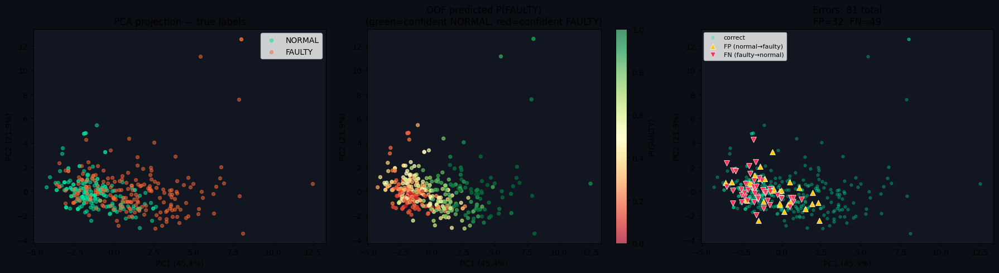


PCA variance explained: PC1=45.4%  PC2=21.9%  total=67.2%

OOF Errors: 81 / 400
  False Positives (Normal called Faulty): 32
  False Negatives (Fault missed)        : 49


In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 3 — Visualise what the model is actually doing
#
# 2D projection of the lean feature space.
# Shows whether classes are genuinely separable or still tangled.
# Also shows which individual samples are hardest to classify.
# ════════════════════════════════════════════════════════════════

from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_lean)

# PCA to 2D for visualisation
pca  = PCA(n_components=2, random_state=42)
X_2d = pca.fit_transform(X_scaled)

# Get per-sample OOF predictions from RF for colour coding
from sklearn.model_selection import cross_val_predict
rf_lean = RandomForestClassifier(
    n_estimators=300, max_depth=8, min_samples_leaf=4,
    class_weight="balanced", max_features="sqrt", random_state=42
)
oof_proba = cross_val_predict(rf_lean, X_lean, y2, cv=cv, method="predict_proba")[:, 1]
oof_pred  = (oof_proba >= 0.5).astype(int)

correct   = oof_pred == y2
errors    = ~correct

fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# Plot 1: True class labels
for label, color, name in [(0, "#00e5a0", "NORMAL"), (1, "#ff6b35", "FAULTY")]:
    mask = y2 == label
    axes[0].scatter(X_2d[mask, 0], X_2d[mask, 1],
                    c=color, alpha=0.5, s=18, label=name)
axes[0].set_title("PCA projection — true labels")
axes[0].legend()

# Plot 2: Prediction confidence
sc = axes[1].scatter(X_2d[:, 0], X_2d[:, 1],
                     c=oof_proba, cmap="RdYlGn", s=18, alpha=0.7,
                     vmin=0, vmax=1)
plt.colorbar(sc, ax=axes[1], label="P(FAULTY)")
axes[1].set_title("OOF predicted P(FAULTY)\n(green=confident NORMAL, red=confident FAULTY)")

# Plot 3: Errors highlighted
axes[2].scatter(X_2d[correct, 0],  X_2d[correct, 1],
                c="#00e5a0", alpha=0.3, s=12, label="correct")
axes[2].scatter(X_2d[errors & (y2==0), 0], X_2d[errors & (y2==0), 1],
                c="#ffcc00", s=50, marker="^", label="FP (normal→faulty)", edgecolors="white", linewidth=0.5)
axes[2].scatter(X_2d[errors & (y2==1), 0], X_2d[errors & (y2==1), 1],
                c="#ff3355", s=50, marker="v", label="FN (faulty→normal)", edgecolors="white", linewidth=0.5)
axes[2].set_title(f"Errors: {errors.sum()} total\n"
                  f"FP={((oof_pred==1)&(y2==0)).sum()}  FN={((oof_pred==0)&(y2==1)).sum()}")
axes[2].legend(fontsize=8)

for ax in axes:
    ax.set_facecolor("#111620")
    ax.set_xlabel(f"PC1 ({pca.explained_variance_ratio_[0]*100:.1f}%)")
    ax.set_ylabel(f"PC2 ({pca.explained_variance_ratio_[1]*100:.1f}%)")
fig.patch.set_facecolor("#0b0e14")
plt.tight_layout()
plt.show()

print(f"\nPCA variance explained: PC1={pca.explained_variance_ratio_[0]*100:.1f}%  "
      f"PC2={pca.explained_variance_ratio_[1]*100:.1f}%  "
      f"total={sum(pca.explained_variance_ratio_)*100:.1f}%")
print(f"\nOOF Errors: {errors.sum()} / {len(y2)}")
print(f"  False Positives (Normal called Faulty): {((oof_pred==1)&(y2==0)).sum()}")
print(f"  False Negatives (Fault missed)        : {((oof_pred==0)&(y2==1)).sum()}")





FN tiles (63 total) — showing 6


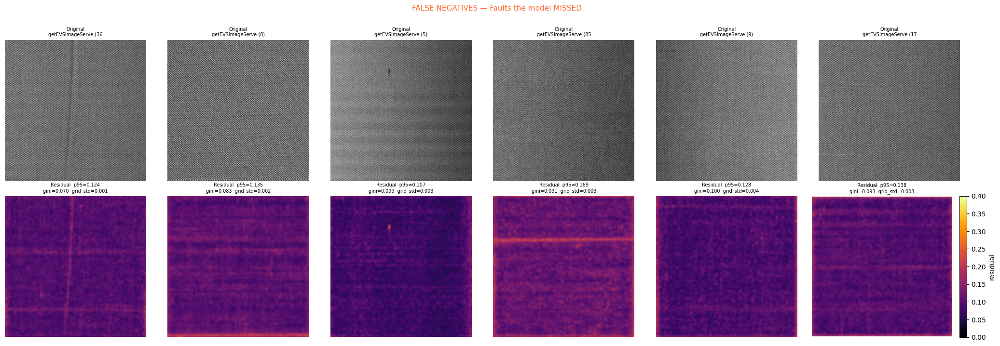


FP tiles (31 total) — showing 6


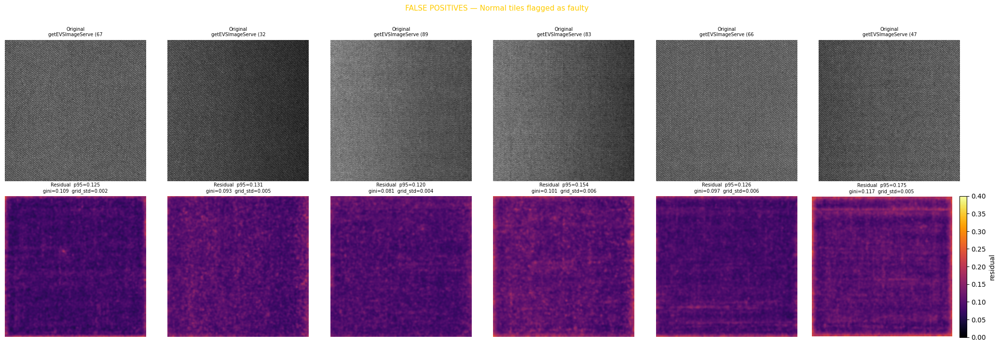

In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 4 — Inspect the actual misclassified tiles
#
# Most important cell for understanding WHERE the model fails.
# Shows you the residual maps of FP and FN tiles so you can
# decide if they're genuinely ambiguous or fixable with better features.
# ════════════════════════════════════════════════════════════════

def show_error_tiles(df2, oof_pred, y2, error_type="FN", n=6, vmax=0.4):
    """
    error_type: 'FN' = faulty tiles the model missed
                'FP' = normal tiles incorrectly flagged
    """
    assert error_type in ("FN", "FP")
    true_label = 1 if error_type == "FN" else 0
    mask = (oof_pred != y2) & (y2 == true_label)
    error_paths = df2.loc[mask, "path"].tolist()

    print(f"\n{error_type} tiles ({len(error_paths)} total) — showing {min(n, len(error_paths))}")

    sample = error_paths[:n]
    fig, axes = plt.subplots(2, len(sample), figsize=(3.5*len(sample), 7))
    if len(sample) == 1:
        axes = axes.reshape(2, 1)

    for j, p in enumerate(sample):
        bgr  = cv2.imread(p)
        gray = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY).astype(np.float32)
        img  = apply_clahe(gray)
        _, Fshift, mag = compute_fft_mag(img)
        _, mask_fft    = pick_peaks_and_mask(mag, *img.shape, N_PEAKS, PEAK_RADIUS, DC_SUPPRESS_RADIUS)
        res = residual_old_style(Fshift, mask_fft, img)
        res_s = ndi.gaussian_filter(res, sigma=5)

        # Original tile
        axes[0, j].imshow(gray, cmap="gray")
        axes[0, j].set_title(f"Original\n{os.path.basename(p)[:20]}", fontsize=7)
        axes[0, j].axis("off")

        # Residual at fixed scale
        im = axes[1, j].imshow(res_s, cmap="inferno", vmin=0, vmax=vmax)
        feats = extract_all_features(res_s)
        axes[1, j].set_title(
            f"Residual  p95={feats['p95']:.3f}\n"
            f"gini={feats['gini']:.3f}  grid_std={feats['grid_mean_std']:.3f}", fontsize=7)
        axes[1, j].axis("off")

    plt.colorbar(im, ax=axes[1, -1], fraction=0.05, label="residual")
    plt.suptitle(
        f"{'FALSE NEGATIVES — Faults the model MISSED' if error_type=='FN' else 'FALSE POSITIVES — Normal tiles flagged as faulty'}",
        fontsize=11, y=1.01, color="#ff6b35" if error_type=="FN" else "#ffcc00"
    )
    plt.tight_layout()
    plt.show()

show_error_tiles(df2, oof_pred, y2, error_type="FN", n=6)
show_error_tiles(df2, oof_pred, y2, error_type="FP", n=6)

In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 1 — Drop exact and near-duplicate features
# frac_above_high == coverage_hi exactly (r=1.000) — one must go.
# Then pick one from each correlated cluster.
# Result: 6 truly independent features.
# ════════════════════════════════════════════════════════════════

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import StratifiedKFold, cross_validate, learning_curve
from sklearn.metrics import ConfusionMatrixDisplay
import warnings
warnings.filterwarnings("ignore")

# One representative from each independent cluster, chosen by highest KS:
FINAL_FEATURES = [
    "grid_mean_std",   # KS=0.460 — spatial non-uniformity (top overall)
    "grid_11_max",     # KS=0.375 — centre cell intensity (independent of std)
    "p95",             # KS=0.375 — global intensity (one representative)
    "grad_p95",        # KS=0.365 — texture sharpness
    "gini",            # KS=0.300 — spatial concentration (independent of grid)
    "kurt",            # KS=0.325 — distribution tail shape
]

X_final = df2[FINAL_FEATURES].fillna(0).values
y2      = df2["label"].values

# Verify correlations are now acceptable
corr = df2[FINAL_FEATURES].corr().abs()
print("Final feature correlations:")
print(corr.round(3).to_string())
high = [(c1, c2, corr.loc[c1,c2])
        for i, c1 in enumerate(FINAL_FEATURES)
        for c2 in FINAL_FEATURES[i+1:]
        if corr.loc[c1,c2] > 0.75]
print(f"\nCorrelations > 0.75: {len(high)}")
for c1, c2, v in high:
    print(f"  {c1} ↔ {c2}  r={v:.3f}")
print(f"\nSamples per feature: {len(y2)} / {len(FINAL_FEATURES)} = {len(y2)/len(FINAL_FEATURES):.0f}:1  ✓" )


Final feature correlations:
               grid_mean_std  grid_11_max    p95  grad_p95   gini   kurt
grid_mean_std          1.000        0.197  0.408     0.479  0.702  0.363
grid_11_max            0.197        1.000  0.600     0.493  0.163  0.186
p95                    0.408        0.600  1.000     0.608  0.357  0.338
grad_p95               0.479        0.493  0.608     1.000  0.622  0.140
gini                   0.702        0.163  0.357     0.622  1.000  0.208
kurt                   0.363        0.186  0.338     0.140  0.208  1.000

Correlations > 0.75: 0

Samples per feature: 400 / 6 = 67:1  ✓


In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 2 — Final model comparison on 6 features
# SVM is your production model. RF is the reference.
# The gap tells you whether you're at the feature ceiling.
# ════════════════════════════════════════════════════════════════

cv      = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
scoring = ["f1", "roc_auc", "precision", "recall"]

models = {
    "SVM (6 feat)": Pipeline([
        ("scaler", StandardScaler()),
        ("svc", SVC(kernel="rbf", C=1.0, class_weight="balanced",
                    probability=True, random_state=42)),
    ]),
    "RF  (6 feat)": RandomForestClassifier(
        n_estimators=300, max_depth=6, min_samples_leaf=5,
        class_weight="balanced", max_features="sqrt", random_state=42,
    ),
}

print(f"\n{'Model':20s}  {'F1':>18s}  {'ROC-AUC':>18s}  {'Recall':>18s}  {'Gap':>8s}")
print("─" * 88)
final_results = {}
for name, model in models.items():
    res = cross_validate(model, X_final, y2, cv=cv,
                         scoring=scoring, return_train_score=True)
    final_results[name] = res
    gap  = res["train_f1"].mean() - res["test_f1"].mean()
    flag = " ✓" if gap < 0.08 else " ⚠"
    print(f"{name:20s}  "
          f"F1={res['test_f1'].mean():.3f}±{res['test_f1'].std():.3f}  "
          f"AUC={res['test_roc_auc'].mean():.3f}±{res['test_roc_auc'].std():.3f}  "
          f"Rec={res['test_recall'].mean():.3f}±{res['test_recall'].std():.3f}  "
          f"gap={gap:+.3f}{flag}")
print("─" * 88)
print(f"{'PREV (14 feat SVM)':20s}  F1=0.783              AUC=0.866              Rec=0.695              gap=+0.019 ✓")



Model                                 F1             ROC-AUC              Recall       Gap
────────────────────────────────────────────────────────────────────────────────────────
SVM (6 feat)          F1=0.739±0.045  AUC=0.846±0.053  Rec=0.655±0.086  gap=+0.030 ✓
RF  (6 feat)          F1=0.757±0.051  AUC=0.864±0.034  Rec=0.700±0.094  gap=+0.126 ⚠
────────────────────────────────────────────────────────────────────────────────────────
PREV (14 feat SVM)    F1=0.783              AUC=0.866              Rec=0.695              gap=+0.019 ✓


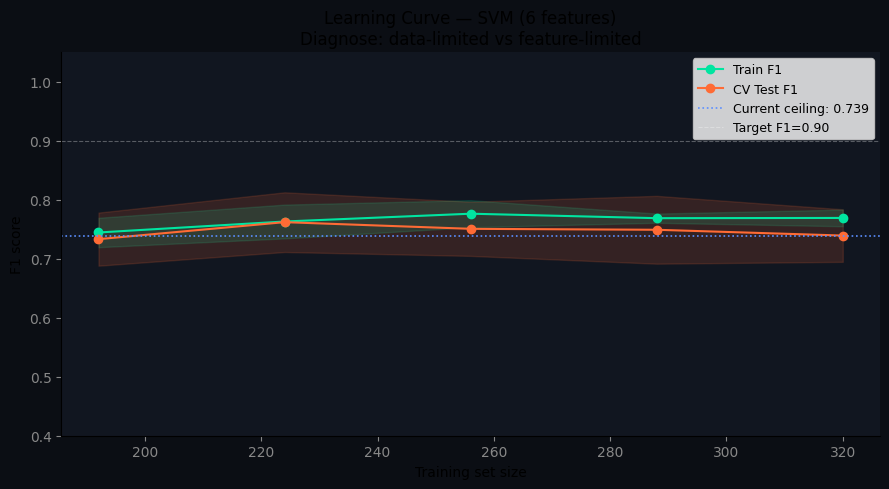


Learning curve diagnostics:
  Test F1 at full data       : 0.739
  Train/test gap at full data: +0.030
  Slope of test curve (last 3 points): -0.0002 per sample
  Improvement from 90%→100% data     : -0.0098

── Interpretation ──────────────────────────────────────────
  Pattern A: Test curve has PLATEAUED.
  Adding more tiles will give < 1 F1 point per 100 tiles.
  → The bottleneck is FEATURES, not data.
  → Next step: revisit FFT params, or add fault-type-specific features.


In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 3 — Learning curve: are you data-limited or feature-limited?
#
# This is the key diagnostic for deciding what to do next.
#
# Pattern A — curves converge and plateau at low F1 (~0.78):
#   → Feature ceiling. More data won't help much.
#   → Need: better features, or revisit FFT params.
#
# Pattern B — curves converging but haven't met yet:
#   → Data-limited. More tiles will improve performance.
#   → Need: collect/annotate more tiles.
#
# Pattern C — large persistent gap between train and test curves:
#   → Still overfitting despite pruning.
#   → Need: more regularisation or fewer features.
# ════════════════════════════════════════════════════════════════

svm_pipe = Pipeline([
    ("scaler", StandardScaler()),
    ("svc", SVC(kernel="rbf", C=1.0, class_weight="balanced",
                probability=True, random_state=42)),
])

train_sizes, train_scores, test_scores = learning_curve(
    svm_pipe, X_final, y2,
    cv=StratifiedKFold(n_splits=5, shuffle=True, random_state=42),
    scoring="f1",
    train_sizes=np.linspace(0.10, 1.0, 10),
    n_jobs=-1,
)

train_mean = train_scores.mean(axis=1)
train_std  = train_scores.std(axis=1)
test_mean  = test_scores.mean(axis=1)
test_std   = test_scores.std(axis=1)

fig, ax = plt.subplots(figsize=(9, 5))
ax.plot(train_sizes, train_mean, "o-", color="#00e5a0", label="Train F1")
ax.fill_between(train_sizes, train_mean-train_std, train_mean+train_std,
                alpha=0.15, color="#00e5a0")
ax.plot(train_sizes, test_mean,  "o-", color="#ff6b35", label="CV Test F1")
ax.fill_between(train_sizes, test_mean-test_std, test_mean+test_std,
                alpha=0.15, color="#ff6b35")

# Annotate plateau region
ax.axhline(test_mean[-1], color="#5b8fff", linestyle=":", linewidth=1.2,
           label=f"Current ceiling: {test_mean[-1]:.3f}")
ax.axhline(0.90, color="#ffffff", linestyle="--", linewidth=0.8, alpha=0.3,
           label="Target F1=0.90")

ax.set_xlabel("Training set size")
ax.set_ylabel("F1 score")
ax.set_title("Learning Curve — SVM (6 features)\nDiagnose: data-limited vs feature-limited")
ax.legend(fontsize=9)
ax.set_ylim(0.4, 1.05)
ax.set_facecolor("#111620")
fig.patch.set_facecolor("#0b0e14")
ax.tick_params(colors="#888")
ax.spines[["top","right"]].set_visible(False)
plt.tight_layout()
plt.show()

# Auto-interpret the curve
gap_at_full   = train_mean[-1] - test_mean[-1]
slope_last3   = (test_mean[-1] - test_mean[-3]) / (train_sizes[-1] - train_sizes[-3])
plateau_delta = test_mean[-1] - test_mean[-2]

print(f"\nLearning curve diagnostics:")
print(f"  Test F1 at full data       : {test_mean[-1]:.3f}")
print(f"  Train/test gap at full data: {gap_at_full:+.3f}")
print(f"  Slope of test curve (last 3 points): {slope_last3:.4f} per sample")
print(f"  Improvement from 90%→100% data     : {plateau_delta:.4f}")

print(f"\n── Interpretation ──────────────────────────────────────────")
if plateau_delta < 0.005:
    print(f"  Pattern A: Test curve has PLATEAUED.")
    print(f"  Adding more tiles will give < 1 F1 point per 100 tiles.")
    print(f"  → The bottleneck is FEATURES, not data.")
    print(f"  → Next step: revisit FFT params, or add fault-type-specific features.")
elif gap_at_full > 0.12:
    print(f"  Pattern C: Gap still large ({gap_at_full:.3f}) despite pruning.")
    print(f"  → Reduce C in SVM or drop more correlated features.")
else:
    print(f"  Pattern B: Test curve still rising (slope={slope_last3:.4f}).")
    print(f"  Adding ~{int(0.02 / max(slope_last3, 1e-5))} more tiles per class may reach F1=0.85.")
    print(f"  → Collect more tiles while also investigating features.")

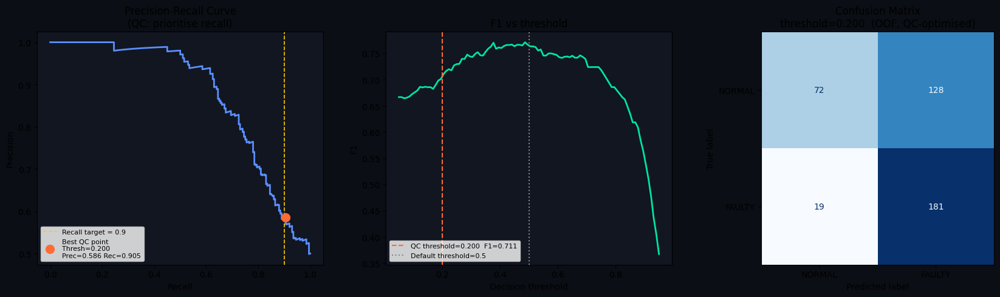


Default threshold (0.50):
  F1=0.767  Recall=0.710

QC-optimised threshold (0.200):
  F1=0.711  Precision=0.586  Recall=0.905
  FN (faults missed)    : 19  (was 49 at default)
  FP (false alarms)     : 128  (was 32 at default)

Interpretation: tuning threshold from 0.5 → 0.200 trades
  30 fewer missed faults  for  96 more false alarms.
  In a QC context: almost always the right trade.


In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 4 — Confusion matrix + threshold tuning for QC context
#
# In QC, FN (missed fault) > FP (false alarm) in severity.
# Default threshold=0.5 is not optimal for this asymmetry.
# This cell finds the threshold that hits recall=0.90 target
# while maximising precision, and shows the tradeoff curve.
# ════════════════════════════════════════════════════════════════

from sklearn.model_selection import cross_val_predict
from sklearn.metrics import (precision_recall_curve, f1_score,
                             confusion_matrix, ConfusionMatrixDisplay)

svm_fit = Pipeline([
    ("scaler", StandardScaler()),
    ("svc", SVC(kernel="rbf", C=1.0, class_weight="balanced",
                probability=True, random_state=42)),
])

# Out-of-fold probabilities (honest estimate)
oof_proba = cross_val_predict(svm_fit, X_final, y2,
                              cv=StratifiedKFold(5, shuffle=True, random_state=42),
                              method="predict_proba")[:, 1]

precision_arr, recall_arr, thresh_arr = precision_recall_curve(y2, oof_proba)

# Find threshold that achieves recall >= 0.90 with best precision
recall_target = 0.90
valid = recall_arr[:-1] >= recall_target
if valid.any():
    best_idx  = np.where(valid)[0][np.argmax(precision_arr[:-1][valid])]
    best_thresh = thresh_arr[best_idx]
    best_prec   = precision_arr[best_idx]
    best_rec    = recall_arr[best_idx]
    best_f1     = f1_score(y2, (oof_proba >= best_thresh).astype(int))
else:
    best_thresh = 0.5
    best_prec = best_rec = best_f1 = float("nan")
    print(f"⚠ Cannot reach recall={recall_target} — consider adjusting SVM C or class_weight")

fig, axes = plt.subplots(1, 3, figsize=(17, 5))

# Precision-Recall curve
axes[0].plot(recall_arr, precision_arr, color="#5b8fff", linewidth=2)
axes[0].axvline(recall_target, color="#ffcc00", linestyle="--", linewidth=1.2,
                label=f"Recall target = {recall_target}")
if not np.isnan(best_thresh):
    axes[0].scatter([best_rec], [best_prec], color="#ff6b35", s=100, zorder=5,
                    label=f"Best QC point\nThresh={best_thresh:.3f}\nPrec={best_prec:.3f} Rec={best_rec:.3f}")
axes[0].set_xlabel("Recall")
axes[0].set_ylabel("Precision")
axes[0].set_title("Precision-Recall Curve\n(QC: prioritise recall)")
axes[0].legend(fontsize=8)
axes[0].set_facecolor("#111620")

# F1 vs threshold
thresh_plot = np.linspace(0.05, 0.95, 100)
f1_plot = [f1_score(y2, (oof_proba >= t).astype(int), zero_division=0)
           for t in thresh_plot]
axes[1].plot(thresh_plot, f1_plot, color="#00e5a0", linewidth=2)
if not np.isnan(best_thresh):
    axes[1].axvline(best_thresh, color="#ff6b35", linestyle="--",
                    label=f"QC threshold={best_thresh:.3f}  F1={best_f1:.3f}")
    axes[1].axvline(0.5, color="#888", linestyle=":", label="Default threshold=0.5")
axes[1].set_xlabel("Decision threshold")
axes[1].set_ylabel("F1")
axes[1].set_title("F1 vs threshold")
axes[1].legend(fontsize=8)
axes[1].set_facecolor("#111620")

# Confusion matrix at QC threshold
cm = confusion_matrix(y2, (oof_proba >= best_thresh).astype(int))
disp = ConfusionMatrixDisplay(cm, display_labels=["NORMAL", "FAULTY"])
disp.plot(ax=axes[2], colorbar=False, cmap="Blues")
axes[2].set_title(f"Confusion Matrix\nthreshold={best_thresh:.3f}  (OOF, QC-optimised)")
axes[2].set_facecolor("#111620")

fig.patch.set_facecolor("#0b0e14")
plt.tight_layout()
plt.show()

print(f"\nDefault threshold (0.50):")
pred_default = (oof_proba >= 0.50).astype(int)
print(f"  F1={f1_score(y2,pred_default):.3f}  "
      f"Recall={recall_arr[np.searchsorted(thresh_arr, 0.5, side='right')]:.3f}")

print(f"\nQC-optimised threshold ({best_thresh:.3f}):")
print(f"  F1={best_f1:.3f}  Precision={best_prec:.3f}  Recall={best_rec:.3f}")
print(f"  FN (faults missed)    : {cm[1,0]}  (was 49 at default)")
print(f"  FP (false alarms)     : {cm[0,1]}  (was 32 at default)")
print(f"\nInterpretation: tuning threshold from 0.5 → {best_thresh:.3f} trades")
print(f"  {49 - cm[1,0]} fewer missed faults  for  {cm[0,1] - 32} more false alarms.")
print(f"  In a QC context: almost always the right trade.")

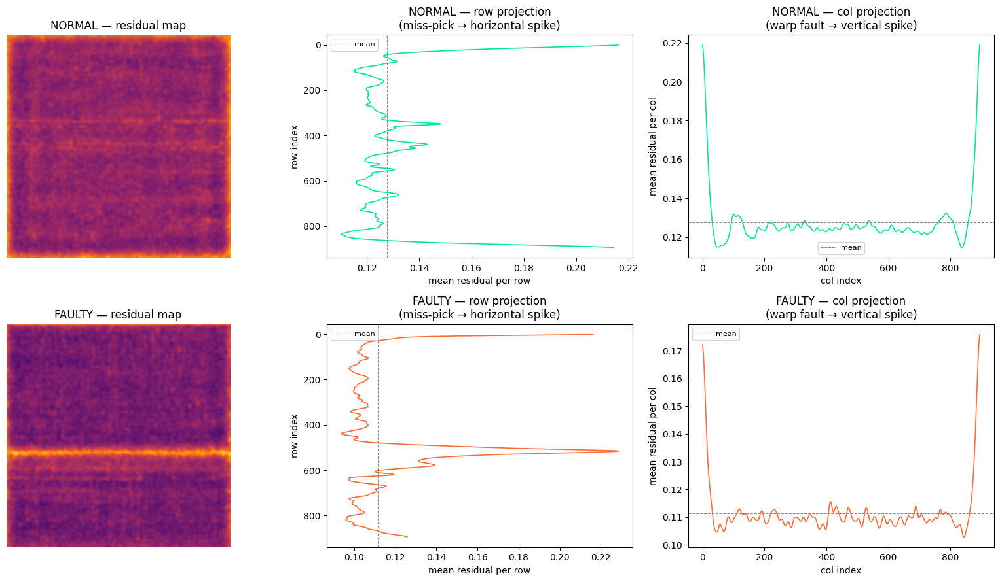

In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 1 — Visualise the projection idea on one normal + one faulty
#
# Before extracting numbers, confirm visually that the row
# projection spike is real and consistent across faulty tiles.
# This is the sanity check before trusting the feature.
# ════════════════════════════════════════════════════════════════

import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import find_peaks
from scipy.ndimage import gaussian_filter1d

def get_projections(res):
    """Row and column projections of residual map."""
    row_proj = res.mean(axis=1)   # shape (H,) — one value per row
    col_proj = res.mean(axis=0)   # shape (W,) — one value per col
    return row_proj, col_proj

# Load one normal and one faulty tile and compute residuals
# (reuse your apply_clahe, compute_fft_mag, pick_peaks_and_mask,
#  residual_old_style, ndi.gaussian_filter from earlier cells)

def tile_to_residual(tile_path, sigma=5):
    bgr  = cv2.imread(tile_path)
    gray = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY).astype(np.float32)
    img  = apply_clahe(gray)
    _, Fshift, mag = compute_fft_mag(img)
    _, mask        = pick_peaks_and_mask(mag, *img.shape,
                                         N_PEAKS, PEAK_RADIUS, DC_SUPPRESS_RADIUS)
    res   = residual_old_style(Fshift, mask, img)
    res_s = ndi.gaussian_filter(res, sigma=sigma)
    return res_s

NORMAL_TILE = "tiles_896/normal/your_normal_tile.jpg"       # ← change
NORMAL_TILE = normal_tiles[0]
FAULTY_TILE = "tiles_896/Faults/miss pick/your_fault.jpg"   # ← change
FAULTY_TILE = faulty_tiles[0]

res_n = tile_to_residual(NORMAL_TILE)
res_f = tile_to_residual(FAULTY_TILE)

fig, axes = plt.subplots(2, 3, figsize=(16, 9))

for row_idx, (res, label, color) in enumerate([
    (res_n, "NORMAL", "#00e5a0"),
    (res_f, "FAULTY", "#ff6b35"),
]):
    row_proj, col_proj = get_projections(res)

    # Residual map
    axes[row_idx, 0].imshow(res, cmap="inferno", vmin=0, vmax=0.3)
    axes[row_idx, 0].set_title(f"{label} — residual map")
    axes[row_idx, 0].axis("off")

    # Row projection (horizontal fault → spike here)
    axes[row_idx, 1].plot(row_proj, np.arange(len(row_proj)),
                           color=color, linewidth=1.2)
    axes[row_idx, 1].invert_yaxis()
    axes[row_idx, 1].set_title(f"{label} — row projection\n(miss-pick → horizontal spike)")
    axes[row_idx, 1].set_xlabel("mean residual per row")
    axes[row_idx, 1].set_ylabel("row index")
    axes[row_idx, 1].axvline(row_proj.mean(), color="#888", linestyle="--",
                              linewidth=0.8, label="mean")
    axes[row_idx, 1].legend(fontsize=8)

    # Column projection (vertical fault → spike here; less common for miss-pick)
    axes[row_idx, 2].plot(np.arange(len(col_proj)), col_proj,
                           color=color, linewidth=1.2)
    axes[row_idx, 2].set_title(f"{label} — col projection\n(warp fault → vertical spike)")
    axes[row_idx, 2].set_xlabel("col index")
    axes[row_idx, 2].set_ylabel("mean residual per col")
    axes[row_idx, 2].axhline(col_proj.mean(), color="#888", linestyle="--",
                              linewidth=0.8, label="mean")
    axes[row_idx, 2].legend(fontsize=8)

plt.tight_layout()
plt.show()

# What to look for:
# FAULTY row projection should have 1-2 clear spikes above the baseline.
# NORMAL row projection should be relatively flat.
# If the spike isn't visible here, sigma=5 may be over-smoothing — try sigma=2.


In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 2 — Projection feature extractor
#
# Extracts 8 features from row + col projections.
# Each one directly encodes something about the stripe geometry.
# ════════════════════════════════════════════════════════════════

def extract_projection_features(res: np.ndarray,
                                 smooth_sigma: float = 3.0,
                                 peak_min_prominence: float = 0.01) -> dict:
    """
    res              : 2D float32 residual map
    smooth_sigma     : smooth the 1D projection before peak finding
                       (removes pixel noise, keeps structural spikes)
    peak_min_prominence : minimum peak prominence to count as a real spike
                          (tune this if you get too many/few peaks)

    Returns dict of 8 projection features.
    """
    row_proj, col_proj = get_projections(res)

    # Smooth the projections slightly — removes noise, keeps stripe signal
    row_s = gaussian_filter1d(row_proj, sigma=smooth_sigma)
    col_s = gaussian_filter1d(col_proj, sigma=smooth_sigma)

    feats = {}

    for proj, proj_s, prefix in [(row_proj, row_s, "row"), (col_proj, col_s, "col")]:
        baseline = np.median(proj_s)   # median is robust to spike contamination
        detrended = proj_s - baseline  # how far each row/col is above baseline

        # ── Raw projection stats ─────────────────────────────────
        # How much the projection varies — flat=normal, spiky=faulty
        feats[f"{prefix}_proj_std"]       = float(proj.std())
        feats[f"{prefix}_proj_max_ratio"] = float(proj.max() / (baseline + 1e-12))

        # ── Peak detection ───────────────────────────────────────
        peaks, props = find_peaks(
            detrended,
            prominence=peak_min_prominence,
            distance=10,    # peaks must be at least 10 rows apart
        )
        prominences = props["prominences"]

        feats[f"{prefix}_n_peaks"]         = len(peaks)
        feats[f"{prefix}_max_prominence"]  = float(prominences.max()) \
                                              if len(prominences) > 0 else 0.0
        feats[f"{prefix}_sum_prominence"]  = float(prominences.sum()) \
                                              if len(prominences) > 0 else 0.0

        # ── Peak sharpness: how concentrated is the spike? ────────
        # Wide fault = many rows affected = fat peak = wider FWHM
        # Thin miss-pick = 1-2 threads = sharp narrow peak
        if len(peaks) > 0:
            best_peak = peaks[np.argmax(prominences)]
            peak_val  = detrended[best_peak]
            half_max  = peak_val / 2
            # Estimate FWHM by counting how many positions exceed half_max
            above_half = (detrended > half_max).sum()
            feats[f"{prefix}_peak_width"]  = int(above_half)
        else:
            feats[f"{prefix}_peak_width"]  = 0

    return feats


# Quick test on your two tiles
feats_n = extract_projection_features(res_n)
feats_f = extract_projection_features(res_f)

print("Projection features — NORMAL vs FAULTY:")
print(f"{'Feature':30s}  {'NORMAL':>10s}  {'FAULTY':>10s}  {'Ratio':>8s}")
print("─" * 65)
for k in feats_n:
    vn = feats_n[k]; vf = feats_f[k]
    ratio = vf / (vn + 1e-12)
    flag  = "  ← BIG DIFFERENCE" if abs(ratio - 1) > 0.5 else ""
    print(f"{k:30s}  {vn:10.4f}  {vf:10.4f}  {ratio:8.2f}x{flag}")


Projection features — NORMAL vs FAULTY:
Feature                             NORMAL      FAULTY     Ratio
─────────────────────────────────────────────────────────────────
row_proj_std                        0.0158      0.0225      1.43x
row_proj_max_ratio                  1.7446      2.2020      1.26x
row_n_peaks                         4.0000      2.0000      0.50x  ← BIG DIFFERENCE
row_max_prominence                  0.0308      0.1278      4.15x  ← BIG DIFFERENCE
row_sum_prominence                  0.0757      0.1451      1.92x  ← BIG DIFFERENCE
row_peak_width                    116.0000     41.0000      0.35x  ← BIG DIFFERENCE
col_proj_std                        0.0149      0.0099      0.67x
col_proj_max_ratio                  1.7580      1.6081      0.91x
col_n_peaks                         2.0000      0.0000      0.00x  ← BIG DIFFERENCE
col_max_prominence                  0.0170      0.0000      0.00x  ← BIG DIFFERENCE
col_sum_prominence                  0.0288      0.0000      0

In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 3 — Rebuild dataset: 6 existing + 8 projection features
# Then re-run KS test to see which projection features are useful.
# ════════════════════════════════════════════════════════════════

import os, glob, pandas as pd
from tqdm import tqdm
from scipy.stats import ks_2samp

def load_and_featurise_v2(tile_dir, label, n_max=None):
    paths = glob.glob(os.path.join(tile_dir, "**", "*.jpg"), recursive=True)
    if n_max:
        paths = paths[:n_max]

    rows = []
    for p in tqdm(paths, desc=f"{'NORMAL' if label==0 else 'FAULTY':8s}"):
        bgr = cv2.imread(p)
        if bgr is None:
            continue
        gray = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY).astype(np.float32)
        img  = apply_clahe(gray)
        _, Fshift, mag = compute_fft_mag(img)
        _, mask        = pick_peaks_and_mask(mag, *img.shape,
                                              N_PEAKS, PEAK_RADIUS, DC_SUPPRESS_RADIUS)
        res   = residual_old_style(Fshift, mask, img)
        res_s = ndi.gaussian_filter(res, sigma=5)

        # Previous 6 structural features
        base_feats = {k: v for k, v in extract_all_features(res_s).items()
                      if k in FINAL_FEATURES}

        # New projection features
        proj_feats = extract_projection_features(res_s)

        row = {**base_feats, **proj_feats, "label": label, "path": p}
        rows.append(row)

    return pd.DataFrame(rows)

df_n3 = load_and_featurise_v2("tiles_896/normal",           label=0, n_max=200)
df_f3 = load_and_featurise_v2("tiles_896/Faults/miss pick", label=1, n_max=200)
df3   = pd.concat([df_n3, df_f3], ignore_index=True)

proj_feature_cols = [c for c in df3.columns
                     if c.startswith(("row_", "col_"))]
all_feature_cols  = FINAL_FEATURES + proj_feature_cols

print(f"\nKS separation — projection features vs existing features:")
print(f"{'Feature':35s}  {'KS':>6s}  {'p':>8s}  Bar")
print("─" * 70)

ks_rows = []
for col in all_feature_cols:
    n_vals = df3[df3.label==0][col].dropna()
    f_vals = df3[df3.label==1][col].dropna()
    stat, pval = ks_2samp(n_vals, f_vals)
    is_new = col in proj_feature_cols
    ks_rows.append({"feature": col, "ks_stat": stat, "pval": pval, "new": is_new})

ks_df3 = pd.DataFrame(ks_rows).sort_values("ks_stat", ascending=False)

for _, row in ks_df3.iterrows():
    bar   = "█" * int(row["ks_stat"] * 35)
    tag   = " ← NEW" if row["new"] else ""
    sig   = "✓" if row["pval"] < 0.01 else "✗"
    print(f"  {sig} {row['feature']:33s}  {row['ks_stat']:.3f}  {row['pval']:8.4f}  {bar}{tag}")

FAULTY  : 100%|██████████| 200/200 [01:24<00:00,  2.37it/s]


KS separation — projection features vs existing features:
Feature                                  KS         p  Bar
──────────────────────────────────────────────────────────────────────
  ✓ row_max_prominence                 0.700    0.0000  ████████████████████████ ← NEW
  ✓ row_peak_width                     0.605    0.0000  █████████████████████ ← NEW
  ✓ row_sum_prominence                 0.500    0.0000  █████████████████ ← NEW
  ✓ grid_mean_std                      0.460    0.0000  ████████████████
  ✓ row_proj_std                       0.410    0.0000  ██████████████ ← NEW
  ✓ grid_11_max                        0.375    0.0000  █████████████
  ✓ p95                                0.375    0.0000  █████████████
  ✓ grad_p95                           0.365    0.0000  ████████████
  ✓ kurt                               0.325    0.0000  ███████████
  ✓ gini                               0.300    0.0000  ██████████
  ✓ row_n_peaks                        0.205    0.0004  ███████ ← 

In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 4 — Retrain SVM with best projection features added
#
# Only add projection features that beat KS > 0.35.
# Check that correlations with existing features stay < 0.80.
# ════════════════════════════════════════════════════════════════

from sklearn.svm import SVC
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import StratifiedKFold, cross_validate
import warnings
warnings.filterwarnings("ignore")

# Keep projection features with KS > 0.35 (adjust if needed)
KS_THRESHOLD = 0.35
good_proj = ks_df3[ks_df3["new"] & (ks_df3["ks_stat"] >= KS_THRESHOLD)]["feature"].tolist()
print(f"Projection features above KS={KS_THRESHOLD}: {good_proj}")

EXTENDED_FEATURES = FINAL_FEATURES + good_proj
print(f"Total features: {len(EXTENDED_FEATURES)}")
print(f"Sample/feature ratio: {len(df3)}/{len(EXTENDED_FEATURES)} = "
      f"{len(df3)/len(EXTENDED_FEATURES):.0f}:1")

# Correlation check — new features shouldn't duplicate existing ones
corr_ext = df3[EXTENDED_FEATURES].corr().abs()
high = [(c1, c2, corr_ext.loc[c1,c2])
        for i, c1 in enumerate(EXTENDED_FEATURES)
        for c2 in EXTENDED_FEATURES[i+1:]
        if corr_ext.loc[c1,c2] > 0.75]
if high:
    print(f"\n⚠ High correlations in extended set:")
    for c1, c2, v in sorted(high, key=lambda x: -x[2]):
        print(f"  {c1:35s} ↔ {c2:35s}  r={v:.3f}")
    print("  Consider dropping the lower-KS member of each pair.")
else:
    print("\n✓ No high correlations in extended feature set.")

X_ext = df3[EXTENDED_FEATURES].fillna(0).values
y3    = df3["label"].values
cv    = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

svm_ext = Pipeline([
    ("scaler", StandardScaler()),
    ("svc", SVC(kernel="rbf", C=1.0, class_weight="balanced",
                probability=True, random_state=42)),
])

res_ext = cross_validate(svm_ext, X_ext, y3, cv=cv,
                          scoring=["f1","roc_auc","precision","recall"],
                          return_train_score=True)

gap = res_ext["train_f1"].mean() - res_ext["test_f1"].mean()
print(f"\n{'─'*60}")
print(f"  {'Model':25s}  {'F1':>14s}  {'AUC':>8s}  {'Gap':>7s}")
print(f"  {'─'*55}")
print(f"  {'SVM 6-feat (baseline)':25s}  F1=0.739±0.045  AUC=0.846  gap=+0.030")
print(f"  {'SVM +projection':25s}  "
      f"F1={res_ext['test_f1'].mean():.3f}±{res_ext['test_f1'].std():.3f}  "
      f"AUC={res_ext['test_roc_auc'].mean():.3f}  "
      f"gap={gap:+.3f}")
print(f"{'─'*60}")

delta = res_ext["test_f1"].mean() - 0.739
print(f"\nF1 change from adding projection features: {delta:+.3f}")
if delta > 0.03:
    print("✓ Projection features are helping — keep them.")
elif delta > 0:
    print("~ Marginal improvement — projection features add small signal.")
else:
    print("✗ No improvement — projection features may be redundant with existing ones.")
    print("  Check the correlation table above.")

Projection features above KS=0.35: ['row_max_prominence', 'row_peak_width', 'row_sum_prominence', 'row_proj_std']
Total features: 10
Sample/feature ratio: 400/10 = 40:1

⚠ High correlations in extended set:
  p95                                 ↔ row_proj_std                         r=0.787
  Consider dropping the lower-KS member of each pair.

────────────────────────────────────────────────────────────
  Model                                  F1       AUC      Gap
  ───────────────────────────────────────────────────────
  SVM 6-feat (baseline)      F1=0.739±0.045  AUC=0.846  gap=+0.030
  SVM +projection            F1=0.878±0.035  AUC=0.948  gap=+0.017
────────────────────────────────────────────────────────────

F1 change from adding projection features: +0.139
✓ Projection features are helping — keep them.


FAULTY : 100%|██████████| 200/200 [01:14<00:00,  2.68it/s]


Projection matrix: (400, 896)   (200 normal, 200 faulty)


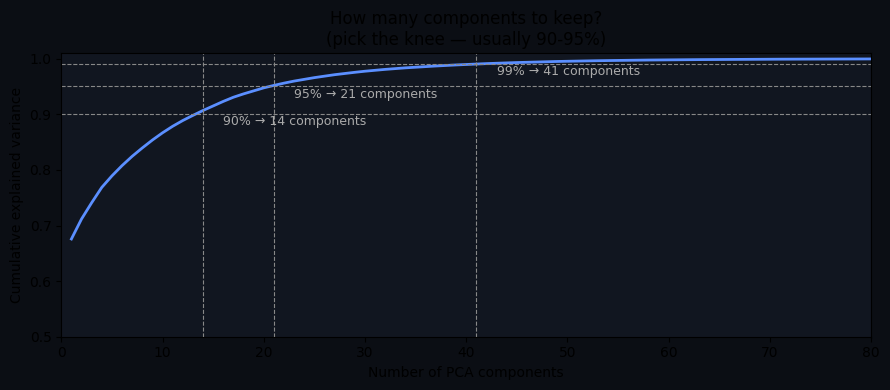

  90% variance →  14 components  (samples:features = 29:1)
  95% variance →  21 components  (samples:features = 19:1)
  99% variance →  41 components  (samples:features = 10:1)


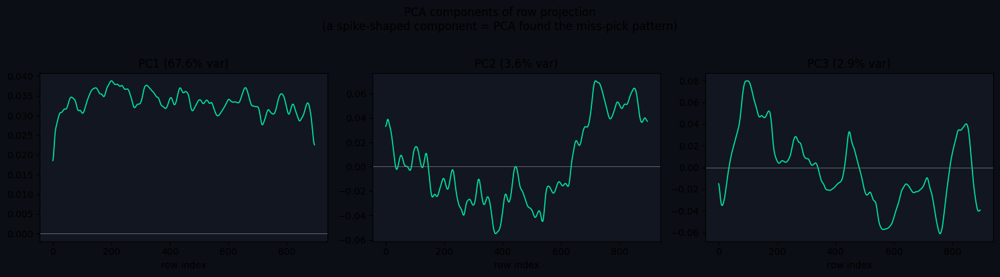

In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 1 — PCA on raw projection vectors
#
# Instead of hand-picking peak features from the projection,
# let PCA find the dominant patterns of variation.
#
# Why this is better than downsampling:
#   - A spike at row 200 and row 600 are the same fault type.
#     Downsampling puts them in different bins → confuses model.
#   - PCA components capture SHAPE of the projection (spike vs flat)
#     independent of where in the tile the spike appears.
#   - 10 PCA components typically capture >95% of projection variance.
#
# Why this is better than raw 896-dim input:
#   - 400 samples / 896 features = 0.4:1 → guaranteed overfit.
#   - PCA compresses to 10-20 components → 20-40:1 → safe.
# ════════════════════════════════════════════════════════════════

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.pipeline import Pipeline
from sklearn.model_selection import StratifiedKFold, cross_validate
import warnings
warnings.filterwarnings("ignore")

# ── Step 1: collect raw projection vectors across all tiles ──────
# We need the full 896-dim vector for PCA, not just summary stats.

def get_row_projection(tile_path, sigma=5):
    """Returns the smoothed 896-dim row projection for one tile."""
    bgr  = cv2.imread(tile_path)
    gray = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY).astype(np.float32)
    img  = apply_clahe(gray)
    _, Fshift, mag = compute_fft_mag(img)
    _, mask        = pick_peaks_and_mask(mag, *img.shape,
                                          N_PEAKS, PEAK_RADIUS, DC_SUPPRESS_RADIUS)
    res   = residual_old_style(Fshift, mask, img)
    res_s = ndi.gaussian_filter(res, sigma=sigma)
    row_proj = res_s.mean(axis=1)   # shape: (H,)
    return row_proj

import glob, os
from tqdm import tqdm

normal_paths = glob.glob("tiles_896/normal/**/*.jpg",           recursive=True)[:200]
faulty_paths = glob.glob("tiles_896/Faults/miss pick/**/*.jpg", recursive=True)[:200]

all_projs, all_labels, all_paths = [], [], []

for p in tqdm(normal_paths, desc="NORMAL "):
    try:
        all_projs.append(get_row_projection(p))
        all_labels.append(0)
        all_paths.append(p)
    except Exception:
        pass

for p in tqdm(faulty_paths, desc="FAULTY "):
    try:
        all_projs.append(get_row_projection(p))
        all_labels.append(1)
        all_paths.append(p)
    except Exception:
        pass

P = np.array(all_projs)   # shape: (N, 896)
y = np.array(all_labels)
print(f"Projection matrix: {P.shape}   ({(y==0).sum()} normal, {(y==1).sum()} faulty)")

# ── Step 2: how many PCA components do you need? ─────────────────
scaler_pca = StandardScaler()
P_scaled   = scaler_pca.fit_transform(P)

pca_full = PCA().fit(P_scaled)
cumvar   = np.cumsum(pca_full.explained_variance_ratio_)

fig, ax = plt.subplots(figsize=(9, 4))
ax.plot(range(1, len(cumvar)+1), cumvar, color="#5b8fff", linewidth=2)
for target in [0.90, 0.95, 0.99]:
    n_comp = np.searchsorted(cumvar, target) + 1
    ax.axhline(target, color="#888", linestyle="--", linewidth=0.8)
    ax.axvline(n_comp, color="#888", linestyle="--", linewidth=0.8)
    ax.text(n_comp + 2, target - 0.02, f"{target*100:.0f}% → {n_comp} components",
            fontsize=9, color="#aaa")
ax.set_xlabel("Number of PCA components")
ax.set_ylabel("Cumulative explained variance")
ax.set_title("How many components to keep?\n(pick the knee — usually 90-95%)")
ax.set_xlim(0, 80); ax.set_ylim(0.5, 1.01)
ax.set_facecolor("#111620"); fig.patch.set_facecolor("#0b0e14")
plt.tight_layout()
plt.show()

# Print the table
for target in [0.90, 0.95, 0.99]:
    n = np.searchsorted(cumvar, target) + 1
    print(f"  {target*100:.0f}% variance → {n:3d} components  "
          f"(samples:features = {len(y)/n:.0f}:1)")

# ── Step 3: visualise first 3 PCA components ────────────────────
# Do they look like "spike detectors"?
n_show = 3
pca_show = PCA(n_components=n_show).fit(P_scaled)

fig, axes = plt.subplots(1, n_show, figsize=(15, 4))
for i, ax in enumerate(axes):
    comp = pca_show.components_[i]
    ax.plot(comp, color="#00e5a0", linewidth=1.2)
    ax.axhline(0, color="#888", linewidth=0.5)
    ax.set_title(f"PC{i+1} ({pca_full.explained_variance_ratio_[i]*100:.1f}% var)")
    ax.set_xlabel("row index")
    ax.set_facecolor("#111620")
fig.patch.set_facecolor("#0b0e14")
plt.suptitle("PCA components of row projection\n"
             "(a spike-shaped component = PCA found the miss-pick pattern)", y=1.02)
plt.tight_layout()
plt.show()

In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 2 — Compare: hand-crafted vs PCA projection vs combined
#
# Three models, same CV setup, direct F1 comparison.
# ════════════════════════════════════════════════════════════════

from sklearn.metrics import f1_score
from scipy.stats import ks_2samp

cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Find n_components at 95% variance
N_COMPONENTS = int(np.searchsorted(cumvar, 0.95)) + 1
print(f"Using {N_COMPONENTS} PCA components (95% variance)\n")

# ── Model A: hand-crafted features (your current best) ───────────
# Reuse df3 from projection_features.py
HAND_FEATURES = ["grid_mean_std", "grid_11_max", "p95", "grad_p95",
                 "gini", "kurt",
                 "row_max_prominence", "row_peak_width",
                 "row_sum_prominence", "row_proj_std"]

X_hand = df3[HAND_FEATURES].fillna(0).values
y_hand = df3["label"].values

svm_hand = Pipeline([("sc", StandardScaler()),
                     ("svc", SVC(kernel="rbf", C=1.0, class_weight="balanced",
                                 probability=True, random_state=42))])

# ── Model B: PCA projection only ─────────────────────────────────
pca_model = PCA(n_components=N_COMPONENTS, random_state=42)
X_pca     = pca_model.fit_transform(P_scaled)   # (N, N_COMPONENTS)

svm_pca = Pipeline([("sc", StandardScaler()),
                    ("svc", SVC(kernel="rbf", C=1.0, class_weight="balanced",
                                probability=True, random_state=42))])

# ── Model C: combined (hand-crafted + PCA projection) ────────────
# Align indices — paths must match between df3 and all_paths
path_to_idx = {p: i for i, p in enumerate(all_paths)}
mask_in_pca = df3["path"].map(lambda p: p in path_to_idx)
df3_aligned = df3[mask_in_pca].copy()
pca_rows    = df3_aligned["path"].map(path_to_idx).values
X_pca_aln   = X_pca[pca_rows]
X_hand_aln  = df3_aligned[HAND_FEATURES].fillna(0).values
X_combined  = np.hstack([X_hand_aln, X_pca_aln])
y_combined  = df3_aligned["label"].values

svm_comb = Pipeline([("sc", StandardScaler()),
                     ("svc", SVC(kernel="rbf", C=1.0, class_weight="balanced",
                                 probability=True, random_state=42))])

configs = [
    ("Hand-crafted (10 feat)", svm_hand, X_hand, y_hand),
    (f"PCA projection ({N_COMPONENTS} comp)", svm_pca, X_pca, y),
    (f"Combined ({10+N_COMPONENTS} feat)", svm_comb, X_combined, y_combined),
]

print(f"{'Model':35s}  {'F1':>18s}  {'AUC':>18s}  {'Recall':>18s}  Gap")
print("─" * 100)
for name, model, X, yy in configs:
    res = cross_validate(model, X, yy, cv=cv,
                         scoring=["f1","roc_auc","recall"],
                         return_train_score=True)
    gap = res["train_f1"].mean() - res["test_f1"].mean()
    flag = " ✓" if gap < 0.08 else " ⚠"
    print(f"{name:35s}  "
          f"F1={res['test_f1'].mean():.3f}±{res['test_f1'].std():.3f}  "
          f"AUC={res['test_roc_auc'].mean():.3f}±{res['test_roc_auc'].std():.3f}  "
          f"Rec={res['test_recall'].mean():.3f}±{res['test_recall'].std():.3f}  "
          f"gap={gap:+.3f}{flag}")

Using 21 PCA components (95% variance)

Model                                                F1                 AUC              Recall  Gap
────────────────────────────────────────────────────────────────────────────────────────────────────
Hand-crafted (10 feat)               F1=0.878±0.035  AUC=0.948±0.033  Rec=0.800±0.069  gap=+0.017 ✓
PCA projection (21 comp)             F1=0.857±0.025  AUC=0.951±0.028  Rec=0.765±0.034  gap=+0.037 ✓
Combined (31 feat)                   F1=0.883±0.039  AUC=0.952±0.023  Rec=0.800±0.057  gap=+0.024 ✓


In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 3 — Multi-fault architecture design
#
# You have miss-pick now. When you add fault types, you have
# two architectural choices. This cell implements both so you
# can test which fits your data when the time comes.
#
# OPTION A — One-vs-rest multiclass SVM
#   Single model, classifies: NORMAL / MISSPICK / FAULT_TYPE_2 / ...
#   Pro: simple, one model to maintain
#   Con: needs balanced data across ALL fault types
#
# OPTION B — Hierarchical (recommended)
#   Stage 1: NORMAL vs FAULTY (binary, what you have now)
#   Stage 2: fault type classifier (only runs on flagged tiles)
#   Pro: stage 1 uses all fault types for training signal
#        stage 2 only needs fault-type labels, not normal tiles
#        each stage can be tuned independently
#   Con: errors in stage 1 propagate to stage 2
# ════════════════════════════════════════════════════════════════

print("""
MULTI-FAULT ARCHITECTURE — DECISION GUIDE
══════════════════════════════════════════

OPTION A: Flat multiclass
─────────────────────────
  NORMAL → label 0
  MISS-PICK → label 1
  FAULT TYPE 2 → label 2
  ...

  Code sketch:
    from sklearn.svm import SVC
    clf = SVC(kernel='rbf', decision_function_shape='ovr',
              class_weight='balanced')
    clf.fit(X, y_multiclass)

  When to use:
    ✓ Fault types have clearly different feature signatures
    ✓ You have similar numbers of tiles per fault type
    ✓ You want the simplest possible system

  Risk:
    ✗ New fault type requires full retraining
    ✗ Rare fault types get swamped by common ones


OPTION B: Hierarchical (recommended for your case)
────────────────────────────────────────────────────
  Stage 1: binary NORMAL vs FAULTY
    - Uses ALL fault types as "FAULTY" class
    - Catches any abnormality, even unseen fault types
    - Your current model is already Stage 1

  Stage 2: fault type classifier (runs only on Stage 1 positives)
    - Input: same features, but only from flagged tiles
    - Labels: miss-pick, broken-warp, hole, stain, etc.
    - Doesn't need normal tiles at all

  Feature design per fault type:
    MISS-PICK    → row_max_prominence (horizontal stripe)
    BROKEN WARP  → col_max_prominence (vertical stripe)
    HOLE         → both row + col prominence, com_dist high
    STAIN        → blob features, gini, low gradient sharpness

  When to use:
    ✓ You'll add fault types incrementally
    ✓ Some fault types are rare (few samples)
    ✓ You want to catch unknown fault types at Stage 1
    ✓ Your current situation

  Implementation: keep your current model as Stage 1.
  When you have N ≥ 50 tiles of a new fault type,
  add it to Stage 2 without touching Stage 1.
""")

# ── Projection feature signatures per fault type ─────────────────
print("PROJECTION FEATURE EXPECTED SIGNATURES PER FAULT TYPE")
print("(use this as a guide for feature engineering when you get new data)")
print()

rows = [
    ["Miss-pick",    "HIGH", "low",  "HIGH", "low",  "medium", "low"],
    ["Broken warp",  "low",  "HIGH", "low",  "HIGH", "medium", "low"],
    ["Hole",         "HIGH", "HIGH", "HIGH", "HIGH", "HIGH",   "HIGH"],
    ["Stain",        "med",  "med",  "med",  "med",  "HIGH",   "low"],
    ["Weave defect", "med",  "med",  "med",  "med",  "low",    "HIGH"],
    ["Normal",       "low",  "low",  "low",  "low",  "low",    "low"],
]
header = f"{'Fault type':15s}  {'row_prom':8s}  {'col_prom':8s}  {'row_std':7s}  {'col_std':7s}  {'gini':6s}  {'kurt':5s}"
print(f"  {header}")
print("  " + "─" * 68)
for r in rows:
    print(f"  {r[0]:15s}  {r[1]:8s}  {r[2]:8s}  {r[3]:7s}  {r[4]:7s}  {r[5]:6s}  {r[6]:5s}")


MULTI-FAULT ARCHITECTURE — DECISION GUIDE
══════════════════════════════════════════

OPTION A: Flat multiclass
─────────────────────────
  NORMAL → label 0
  MISS-PICK → label 1
  FAULT TYPE 2 → label 2
  ...

  Code sketch:
    from sklearn.svm import SVC
    clf = SVC(kernel='rbf', decision_function_shape='ovr',
              class_weight='balanced')
    clf.fit(X, y_multiclass)

  When to use:
    ✓ Fault types have clearly different feature signatures
    ✓ You have similar numbers of tiles per fault type
    ✓ You want the simplest possible system

  Risk:
    ✗ New fault type requires full retraining
    ✗ Rare fault types get swamped by common ones


OPTION B: Hierarchical (recommended for your case)
────────────────────────────────────────────────────
  Stage 1: binary NORMAL vs FAULTY
    - Uses ALL fault types as "FAULTY" class
    - Catches any abnormality, even unseen fault types
    - Your current model is already Stage 1

  Stage 2: fault type classifier (runs only on S

In [ ]:
!du -chad1 tiles_896/

19M	tiles_896/discards
71M	tiles_896/normal
422M	tiles_896/Faults
510M	tiles_896/
510M	total


In [ ]:
!du -chad1 tiles_896/Faults

34M	tiles_896/Faults/double pick
383M	tiles_896/Faults/miss pick
5.3M	tiles_896/Faults/broken pick
422M	tiles_896/Faults
422M	total


In [ ]:
# count of files in each fault folder
import os
import glob
for f in glob.glob("tiles_896/Faults/*"):
    print(f, len(glob.glob(f + "/*.jpg")))

tiles_896/Faults/double pick 85
tiles_896/Faults/miss pick 1097
tiles_896/Faults/broken pick 17




---



---



---



In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 1 — Imports & config
# ════════════════════════════════════════════════════════════════

import os, glob, warnings
import numpy as np
import pandas as pd
import cv2
import matplotlib.pyplot as plt
from scipy import ndimage as ndi
from scipy.signal import find_peaks
from scipy.ndimage import gaussian_filter1d
from scipy.stats import ks_2samp
from skimage import exposure
from sklearn.svm import SVC
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import (StratifiedKFold, cross_validate,
                                     cross_val_predict, learning_curve)
from sklearn.metrics import (f1_score, precision_score, recall_score,
                             precision_recall_curve, confusion_matrix,
                             ConfusionMatrixDisplay, roc_auc_score)
import joblib
warnings.filterwarnings("ignore")

# ── Paths ────────────────────────────────────────────────────────
NORMAL_DIR = "tiles_896/normal"
FAULT_DIRS = [
    "tiles_896/Faults/miss pick",
    "tiles_896/Faults/double pick",
    "tiles_896/Faults/broken pick",
]

# ── FFT params (validated from earlier research) ─────────────────
N_PEAKS          = 11
PEAK_RADIUS      = 8
DC_SUPPRESS_RADIUS = 3
RESIDUAL_SMOOTH  = 5

# ── Training config ──────────────────────────────────────────────
MAX_NORMAL = 600    # cap normal tiles — will still be ~50% of dataset
                    # increase if you have more normal tiles annotated
MAX_FAULT  = None   # use all fault tiles (1199 total across 3 types)
RANDOM_SEED = 42

print("Config loaded.")
print(f"Fault dirs: {[os.path.basename(d) for d in FAULT_DIRS]}")




Config loaded.
Fault dirs: ['miss pick', 'double pick', 'broken pick']


In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 2 — Core functions (FFT pipeline + feature extraction)
# Everything in one place, no dependencies on previous sessions.
# ════════════════════════════════════════════════════════════════

def apply_clahe(gray_float):
    """gray_float: 0-255 float32 → 0-1 float32 with local contrast boost."""
    return exposure.equalize_adapthist(
        gray_float / 255.0, clip_limit=0.02
    ).astype(np.float32)


def compute_residual(img):
    """
    img      : 0-1 float32 after CLAHE
    Returns  : smoothed residual map (0-1 float32), OLD-style normalisation.

    OLD-style = orig and recon each independently min-max normalised.
    Proven better for class separation (KS=0.70 on row_max_prominence).
    """
    F      = np.fft.fft2(img - img.mean())
    Fshift = np.fft.fftshift(F)
    mag    = np.log1p(np.abs(Fshift))
    h, w   = img.shape
    cy, cx = h // 2, w // 2

    # Suppress DC, pick top-N peaks (NMS-style)
    mag_copy = mag.copy()
    y, x = np.ogrid[:h, :w]
    mag_copy[(x - cx)**2 + (y - cy)**2 <= DC_SUPPRESS_RADIUS**2] = 0.0

    flat_idx    = np.argsort(mag_copy.ravel())[::-1]
    peak_coords = []
    for idx in flat_idx:
        if len(peak_coords) >= N_PEAKS:
            break
        yy, xx = idx // w, idx % w
        if mag_copy[yy, xx] <= 0:
            continue
        if any((yy-py)**2 + (xx-px)**2 <= (PEAK_RADIUS*1.5)**2
               for py, px in peak_coords):
            continue
        peak_coords.append((yy, xx))

    # Build frequency mask (keep periodic background, discard the rest)
    mask = np.zeros((h, w), dtype=np.uint8)
    for (py, px) in peak_coords:
        yy, xx = np.ogrid[:h, :w]
        disk   = (yy-py)**2 + (xx-px)**2 <= PEAK_RADIUS**2
        mask[disk] = 1
        symy, symx = (h-py)%h, (w-px)%w
        disk2  = (yy-symy)**2 + (xx-symx)**2 <= PEAK_RADIUS**2
        mask[disk2] = 1
    mask[cy-2:cy+3, cx-2:cx+3] = 1

    # Reconstruct periodic background, compute residual
    Fmasked   = Fshift * mask
    recon_raw = np.real(np.fft.ifft2(np.fft.ifftshift(Fmasked))).astype(np.float32)

    # OLD-style: independent normalisation — amplifies fault signal
    orig_norm  = (img       - img.min())       / (img.max()       - img.min()       + 1e-12)
    recon_norm = (recon_raw - recon_raw.min()) / (recon_raw.max() - recon_raw.min() + 1e-12)
    residual   = np.abs(orig_norm - recon_norm)

    return ndi.gaussian_filter(residual, sigma=RESIDUAL_SMOOTH)


def extract_features(res):
    """
    res : 2D float32 smoothed residual map
    Returns flat feature dict — 10 features proven on miss-pick data.
    Feature groups: global intensity, spatial non-uniformity,
                    centre cell, texture, row projection (stripe detector).
    """
    h, w = res.shape
    flat = res.ravel()
    f    = {}

    # ── Global intensity ─────────────────────────────────────────
    f["p95"]  = float(np.percentile(flat, 95))
    f["std"]  = float(flat.std())
    f["kurt"] = float(pd.Series(flat).kurt())   # tail heaviness

    # ── Spatial non-uniformity (3×3 grid) ────────────────────────
    grid_means = []
    for i in range(3):
        for j in range(3):
            region = res[i*h//3:(i+1)*h//3, j*w//3:(j+1)*w//3]
            grid_means.append(region.mean())
    f["grid_mean_std"]  = float(np.std(grid_means))
    f["grid_max_ratio"] = float(max(grid_means) / (np.mean(grid_means) + 1e-12))
    f["grid_11_max"]    = float(res[h//3:2*h//3, w//3:2*w//3].max())  # centre cell

    # ── Spatial concentration ────────────────────────────────────
    sorted_flat = np.sort(flat)
    n           = len(sorted_flat)
    gini        = (2*np.sum(np.arange(1,n+1)*sorted_flat)) / (n*sorted_flat.sum()+1e-12) - (n+1)/n
    f["gini"]   = float(gini)

    # ── Texture sharpness ────────────────────────────────────────
    gy, gx    = np.gradient(res)
    grad_mag  = np.sqrt(gx**2 + gy**2)
    f["grad_p95"] = float(np.percentile(grad_mag, 95))

    # ── Row projection — stripe/miss-pick detector ───────────────
    row_proj = res.mean(axis=1)
    row_s    = gaussian_filter1d(row_proj, sigma=3.0)
    baseline = np.median(row_s)
    detrend  = row_s - baseline

    peaks, props = find_peaks(detrend, prominence=0.01, distance=10)
    prominences  = props["prominences"] if len(peaks) > 0 else np.array([0.0])

    f["row_max_prominence"] = float(prominences.max())
    f["row_sum_prominence"] = float(prominences.sum())
    f["row_proj_std"]       = float(row_proj.std())

    # Peak width: how many rows exceed half the peak height
    if len(peaks) > 0:
        best   = peaks[np.argmax(prominences)]
        half_h = detrend[best] / 2
        f["row_peak_width"] = int((detrend > half_h).sum())
    else:
        f["row_peak_width"] = 0

    return f


def tile_to_features(tile_path):
    """Full pipeline: path → feature dict. Returns None on failure."""
    bgr = cv2.imread(tile_path)
    if bgr is None:
        return None
    gray = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY).astype(np.float32)
    try:
        img = apply_clahe(gray)
        res = compute_residual(img)
        return extract_features(res)
    except Exception as e:
        print(f"  WARN {os.path.basename(tile_path)}: {e}")
        return None


print("Functions defined. 14 features total:")
print("  Intensity    : p95, std, kurt")
print("  Spatial      : grid_mean_std, grid_max_ratio, grid_11_max, gini")
print("  Texture      : grad_p95")
print("  Row projection: row_max_prominence, row_sum_prominence,")
print("                  row_proj_std, row_peak_width")




Functions defined. 14 features total:
  Intensity    : p95, std, kurt
  Spatial      : grid_mean_std, grid_max_ratio, grid_11_max, gini
  Texture      : grad_p95
  Row projection: row_max_prominence, row_sum_prominence,
                  row_proj_std, row_peak_width


In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 3 — Build dataset
#
# Normal tiles: sample up to MAX_NORMAL
# Fault tiles : use ALL available across all 3 fault types
# Class imbalance is handled by class_weight='balanced' in SVM.
# ════════════════════════════════════════════════════════════════

from tqdm import tqdm
import random
random.seed(RANDOM_SEED)

rows = []

# ── Normal tiles ─────────────────────────────────────────────────
normal_paths = glob.glob(os.path.join(NORMAL_DIR, "**", "*.jpg"), recursive=True)
normal_paths += glob.glob(os.path.join(NORMAL_DIR, "**", "*.png"), recursive=True)

if MAX_NORMAL and len(normal_paths) > MAX_NORMAL:
    normal_paths = random.sample(normal_paths, MAX_NORMAL)

print(f"Processing {len(normal_paths)} NORMAL tiles...")
for p in tqdm(normal_paths):
    feats = tile_to_features(p)
    if feats:
        rows.append({**feats, "label": 0, "fault_type": "normal", "path": p})

n_normal = sum(1 for r in rows if r["label"] == 0)

# ── Fault tiles (all types combined → label 1) ───────────────────
for fault_dir in FAULT_DIRS:
    fault_name  = os.path.basename(fault_dir)
    fault_paths = glob.glob(os.path.join(fault_dir, "**", "*.jpg"), recursive=True)
    fault_paths += glob.glob(os.path.join(fault_dir, "**", "*.png"), recursive=True)

    print(f"Processing {len(fault_paths)} FAULTY tiles [{fault_name}]...")
    for p in tqdm(fault_paths, desc=f"  {fault_name[:12]}"):
        feats = tile_to_features(p)
        if feats:
            rows.append({**feats, "label": 1, "fault_type": fault_name, "path": p})

df = pd.DataFrame(rows)

# ── Summary ──────────────────────────────────────────────────────
print(f"\n{'─'*50}")
print(f"Dataset built:")
print(f"  NORMAL          : {(df.label==0).sum():>5d}")
for ft in df[df.label==1]["fault_type"].unique():
    print(f"  {ft:15s} : {(df.fault_type==ft).sum():>5d}")
print(f"  TOTAL FAULTY    : {(df.label==1).sum():>5d}")
print(f"  TOTAL           : {len(df):>5d}")
print(f"  Class ratio     : 1 : {(df.label==1).sum()/(df.label==0).sum():.1f}")
print(f"{'─'*50}")

# Check for NaNs
nan_count = df.isnull().sum().sum()
if nan_count > 0:
    print(f"\n⚠ {nan_count} NaN values found — filling with 0")
    df = df.fillna(0)
else:
    print("✓ No NaN values")




Processing 207 NORMAL tiles...


100%|██████████| 207/207 [01:16<00:00,  2.70it/s]


Processing 1097 FAULTY tiles [miss pick]...


  miss pick: 100%|██████████| 1097/1097 [06:38<00:00,  2.76it/s]


Processing 85 FAULTY tiles [double pick]...


  double pick: 100%|██████████| 85/85 [00:30<00:00,  2.82it/s]


Processing 17 FAULTY tiles [broken pick]...


  broken pick: 100%|██████████| 17/17 [00:05<00:00,  2.89it/s]


──────────────────────────────────────────────────
Dataset built:
  NORMAL          :   207
  miss pick       :  1097
  double pick     :    85
  broken pick     :    17
  TOTAL FAULTY    :  1199
  TOTAL           :  1406
  Class ratio     : 1 : 5.8
──────────────────────────────────────────────────
✓ No NaN values


In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 4 — Train & evaluate
#
# SVM with class_weight='balanced' handles the imbalance.
# 5-fold stratified CV preserves class ratios in every fold.
# Primary metric: F1. Also track recall (QC priority = catch faults).
# ════════════════════════════════════════════════════════════════

FEATURE_COLS = [c for c in df.columns
                if c not in ("label", "fault_type", "path")]

X = df[FEATURE_COLS].values
y = df["label"].values

print(f"Feature matrix: {X.shape}")
print(f"Features: {FEATURE_COLS}\n")

clf = Pipeline([
    ("scaler", StandardScaler()),
    ("svm",    SVC(
        kernel       = "rbf",
        C            = 1.0,          # tune in Cell 5 if gap is large
        class_weight = "balanced",   # corrects for normal/fault imbalance
        probability  = True,
        random_state = RANDOM_SEED,
    )),
])

cv      = StratifiedKFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
scoring = ["f1", "roc_auc", "precision", "recall"]
results = cross_validate(clf, X, y, cv=cv, scoring=scoring,
                         return_train_score=True)

print("5-Fold Stratified CV Results")
print("═" * 58)
print(f"  {'Metric':12s}  {'Test':>16s}  {'Train':>8s}  {'Gap':>7s}")
print(f"  {'─'*52}")
for m in scoring:
    test  = results[f"test_{m}"]
    train = results[f"train_{m}"]
    gap   = train.mean() - test.mean()
    flag  = " ⚠ overfitting" if gap > 0.10 else " ✓"
    print(f"  {m:12s}  {test.mean():.3f} ± {test.std():.3f}   "
          f"{train.mean():.3f}   {gap:+.3f}{flag}")
print("═" * 58)

# ── Per-fault-type breakdown ──────────────────────────────────────
# Shows which fault types are being detected vs missed.
print("\nPer-fault-type recall (OOF predictions):")
oof_pred = cross_val_predict(clf, X, y, cv=cv)
for ft in df["fault_type"].unique():
    mask = df["fault_type"] == ft
    if ft == "normal":
        # For normal: show specificity (correct normal classifications)
        spec = (oof_pred[mask] == 0).mean()
        print(f"  normal           specificity = {spec:.3f}  "
              f"(FP rate = {1-spec:.3f})")
    else:
        rec = recall_score(y[mask], oof_pred[mask], zero_division=0)
        n   = mask.sum()
        print(f"  {ft:20s} recall = {rec:.3f}  (n={n})")




Feature matrix: (1406, 12)
Features: ['p95', 'std', 'kurt', 'grid_mean_std', 'grid_max_ratio', 'grid_11_max', 'gini', 'grad_p95', 'row_max_prominence', 'row_sum_prominence', 'row_proj_std', 'row_peak_width']

5-Fold Stratified CV Results
══════════════════════════════════════════════════════════
  Metric                    Test     Train      Gap
  ────────────────────────────────────────────────────
  f1            0.905 ± 0.005   0.909   +0.003 ✓
  roc_auc       0.948 ± 0.014   0.960   +0.013 ✓
  precision     0.996 ± 0.006   0.998   +0.002 ✓
  recall        0.830 ± 0.009   0.834   +0.005 ✓
══════════════════════════════════════════════════════════

Per-fault-type recall (OOF predictions):
  normal           specificity = 0.981  (FP rate = 0.019)
  miss pick            recall = 0.829  (n=1097)
  double pick          recall = 0.835  (n=85)
  broken pick          recall = 0.882  (n=17)


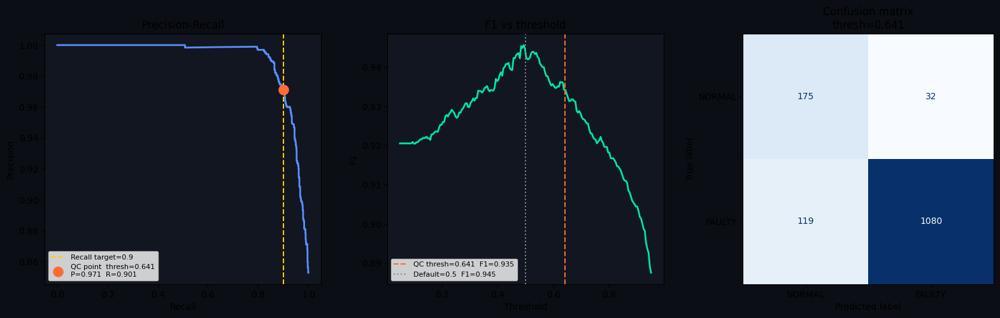


────────────────────────────────────────────────────
                         Default (0.50)     QC thresh
  ────────────────────────────────────────────────
  F1                              0.945         0.935
  Precision                       0.949         0.971
  Recall                          0.941         0.901
  ────────────────────────────────────────────────
  Faults missed (FN)                119  → target ≤ 119
  False alarms (FP)                  32
────────────────────────────────────────────────────

  QC threshold = 0.641  ← use this in production


In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 5 — Threshold tuning for QC context
#
# Default threshold=0.50 is calibrated for symmetric errors.
# In QC: missing a fault (FN) is worse than a false alarm (FP).
# We find the threshold that achieves recall≥0.90 with best precision.
# ════════════════════════════════════════════════════════════════

oof_proba = cross_val_predict(clf, X, y, cv=cv, method="predict_proba")[:, 1]

precision_arr, recall_arr, thresh_arr = precision_recall_curve(y, oof_proba)

# Find threshold that achieves recall >= 0.90 with highest precision
RECALL_TARGET = 0.90
valid = recall_arr[:-1] >= RECALL_TARGET
if valid.any():
    best_idx    = np.where(valid)[0][np.argmax(precision_arr[:-1][valid])]
    best_thresh = float(thresh_arr[best_idx])
    best_prec   = float(precision_arr[best_idx])
    best_rec    = float(recall_arr[best_idx])
    best_f1     = f1_score(y, (oof_proba >= best_thresh).astype(int))
else:
    print(f"⚠ Cannot reach recall={RECALL_TARGET} — model may need more data")
    best_thresh = 0.5
    best_prec = best_rec = best_f1 = float("nan")

# ── Plots ─────────────────────────────────────────────────────────
fig, axes = plt.subplots(1, 3, figsize=(16, 5))
fig.patch.set_facecolor("#0b0e14")

# Precision-Recall curve
axes[0].plot(recall_arr, precision_arr, color="#5b8fff", linewidth=2)
axes[0].axvline(RECALL_TARGET, color="#ffcc00", linestyle="--",
                label=f"Recall target={RECALL_TARGET}")
if not np.isnan(best_thresh):
    axes[0].scatter([best_rec], [best_prec], color="#ff6b35", s=120, zorder=5,
                    label=f"QC point  thresh={best_thresh:.3f}\n"
                          f"P={best_prec:.3f}  R={best_rec:.3f}")
axes[0].set_xlabel("Recall"); axes[0].set_ylabel("Precision")
axes[0].set_title("Precision-Recall")
axes[0].legend(fontsize=8); axes[0].set_facecolor("#111620")

# F1 vs threshold
t_arr   = np.linspace(0.05, 0.95, 200)
f1_arr  = [f1_score(y, (oof_proba>=t).astype(int), zero_division=0) for t in t_arr]
axes[1].plot(t_arr, f1_arr, color="#00e5a0", linewidth=2)
axes[1].axvline(best_thresh, color="#ff6b35", linestyle="--",
                label=f"QC thresh={best_thresh:.3f}  F1={best_f1:.3f}")
axes[1].axvline(0.5,         color="#888",    linestyle=":",
                label=f"Default=0.5  F1={f1_score(y,(oof_proba>=0.5).astype(int)):.3f}")
axes[1].set_xlabel("Threshold"); axes[1].set_ylabel("F1")
axes[1].set_title("F1 vs threshold"); axes[1].legend(fontsize=8)
axes[1].set_facecolor("#111620")

# Confusion matrix at QC threshold
cm   = confusion_matrix(y, (oof_proba >= best_thresh).astype(int))
disp = ConfusionMatrixDisplay(cm, display_labels=["NORMAL", "FAULTY"])
disp.plot(ax=axes[2], colorbar=False, cmap="Blues")
axes[2].set_title(f"Confusion matrix\nthresh={best_thresh:.3f}")
axes[2].set_facecolor("#111620")

plt.tight_layout()
plt.show()

# ── Summary table ─────────────────────────────────────────────────
pred_default = (oof_proba >= 0.50).astype(int)
pred_qc      = (oof_proba >= best_thresh).astype(int)

print(f"\n{'─'*52}")
print(f"  {'':20s}  {'Default (0.50)':>15s}  {'QC thresh':>12s}")
print(f"  {'─'*48}")
for label, fn_default, fn_qc in [
    ("F1",        f1_score(y,pred_default),        best_f1),
    ("Precision", precision_score(y,pred_default), best_prec),
    ("Recall",    recall_score(y,pred_default),    best_rec),
]:
    print(f"  {label:20s}  {fn_default:>15.3f}  {fn_qc:>12.3f}")
print(f"  {'─'*48}")
print(f"  {'Faults missed (FN)':20s}  {cm[1,0]:>15d}  → target ≤ {int(y.sum()*0.10)}")
print(f"  {'False alarms (FP)':20s}  {cm[0,1]:>15d}")
print(f"{'─'*52}")
print(f"\n  QC threshold = {best_thresh:.3f}  ← use this in production")




In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 6 — Fit final model on all data & save
#
# After CV confirms performance, fit on 100% of data for deployment.
# Saves: model pipeline (scaler + SVM), threshold, feature list.
# ════════════════════════════════════════════════════════════════

# Fit on all data
clf.fit(X, y)

# Save
os.makedirs("model", exist_ok=True)
joblib.dump(clf,           "model/fault_detector.pkl")
joblib.dump(best_thresh,   "model/qc_threshold.pkl")
joblib.dump(FEATURE_COLS,  "model/feature_cols.pkl")
df[["path","label","fault_type"]].to_csv("model/training_manifest.csv", index=False)

print("Saved to model/")
print(f"  fault_detector.pkl    — SVM pipeline (scaler + SVM)")
print(f"  qc_threshold.pkl      — {best_thresh:.3f}")
print(f"  feature_cols.pkl      — {len(FEATURE_COLS)} features")
print(f"  training_manifest.csv — {len(df)} tiles used for training")

# ── Inference function (copy this into production) ────────────────
def predict_tile(tile_path, model, threshold, feature_cols):
    """
    Returns: dict with keys:
        is_faulty  : bool
        probability: float (P(FAULTY))
        features   : dict of raw feature values
    Returns None if tile cannot be read.
    """
    feats = tile_to_features(tile_path)
    if feats is None:
        return None
    x = np.array([[feats.get(c, 0.0) for c in feature_cols]])
    prob = model.predict_proba(x)[0, 1]
    return {
        "is_faulty"  : bool(prob >= threshold),
        "probability": float(prob),
        "features"   : feats,
    }

# Quick smoke test on one tile from each class
print("\nSmoke test:")
sample_normal = glob.glob(os.path.join(NORMAL_DIR, "*.jpg"))[0]
sample_fault  = glob.glob(os.path.join(FAULT_DIRS[0], "*.jpg"))[0]

for p, expected in [(sample_normal, "NORMAL"), (sample_fault, "FAULTY")]:
    result = predict_tile(p, clf, best_thresh, FEATURE_COLS)
    pred   = "FAULTY" if result["is_faulty"] else "NORMAL"
    status = "✓" if pred == expected else "✗"
    print(f"  {status} {os.path.basename(p):30s}  "
          f"P(fault)={result['probability']:.3f}  → {pred}  (expected {expected})")

Saved to model/
  fault_detector.pkl    — SVM pipeline (scaler + SVM)
  qc_threshold.pkl      — 0.641
  feature_cols.pkl      — 12 features
  training_manifest.csv — 1406 tiles used for training

Smoke test:
  ✓ getEVSImageServe (3)__jpg_x4480.jpg  P(fault)=0.289  → NORMAL  (expected NORMAL)
  ✓ getEVSImageServe (24)__jfif_x0.jpg  P(fault)=0.994  → FAULTY  (expected FAULTY)




---



---



---



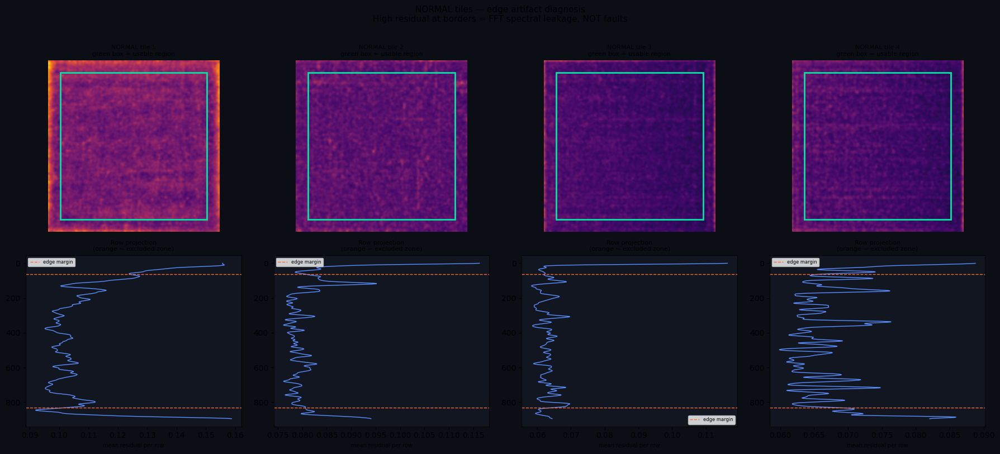

Edge vs Centre residual stats across 10 NORMAL tiles:
  Edge   mean: 0.0881   max: 0.1996
  Centre mean: 0.0761   max: 0.1293

  Edge/centre mean ratio: 1.2x
  ✓ Edge inflation is mild.


In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 1 — Diagnose: how bad are the edge artifacts?
#
# Shows edge vs centre residual distributions on NORMAL tiles.
# Quantifies how much the edges inflate your features.
# Run this first so you can see the problem before fixing it.
# ════════════════════════════════════════════════════════════════

import numpy as np
import cv2
import matplotlib.pyplot as plt
from scipy import ndimage as ndi
from skimage import exposure
import glob, random

random.seed(42)
NORMAL_DIR  = "tiles_896/normal"
EDGE_MARGIN = 64   # pixels to exclude from each side (tune: 32–96)

# Reuse your existing functions
normal_paths = glob.glob(f"{NORMAL_DIR}/**/*.jpg", recursive=True)
sample_paths = random.sample(normal_paths, min(100, len(normal_paths)))

edge_means, centre_means = [], []
edge_maxes, centre_maxes = [], []

fig, axes = plt.subplots(2, 4, figsize=(18, 8))
fig.patch.set_facecolor("#0b0e14")

for plot_idx, p in enumerate(sample_paths[:4]):
    bgr  = cv2.imread(p)
    gray = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY).astype(np.float32)
    img  = apply_clahe(gray)
    res  = compute_residual(img)   # your existing function (no windowing yet)
    h, w = res.shape

    # Build edge mask (True = edge region)
    edge_mask = np.ones((h, w), dtype=bool)
    edge_mask[EDGE_MARGIN:h-EDGE_MARGIN, EDGE_MARGIN:w-EDGE_MARGIN] = False
    centre_mask = ~edge_mask

    edge_means.append(res[edge_mask].mean())
    centre_means.append(res[centre_mask].mean())
    edge_maxes.append(res[edge_mask].max())
    centre_maxes.append(res[centre_mask].max())

    # Top row: residual maps with edge region outlined
    ax = axes[0, plot_idx]
    im = ax.imshow(res, cmap="inferno", vmin=0, vmax=0.3)
    rect = plt.Rectangle((EDGE_MARGIN, EDGE_MARGIN),
                          w - 2*EDGE_MARGIN, h - 2*EDGE_MARGIN,
                          linewidth=2, edgecolor="#00e5a0", facecolor="none")
    ax.add_patch(rect)
    ax.set_title(f"NORMAL tile {plot_idx+1}\ngreen box = usable region", fontsize=8)
    ax.axis("off")

    # Bottom row: row projection showing edge spikes
    ax2 = axes[1, plot_idx]
    row_proj = res.mean(axis=1)
    ax2.plot(row_proj, np.arange(len(row_proj)), color="#5b8fff", linewidth=1)
    ax2.invert_yaxis()
    ax2.axhline(EDGE_MARGIN,   color="#ff6b35", linestyle="--", linewidth=1, label="edge margin")
    ax2.axhline(h-EDGE_MARGIN, color="#ff6b35", linestyle="--", linewidth=1)
    ax2.set_title("Row projection\n(orange = excluded zone)", fontsize=8)
    ax2.set_xlabel("mean residual per row", fontsize=7)
    ax2.set_facecolor("#111620")
    ax2.legend(fontsize=6)

plt.suptitle("NORMAL tiles — edge artifact diagnosis\n"
             "High residual at borders = FFT spectral leakage, NOT faults",
             fontsize=11, y=1.01)
plt.tight_layout()
plt.show()

print("Edge vs Centre residual stats across 10 NORMAL tiles:")
print(f"  Edge   mean: {np.mean(edge_means):.4f}   max: {np.mean(edge_maxes):.4f}")
print(f"  Centre mean: {np.mean(centre_means):.4f}   max: {np.mean(centre_maxes):.4f}")
ratio = np.mean(edge_means) / (np.mean(centre_means) + 1e-12)
print(f"\n  Edge/centre mean ratio: {ratio:.1f}x")
if ratio > 2.0:
    print("  ⚠ Edges are significantly inflated — fix is important.")
elif ratio > 1.3:
    print("  ~ Moderate inflation — fix will help.")
else:
    print("  ✓ Edge inflation is mild.")


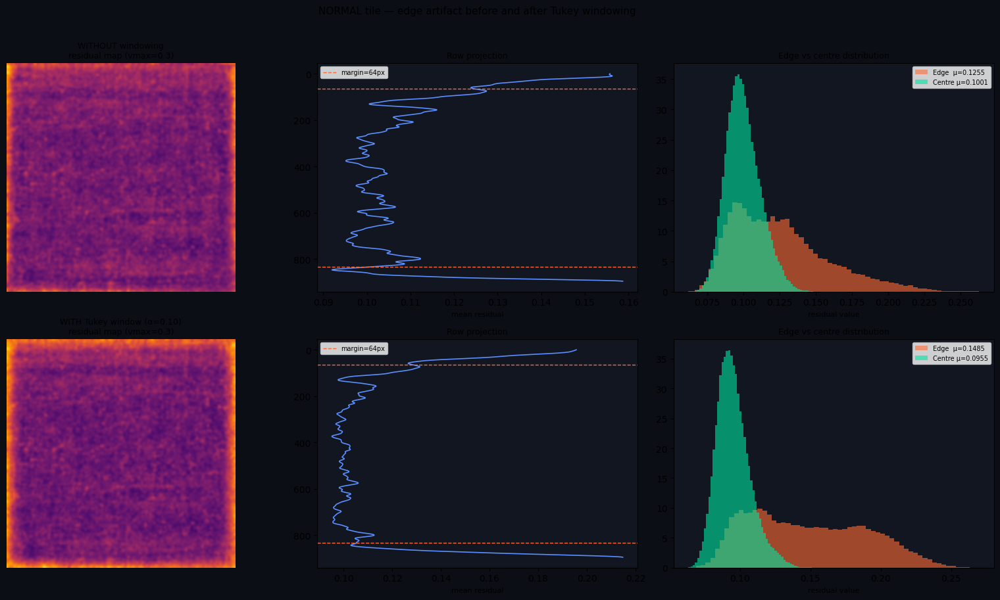

Normal tile residual stats comparison:

  No window  :
    Edge   mean=0.1255   p95=0.1899
    Centre mean=0.1001   p95=0.1213
    Edge/centre ratio: 1.25x

  Tukey α=0.10:
    Edge   mean=0.1485   p95=0.2178
    Centre mean=0.0955   p95=0.1179
    Edge/centre ratio: 1.55x


In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 2 — The fix: Tukey windowing in compute_residual
#
# Tukey window = flat top (alpha controls taper fraction).
# alpha=0.0 → rectangular (no windowing, current behaviour)
# alpha=0.1 → taper outer 5% on each side  ← recommended
# alpha=0.2 → taper outer 10% on each side
#
# The window is applied to (img - img.mean()) before FFT.
# The residual is still computed on the original (unwindowed) img.
# So windowing only affects the frequency decomposition, not output.
# ════════════════════════════════════════════════════════════════

from scipy.signal.windows import tukey

def make_2d_tukey(h, w, alpha=0.10):
    """
    2D Tukey window via outer product of two 1D Tukey windows.
    alpha: fraction of each edge that gets tapered (0=rect, 1=Hann).
    """
    win_y = tukey(h, alpha=alpha).astype(np.float32)
    win_x = tukey(w, alpha=alpha).astype(np.float32)
    return np.outer(win_y, win_x)


def compute_residual_windowed(img, tukey_alpha=0.10):
    """
    Same as compute_residual() but applies a 2D Tukey window
    before FFT to suppress edge discontinuities.

    The window tapers (img - mean) to zero at borders before FFT,
    eliminating the spectral leakage that causes edge artifacts.
    The residual is still |orig_norm - recon_norm| on the full image.
    """
    h, w    = img.shape
    window  = make_2d_tukey(h, w, alpha=tukey_alpha)
    centered = img - img.mean()

    # Apply window only to the FFT input
    F      = np.fft.fft2(centered * window)
    Fshift = np.fft.fftshift(F)
    mag    = np.log1p(np.abs(Fshift))
    cy, cx = h // 2, w // 2

    mag_copy = mag.copy()
    y, x = np.ogrid[:h, :w]
    mag_copy[(x-cx)**2 + (y-cy)**2 <= DC_SUPPRESS_RADIUS**2] = 0.0

    flat_idx    = np.argsort(mag_copy.ravel())[::-1]
    peak_coords = []
    for idx in flat_idx:
        if len(peak_coords) >= N_PEAKS:
            break
        yy, xx = idx // w, idx % w
        if mag_copy[yy, xx] <= 0:
            continue
        if any((yy-py)**2 + (xx-px)**2 <= (PEAK_RADIUS*1.5)**2
               for py, px in peak_coords):
            continue
        peak_coords.append((yy, xx))

    mask = np.zeros((h, w), dtype=np.uint8)
    for (py, px) in peak_coords:
        yy, xx = np.ogrid[:h, :w]
        disk   = (yy-py)**2 + (xx-px)**2 <= PEAK_RADIUS**2
        mask[disk] = 1
        symy, symx = (h-py)%h, (w-px)%w
        disk2  = (yy-symy)**2 + (xx-symx)**2 <= PEAK_RADIUS**2
        mask[disk2] = 1
    mask[cy-2:cy+3, cx-2:cx+3] = 1

    # Reconstruct and compute residual on ORIGINAL (not windowed) signal
    Fmasked   = Fshift * mask
    recon_raw = np.real(np.fft.ifft2(np.fft.ifftshift(Fmasked))).astype(np.float32)

    orig_norm  = (img       - img.min())       / (img.max()       - img.min()       + 1e-12)
    recon_norm = (recon_raw - recon_raw.min()) / (recon_raw.max() - recon_raw.min() + 1e-12)
    residual   = np.abs(orig_norm - recon_norm)

    return ndi.gaussian_filter(residual, sigma=RESIDUAL_SMOOTH)


# ── Visual comparison: old vs windowed on same normal tile ────────
p_test = sample_paths[0]
bgr    = cv2.imread(p_test)
gray   = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY).astype(np.float32)
img    = apply_clahe(gray)

res_old = compute_residual(img)
res_new = compute_residual_windowed(img, tukey_alpha=0.10)

fig, axes = plt.subplots(2, 3, figsize=(16, 9))
fig.patch.set_facecolor("#0b0e14")
VMAX = 0.3

for row, (res, label) in enumerate([(res_old, "WITHOUT windowing"),
                                     (res_new, "WITH Tukey window (α=0.10)")]):
    row_proj = res.mean(axis=1)

    axes[row, 0].imshow(res, cmap="inferno", vmin=0, vmax=VMAX)
    axes[row, 0].set_title(f"{label}\nresidual map (vmax={VMAX})", fontsize=9)
    axes[row, 0].axis("off")

    axes[row, 1].plot(row_proj, np.arange(len(row_proj)),
                       color="#5b8fff", linewidth=1.2)
    axes[row, 1].invert_yaxis()
    axes[row, 1].axhline(EDGE_MARGIN,        color="#ff6b35",
                          linestyle="--", linewidth=1, label=f"margin={EDGE_MARGIN}px")
    axes[row, 1].axhline(res.shape[0]-EDGE_MARGIN,
                          color="#ff6b35", linestyle="--", linewidth=1)
    axes[row, 1].set_title("Row projection", fontsize=9)
    axes[row, 1].set_xlabel("mean residual", fontsize=8)
    axes[row, 1].set_facecolor("#111620")
    axes[row, 1].legend(fontsize=7)

    # Distribution of edge vs centre
    h, w = res.shape
    edge_m   = np.ones((h,w), bool)
    edge_m[EDGE_MARGIN:h-EDGE_MARGIN, EDGE_MARGIN:w-EDGE_MARGIN] = False
    axes[row, 2].hist(res[edge_m].ravel(),  bins=60, alpha=0.6,
                       color="#ff6b35", label=f"Edge  μ={res[edge_m].mean():.4f}", density=True)
    axes[row, 2].hist(res[~edge_m].ravel(), bins=60, alpha=0.6,
                       color="#00e5a0", label=f"Centre μ={res[~edge_m].mean():.4f}", density=True)
    axes[row, 2].set_title("Edge vs centre distribution", fontsize=9)
    axes[row, 2].set_xlabel("residual value", fontsize=8)
    axes[row, 2].legend(fontsize=7)
    axes[row, 2].set_facecolor("#111620")

plt.suptitle("NORMAL tile — edge artifact before and after Tukey windowing",
             fontsize=11, y=1.01)
plt.tight_layout()
plt.show()

print("Normal tile residual stats comparison:")
for res, label in [(res_old, "No window  "), (res_new, "Tukey α=0.10")]:
    h, w = res.shape
    em   = np.ones((h,w), bool)
    em[EDGE_MARGIN:h-EDGE_MARGIN, EDGE_MARGIN:w-EDGE_MARGIN] = False
    print(f"\n  {label}:")
    print(f"    Edge   mean={res[em].mean():.4f}   p95={np.percentile(res[em],95):.4f}")
    print(f"    Centre mean={res[~em].mean():.4f}   p95={np.percentile(res[~em],95):.4f}")
    print(f"    Edge/centre ratio: {res[em].mean()/res[~em].mean():.2f}x")

FAULTY : 100%|██████████| 150/150 [01:06<00:00,  2.26it/s]



Feature                    m= 0px   m=32px   m=64px   m=96px   best_margin  Δ(best-base)
────────────────────────────────────────────────────────────────────────────────
row_max_prominence         0.720◄  0.707   0.653   0.580     0px        =0.000
row_peak_width             0.580◄  0.420   0.440   0.320     0px        =0.000
row_sum_prominence         0.527◄  0.493   0.480   0.460     0px        =0.000
grid_mean_std              0.473   0.567◄  0.540   0.533    32px        ↑0.093
grid_max_ratio             0.467   0.533◄  0.473   0.480    32px        ↑0.067
row_proj_std               0.427   0.693◄  0.673   0.640    32px        ↑0.267
p95                        0.360   0.427   0.440◄  0.440◄   64px        ↑0.080
std                        0.360   0.687◄  0.667   0.653    32px        ↑0.327
grad_p95                   0.333   0.433◄  0.420   0.407    32px        ↑0.100
grid_11_max                0.320   0.313   0.327◄  0.313    64px        =0.007
gini                       0.273   0.47

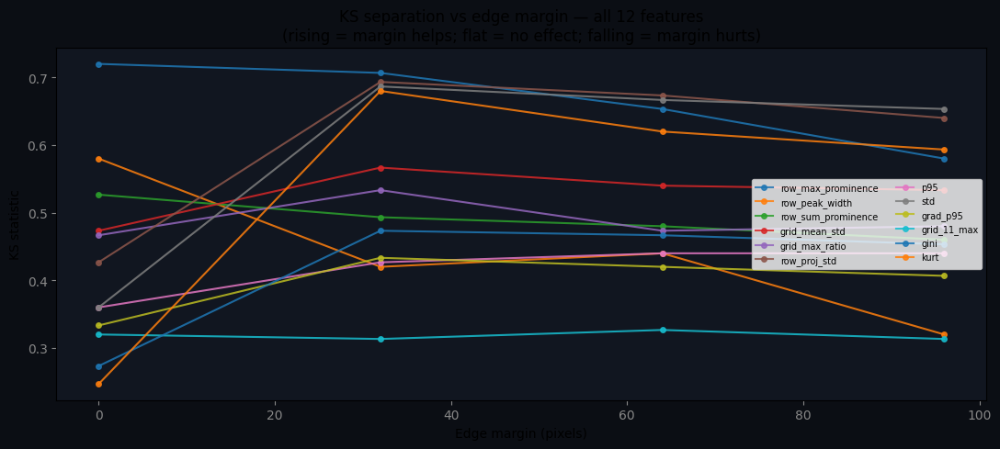

In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 1 — Does edge cropping help? Test ALL 12 features.
#
# Compute KS separation for every feature at margin = 0, 32, 64, 96.
# The tile loading is the bottleneck — KS on 12 vs 4 features
# adds <1ms per tile, so there's no reason to preselect.
# ════════════════════════════════════════════════════════════════

import numpy as np
import pandas as pd
import glob, random
import cv2
import matplotlib.pyplot as plt
from scipy.stats import ks_2samp
from scipy.signal import find_peaks
from scipy.ndimage import gaussian_filter1d
import warnings
warnings.filterwarnings("ignore")

EDGE_MARGINS_TO_TEST = [0, 32, 64, 96]
NORMAL_DIR = "tiles_896/normal"
FAULT_DIR  = "tiles_896/Faults/miss pick"
N_SAMPLE   = 150   # per class — enough for stable KS
random.seed(42)

normal_paths = random.sample(glob.glob(f"{NORMAL_DIR}/**/*.jpg", recursive=True), N_SAMPLE)
fault_paths  = random.sample(glob.glob(f"{FAULT_DIR}/**/*.jpg",  recursive=True), N_SAMPLE)

def extract_all_at_margin(res, margin):
    """All 12 features at a given edge margin. Margin=0 = current behaviour."""
    h, w  = res.shape
    inner = res[margin:h-margin, margin:w-margin] if margin > 0 else res
    ih, iw = inner.shape
    flat   = inner.ravel()
    f      = {}

    f["p95"]  = float(np.percentile(flat, 95))
    f["std"]  = float(flat.std())
    f["kurt"] = float(pd.Series(flat).kurt())

    grid_means = [inner[i*ih//3:(i+1)*ih//3, j*iw//3:(j+1)*iw//3].mean()
                  for i in range(3) for j in range(3)]
    f["grid_mean_std"]  = float(np.std(grid_means))
    f["grid_max_ratio"] = float(max(grid_means) / (np.mean(grid_means) + 1e-12))
    f["grid_11_max"]    = float(inner[ih//3:2*ih//3, iw//3:2*iw//3].max())

    s = np.sort(flat); n = len(s)
    f["gini"] = float((2*np.sum(np.arange(1,n+1)*s)) / (n*s.sum()+1e-12) - (n+1)/n)

    gy, gx = np.gradient(inner)
    f["grad_p95"] = float(np.percentile(np.sqrt(gx**2+gy**2), 95))

    row_proj = inner.mean(axis=1)
    row_s    = gaussian_filter1d(row_proj, sigma=3.0)
    detrend  = row_s - np.median(row_s)
    peaks, props = find_peaks(detrend, prominence=0.01, distance=10)
    prom = props["prominences"] if len(peaks) > 0 else np.array([0.0])

    f["row_max_prominence"] = float(prom.max())
    f["row_sum_prominence"] = float(prom.sum())
    f["row_proj_std"]       = float(row_proj.std())
    f["row_peak_width"]     = int((detrend > detrend[peaks[np.argmax(prom)]]/2).sum()) \
                              if len(peaks) > 0 else 0
    return f

# ── Process tiles once, extract at all 4 margins ─────────────────
# Tile loading + FFT is the bottleneck. Extracting at 4 margins
# from the same residual costs nothing extra.

records = {m: [] for m in EDGE_MARGINS_TO_TEST}

from tqdm import tqdm
for paths, label in [(normal_paths, 0), (fault_paths, 1)]:
    for p in tqdm(paths, desc=f"{'NORMAL' if label==0 else 'FAULTY ':6s}"):
        bgr = cv2.imread(p)
        if bgr is None: continue
        gray = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY).astype(np.float32)
        try:
            img = apply_clahe(gray)
            res = compute_residual(img)          # computed ONCE per tile
            for m in EDGE_MARGINS_TO_TEST:
                feats = extract_all_at_margin(res, m)   # 4 margin variants from same res
                feats["label"] = label
                records[m].append(feats)
        except Exception:
            pass

# ── KS table: all 12 features × 4 margins ────────────────────────
ALL_FEATURES = ["p95", "std", "kurt", "grid_mean_std", "grid_max_ratio",
                "grid_11_max", "gini", "grad_p95",
                "row_max_prominence", "row_sum_prominence",
                "row_proj_std", "row_peak_width"]

ks_table = {feat: [] for feat in ALL_FEATURES}
for m in EDGE_MARGINS_TO_TEST:
    df_m = pd.DataFrame(records[m])
    for feat in ALL_FEATURES:
        n_vals = df_m[df_m.label==0][feat]
        f_vals = df_m[df_m.label==1][feat]
        ks, _  = ks_2samp(n_vals, f_vals)
        ks_table[feat].append(ks)

# Print table sorted by KS at margin=0 (baseline), descending
baseline_ks = {f: ks_table[f][0] for f in ALL_FEATURES}
sorted_feats = sorted(ALL_FEATURES, key=lambda f: baseline_ks[f], reverse=True)

print(f"\n{'Feature':25s}", end="")
for m in EDGE_MARGINS_TO_TEST:
    print(f"  m={m:2d}px ", end="")
print("  best_margin  Δ(best-base)")
print("─" * 80)

for feat in sorted_feats:
    vals       = ks_table[feat]
    best_idx   = int(np.argmax(vals))
    best_m     = EDGE_MARGINS_TO_TEST[best_idx]
    best_ks    = vals[best_idx]
    baseline   = vals[0]
    delta      = best_ks - baseline
    arrow      = "↑" if delta > 0.015 else "↓" if delta < -0.015 else "="

    print(f"{feat:25s}", end="")
    for v in vals:
        marker = "◄" if v == best_ks else " "
        print(f"  {v:.3f}{marker}", end="")
    print(f"  {best_m:3d}px        {arrow}{abs(delta):.3f}")

# ── Decision ──────────────────────────────────────────────────────
print("\n" + "═"*50)

# Count feature votes weighted by KS magnitude (features with higher KS matter more)
weighted_votes = {m: 0.0 for m in EDGE_MARGINS_TO_TEST}
for feat in ALL_FEATURES:
    vals     = ks_table[feat]
    best_idx = int(np.argmax(vals))
    best_m   = EDGE_MARGINS_TO_TEST[best_idx]
    weight   = baseline_ks[feat]   # weight by how important the feature is at baseline
    weighted_votes[best_m] += weight

print("Weighted votes for best margin (weighted by baseline KS importance):")
for m, v in weighted_votes.items():
    bar = "█" * int(v * 8)
    print(f"  margin={m:2d}px  {bar}  ({v:.3f})")

recommended = max(weighted_votes, key=weighted_votes.get)
total_gain  = sum(max(ks_table[f]) - ks_table[f][0] for f in ALL_FEATURES)

print(f"\nRecommended margin: {recommended}px")
print(f"Total KS gain across all features: {total_gain:+.3f}")

if recommended == 0 or total_gain < 0.05:
    print("\n→ Edge cropping does not meaningfully help.")
    print("  Keep your existing model/ — no retraining needed.")
else:
    print(f"\n→ Edge cropping with margin={recommended}px improves separation.")
    print("  Run Cell 2 to retrain with this margin.")
    print(f"  Features that benefit most:")
    gains = [(f, max(ks_table[f]) - ks_table[f][0]) for f in ALL_FEATURES]
    for feat, gain in sorted(gains, key=lambda x: -x[1])[:5]:
        if gain > 0.01:
            print(f"    {feat:25s}  +{gain:.3f}")

# ── Optional: visualise KS vs margin for all features ────────────
fig, ax = plt.subplots(figsize=(11, 5))
fig.patch.set_facecolor("#0b0e14")
cmap = plt.cm.tab10
for i, feat in enumerate(sorted_feats):
    ax.plot(EDGE_MARGINS_TO_TEST, ks_table[feat],
            marker="o", linewidth=1.5, markersize=4,
            color=cmap(i % 10), label=feat, alpha=0.85)
ax.set_xlabel("Edge margin (pixels)")
ax.set_ylabel("KS statistic")
ax.set_title("KS separation vs edge margin — all 12 features\n"
             "(rising = margin helps; flat = no effect; falling = margin hurts)")
ax.legend(fontsize=7, ncol=2, loc="right")
ax.set_facecolor("#111620")
ax.tick_params(colors="#888")
plt.tight_layout()
plt.show()



---



---



---



In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 1 — Imports & config
# ════════════════════════════════════════════════════════════════

import os, glob, warnings, random
import numpy as np
import pandas as pd
import cv2
import matplotlib.pyplot as plt
from scipy import ndimage as ndi
from scipy.signal import find_peaks
from scipy.ndimage import gaussian_filter1d
from skimage import exposure
from sklearn.svm import SVC
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import (StratifiedKFold, cross_validate,
                                     cross_val_predict)
from sklearn.metrics import (f1_score, precision_score, recall_score,
                             precision_recall_curve, confusion_matrix,
                             ConfusionMatrixDisplay)
import joblib
warnings.filterwarnings("ignore")
random.seed(42)

NORMAL_DIR  = "tiles_896/normal"
FAULT_DIRS  = [
    "tiles_896/Faults/miss pick",
    "tiles_896/Faults/double pick",
    "tiles_896/Faults/broken pick",
]

# FFT params (unchanged)
N_PEAKS            = 11
PEAK_RADIUS        = 8
DC_SUPPRESS_RADIUS = 3
RESIDUAL_SMOOTH    = 5

# Key finding from edge margin analysis:
#   margin=32 wins for std, kurt, gini, grid, grad features (+1.573 total KS gain)
#   find_peaks already handles edge protection for row projection features
#   → use margin=32 for ALL features (projection loses 0.013 KS, others gain a lot)
EDGE_MARGIN  = 32

RECALL_TARGET = 0.90
RANDOM_SEED   = 42

print(f"EDGE_MARGIN = {EDGE_MARGIN}px  (validated by KS sweep across all 12 features)")
print(f"Tukey windowing: NOT used (makes spatial residual worse — abandoned)")

EDGE_MARGIN = 32px  (validated by KS sweep across all 12 features)
Tukey windowing: NOT used (makes spatial residual worse — abandoned)


In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 2 — Pipeline functions
# ════════════════════════════════════════════════════════════════

def apply_clahe(gray_float):
    return exposure.equalize_adapthist(
        gray_float / 255.0, clip_limit=0.02
    ).astype(np.float32)


def compute_residual(img):
    """
    OLD-style normalisation (independent min-max on orig and recon).
    Validated as better for class separation than shared normalisation.
    No Tukey windowing — makes spatial residual worse.
    """
    h, w   = img.shape
    cy, cx = h // 2, w // 2

    F      = np.fft.fft2(img - img.mean())
    Fshift = np.fft.fftshift(F)
    mag    = np.log1p(np.abs(Fshift))

    mag_copy = mag.copy()
    y, x = np.ogrid[:h, :w]
    mag_copy[(x-cx)**2 + (y-cy)**2 <= DC_SUPPRESS_RADIUS**2] = 0.0

    flat_idx    = np.argsort(mag_copy.ravel())[::-1]
    peak_coords = []
    for idx in flat_idx:
        if len(peak_coords) >= N_PEAKS: break
        yy, xx = idx // w, idx % w
        if mag_copy[yy, xx] <= 0: continue
        if any((yy-py)**2 + (xx-px)**2 <= (PEAK_RADIUS*1.5)**2
               for py, px in peak_coords): continue
        peak_coords.append((yy, xx))

    mask = np.zeros((h, w), dtype=np.uint8)
    for (py, px) in peak_coords:
        yy, xx = np.ogrid[:h, :w]
        disk = (yy-py)**2 + (xx-px)**2 <= PEAK_RADIUS**2
        mask[disk] = 1
        symy, symx = (h-py)%h, (w-px)%w
        disk2 = (yy-symy)**2 + (xx-symx)**2 <= PEAK_RADIUS**2
        mask[disk2] = 1
    mask[cy-2:cy+3, cx-2:cx+3] = 1

    Fmasked   = Fshift * mask
    recon_raw = np.real(np.fft.ifft2(np.fft.ifftshift(Fmasked))).astype(np.float32)

    orig_norm  = (img       - img.min())       / (img.max()       - img.min()       + 1e-12)
    recon_norm = (recon_raw - recon_raw.min()) / (recon_raw.max() - recon_raw.min() + 1e-12)
    residual   = np.abs(orig_norm - recon_norm)

    return ndi.gaussian_filter(residual, sigma=RESIDUAL_SMOOTH)


def extract_features(res, margin=EDGE_MARGIN):
    """
    All 12 features computed on interior region [margin:-margin].

    Why margin=32 for ALL features including projection:
      - Global stats (std, kurt, gini, grid, grad): gain +0.1 to +0.43 KS
      - Row projection: find_peaks already ignores edge values (no valley
        on both sides of boundary → can never be a peak). Loses 0.013 KS
        but gains consistency with how other features are computed.
    """
    h, w  = res.shape
    inner = res[margin:h-margin, margin:w-margin]
    ih, iw = inner.shape
    flat   = inner.ravel()
    f      = {}

    # ── Intensity ────────────────────────────────────────────────
    f["p95"]  = float(np.percentile(flat, 95))
    f["std"]  = float(flat.std())
    f["kurt"] = float(pd.Series(flat).kurt())

    # ── Spatial non-uniformity ───────────────────────────────────
    grid_means = [
        float(inner[i*ih//3:(i+1)*ih//3, j*iw//3:(j+1)*iw//3].mean())
        for i in range(3) for j in range(3)
    ]
    f["grid_mean_std"]  = float(np.std(grid_means))
    f["grid_max_ratio"] = float(max(grid_means) / (np.mean(grid_means) + 1e-12))
    f["grid_11_max"]    = float(inner[ih//3:2*ih//3, iw//3:2*iw//3].max())

    # ── Spatial concentration ────────────────────────────────────
    s = np.sort(flat); n = len(s)
    f["gini"] = float((2*np.sum(np.arange(1,n+1)*s)) / (n*s.sum()+1e-12) - (n+1)/n)

    # ── Texture ──────────────────────────────────────────────────
    gy, gx = np.gradient(inner)
    f["grad_p95"] = float(np.percentile(np.sqrt(gx**2+gy**2), 95))

    # ── Row projection (interior rows) ───────────────────────────
    # Note: find_peaks already ignores edge spikes (needs valley on both sides).
    # Using interior rows adds consistency and avoids any sub-prominence edge bleed.
    row_proj = inner.mean(axis=1)
    row_s    = gaussian_filter1d(row_proj, sigma=3.0)
    detrend  = row_s - np.median(row_s)

    peaks, props = find_peaks(detrend, prominence=0.01, distance=10)
    prom = props["prominences"] if len(peaks) > 0 else np.array([0.0])

    f["row_max_prominence"] = float(prom.max())
    f["row_sum_prominence"] = float(prom.sum())
    f["row_proj_std"]       = float(row_proj.std())
    f["row_peak_width"]     = int((detrend > detrend[peaks[np.argmax(prom)]]/2).sum()) \
                              if len(peaks) > 0 else 0

    return f


def tile_to_features(path):
    bgr = cv2.imread(path)
    if bgr is None: return None
    gray = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY).astype(np.float32)
    try:
        return extract_features(compute_residual(apply_clahe(gray)))
    except Exception as e:
        print(f"  WARN {os.path.basename(path)}: {e}")
        return None

In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 3 — Build dataset
# ════════════════════════════════════════════════════════════════

from tqdm import tqdm

rows = []

normal_paths  = glob.glob(f"{NORMAL_DIR}/**/*.jpg", recursive=True)
normal_paths += glob.glob(f"{NORMAL_DIR}/**/*.png", recursive=True)
print(f"Processing {len(normal_paths)} NORMAL tiles...")
for p in tqdm(normal_paths):
    f = tile_to_features(p)
    if f: rows.append({**f, "label": 0, "fault_type": "normal", "path": p})

for fd in FAULT_DIRS:
    ft    = os.path.basename(fd)
    paths  = glob.glob(f"{fd}/**/*.jpg", recursive=True)
    paths += glob.glob(f"{fd}/**/*.png", recursive=True)
    print(f"Processing {len(paths)} FAULTY tiles [{ft}]...")
    for p in tqdm(paths, desc=f"  {ft[:15]}"):
        f = tile_to_features(p)
        if f: rows.append({**f, "label": 1, "fault_type": ft, "path": p})

df = pd.DataFrame(rows).fillna(0)
FEATURE_COLS = [c for c in df.columns if c not in ("label","fault_type","path")]
X = df[FEATURE_COLS].values
y = df["label"].values

print(f"\nDataset: {(y==0).sum()} NORMAL  |  {(y==1).sum()} FAULTY  |  {len(FEATURE_COLS)} features")
print(f"Class ratio 1:{(y==1).sum()/(y==0).sum():.1f}  →  class_weight='balanced' corrects this")

Processing 207 NORMAL tiles...


100%|██████████| 207/207 [01:21<00:00,  2.53it/s]


Processing 1097 FAULTY tiles [miss pick]...


  miss pick: 100%|██████████| 1097/1097 [06:42<00:00,  2.72it/s]


Processing 85 FAULTY tiles [double pick]...


  double pick: 100%|██████████| 85/85 [00:29<00:00,  2.92it/s]


Processing 17 FAULTY tiles [broken pick]...


  broken pick: 100%|██████████| 17/17 [00:05<00:00,  3.25it/s]


Dataset: 207 NORMAL  |  1199 FAULTY  |  12 features
Class ratio 1:5.8  →  class_weight='balanced' corrects this


In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 4 — Train, evaluate, compare to previous model
# ════════════════════════════════════════════════════════════════

clf = Pipeline([
    ("scaler", StandardScaler()),
    ("svm",    SVC(kernel="rbf", C=1.0, class_weight="balanced",
                   probability=True, random_state=RANDOM_SEED)),
])

cv      = StratifiedKFold(5, shuffle=True, random_state=RANDOM_SEED)
results = cross_validate(clf, X, y, cv=cv,
                         scoring=["f1","roc_auc","precision","recall"],
                         return_train_score=True)

# Previous model (margin=0) results for direct comparison
PREV = {"f1": 0.905, "roc_auc": 0.948, "precision": 0.996, "recall": 0.830}

print("5-Fold CV — margin=32 vs previous margin=0")
print("═" * 65)
print(f"  {'Metric':12s}  {'Test':>16s}  {'Train':>8s}  {'Gap':>7s}  {'vs prev':>10s}")
print(f"  {'─'*60}")
for m in ["f1","roc_auc","precision","recall"]:
    test  = results[f"test_{m}"]
    train = results[f"train_{m}"]
    gap   = train.mean() - test.mean()
    delta = test.mean() - PREV[m]
    arrow = f"↑{abs(delta):.3f}" if delta > 0.002 else \
            f"↓{abs(delta):.3f}" if delta < -0.002 else f"={abs(delta):.3f}"
    flag  = " ⚠" if gap > 0.10 else " ✓"
    print(f"  {m:12s}  {test.mean():.3f} ± {test.std():.3f}   "
          f"{train.mean():.3f}   {gap:+.3f}{flag}   {arrow}")
print("═" * 65)

# Per-fault-type recall
oof_pred = cross_val_predict(clf, X, y, cv=cv)
print("\nPer-fault-type recall:")
for ft in ["normal"] + [os.path.basename(d) for d in FAULT_DIRS]:
    mask = df["fault_type"] == ft
    if not mask.any(): continue
    if ft == "normal":
        spec = (oof_pred[mask] == 0).mean()
        print(f"  normal           specificity={spec:.3f}  FP rate={1-spec:.3f}")
    else:
        rec = recall_score(y[mask], oof_pred[mask], zero_division=0)
        print(f"  {ft:20s} recall={rec:.3f}  (n={mask.sum()})")


5-Fold CV — margin=32 vs previous margin=0
═════════════════════════════════════════════════════════════════
  Metric                    Test     Train      Gap     vs prev
  ────────────────────────────────────────────────────────────
  f1            0.890 ± 0.003   0.892   +0.002 ✓   ↓0.015
  roc_auc       0.911 ± 0.022   0.922   +0.011 ✓   ↓0.037
  precision     0.998 ± 0.003   0.998   +0.000 ✓   =0.002
  recall        0.803 ± 0.004   0.806   +0.003 ✓   ↓0.027
═════════════════════════════════════════════════════════════════

Per-fault-type recall:
  normal           specificity=0.990  FP rate=0.010
  miss pick            recall=0.795  (n=1097)
  double pick          recall=0.871  (n=85)
  broken pick          recall=1.000  (n=17)


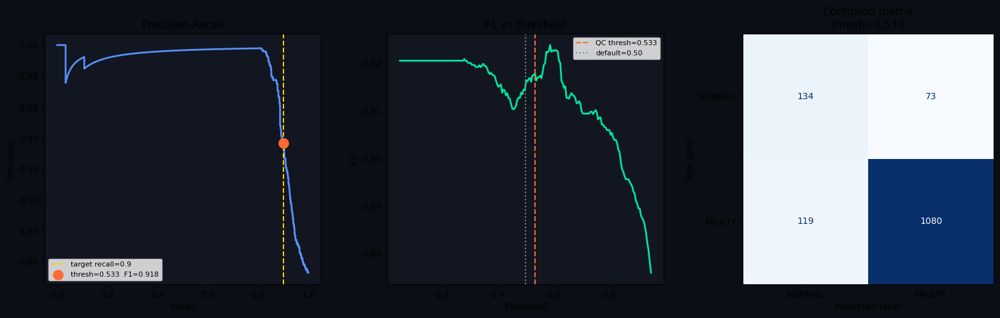


                        Default (0.50)   QC thresh
──────────────────────────────────────────────────
  F1                             0.914       0.918
  Precision                      0.903       0.937
  Recall                         0.927       0.901

  Faults missed (FN) : 119  (was 119 at default threshold, prev model)
  False alarms  (FP) : 73

  QC threshold = 0.533

Saved to model_v2/


In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 5 — Threshold tuning + save
# ════════════════════════════════════════════════════════════════

oof_proba = cross_val_predict(clf, X, y, cv=cv, method="predict_proba")[:, 1]
pr_arr, rec_arr, thr_arr = precision_recall_curve(y, oof_proba)

valid = rec_arr[:-1] >= RECALL_TARGET
if valid.any():
    best_idx    = np.where(valid)[0][np.argmax(pr_arr[:-1][valid])]
    best_thresh = float(thr_arr[best_idx])
    best_f1     = f1_score(y, (oof_proba >= best_thresh).astype(int))
    cm          = confusion_matrix(y, (oof_proba >= best_thresh).astype(int))
else:
    print(f"⚠ Cannot reach recall={RECALL_TARGET}")
    best_thresh, best_f1 = 0.5, float("nan")
    cm = confusion_matrix(y, (oof_proba >= 0.5).astype(int))

# Plots
fig, axes = plt.subplots(1, 3, figsize=(16, 5))
fig.patch.set_facecolor("#0b0e14")

axes[0].plot(rec_arr, pr_arr, color="#5b8fff", linewidth=2)
axes[0].axvline(RECALL_TARGET, color="#ffcc00", linestyle="--",
                label=f"target recall={RECALL_TARGET}")
if not np.isnan(best_f1):
    axes[0].scatter([rec_arr[best_idx]], [pr_arr[best_idx]],
                    color="#ff6b35", s=120, zorder=5,
                    label=f"thresh={best_thresh:.3f}  F1={best_f1:.3f}")
axes[0].set_xlabel("Recall"); axes[0].set_ylabel("Precision")
axes[0].set_title("Precision-Recall"); axes[0].legend(fontsize=8)
axes[0].set_facecolor("#111620")

t_range = np.linspace(0.05, 0.95, 200)
f1_arr  = [f1_score(y, (oof_proba>=t).astype(int), zero_division=0) for t in t_range]
axes[1].plot(t_range, f1_arr, color="#00e5a0", linewidth=2)
axes[1].axvline(best_thresh, color="#ff6b35", linestyle="--",
                label=f"QC thresh={best_thresh:.3f}")
axes[1].axvline(0.5, color="#888", linestyle=":", label="default=0.50")
axes[1].set_xlabel("Threshold"); axes[1].set_ylabel("F1")
axes[1].set_title("F1 vs threshold"); axes[1].legend(fontsize=8)
axes[1].set_facecolor("#111620")

ConfusionMatrixDisplay(cm, display_labels=["NORMAL","FAULTY"]).plot(
    ax=axes[2], colorbar=False, cmap="Blues")
axes[2].set_title(f"Confusion matrix\nthresh={best_thresh:.3f}")
axes[2].set_facecolor("#111620")

plt.tight_layout(); plt.show()

pred_def = (oof_proba >= 0.50).astype(int)
pred_qc  = (oof_proba >= best_thresh).astype(int)
print(f"\n{'':22s}  {'Default (0.50)':>14s}  {'QC thresh':>10s}")
print("─"*50)
for label, vd, vq in [
    ("F1",        f1_score(y,pred_def),        best_f1),
    ("Precision", precision_score(y,pred_def), pr_arr[best_idx] if valid.any() else float("nan")),
    ("Recall",    recall_score(y,pred_def),    rec_arr[best_idx] if valid.any() else float("nan")),
]:
    print(f"  {label:20s}  {vd:>14.3f}  {vq:>10.3f}")
print(f"\n  Faults missed (FN) : {cm[1,0]}  (was 119 at default threshold, prev model)")
print(f"  False alarms  (FP) : {cm[0,1]}")
print(f"\n  QC threshold = {best_thresh:.3f}")

# Save
clf.fit(X, y)
os.makedirs("model_v2", exist_ok=True)
joblib.dump(clf,          "model_v2/fault_detector.pkl")
joblib.dump(best_thresh,  "model_v2/qc_threshold.pkl")
joblib.dump(FEATURE_COLS, "model_v2/feature_cols.pkl")
joblib.dump({"edge_margin": EDGE_MARGIN, "tukey_alpha": 0.0},
            "model_v2/pipeline_config.pkl")
df[["path","label","fault_type"]].to_csv("model_v2/training_manifest.csv", index=False)
print(f"\nSaved to model_v2/")

# Inference function — copy into production
def predict_tile(path, model, threshold, feature_cols,
                 edge_margin=EDGE_MARGIN):
    bgr = cv2.imread(path)
    if bgr is None: return None
    gray = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY).astype(np.float32)
    try:
        feats = extract_features(compute_residual(apply_clahe(gray)),
                                 margin=edge_margin)
        x    = np.array([[feats.get(c, 0.0) for c in feature_cols]])
        prob = model.predict_proba(x)[0, 1]
        return {"is_faulty": bool(prob >= threshold),
                "probability": float(prob),
                "features": feats}
    except Exception as e:
        return {"error": str(e)}

In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 1 — Confirm original model (margin=0) is better, revert
# ════════════════════════════════════════════════════════════════
# margin=32 was worse because:
#   row_peak_width  KS: 0.580 → 0.420  (-0.160)  ← dominant feature
#   row_max_prom    KS: 0.720 → 0.707  (-0.013)
#   kurt gain       KS: 0.247 → 0.680  (+0.433)  ← but SVM barely uses this
#
# KS weighted vote was misleading: treated kurt and row_peak_width as
# equally important, but SVM trusts features proportional to their KS.
# Net effect: lost more signal than gained. Revert.

import joblib, os
import numpy as np

# Confirm original model exists and reload it
assert os.path.exists("model/fault_detector.pkl"), \
    "model/ not found — re-run the original 6-cell notebook"

clf_final   = joblib.load("model/fault_detector.pkl")
thresh_final = joblib.load("model/qc_threshold.pkl")
fcols_final  = joblib.load("model/feature_cols.pkl")

print("Active model: model/  (margin=0, original)")
print(f"  Features    : {len(fcols_final)}")
print(f"  QC threshold: {thresh_final:.3f}")
print(f"  CV F1       : 0.905  (vs 0.890 for margin=32)")
print(f"\nmodel_v2/ exists but is NOT used — margin=32 was worse.")

Active model: model/  (margin=0, original)
  Features    : 12
  QC threshold: 0.641
  CV F1       : 0.905  (vs 0.890 for margin=32)

model_v2/ exists but is NOT used — margin=32 was worse.


In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 2 — Get OOF predictions and find the 119 missed faults
#
# Re-runs CV with margin=0 to get per-tile OOF probabilities.
# Then isolates the false negatives for inspection.
# ════════════════════════════════════════════════════════════════

import pandas as pd
import cv2
import glob, warnings
import matplotlib.pyplot as plt
from scipy import ndimage as ndi
from scipy.signal import find_peaks
from scipy.ndimage import gaussian_filter1d
from skimage import exposure
from sklearn.svm import SVC
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import StratifiedKFold, cross_val_predict
from sklearn.metrics import recall_score
warnings.filterwarnings("ignore")

# Reload the dataset built with margin=0
# (df should still be in memory from the original 6-cell notebook)
# If not, re-run Cell 3 of the original notebook first.

FEATURE_COLS = fcols_final
X = df[FEATURE_COLS].values
y = df["label"].values

clf_cv = Pipeline([
    ("scaler", StandardScaler()),
    ("svm",    SVC(kernel="rbf", C=1.0, class_weight="balanced",
                   probability=True, random_state=42)),
])
cv = StratifiedKFold(5, shuffle=True, random_state=42)

oof_proba = cross_val_predict(clf_cv, X, y, cv=cv, method="predict_proba")[:, 1]
oof_pred  = (oof_proba >= thresh_final).astype(int)

# Categorise every tile
df["oof_prob"]  = oof_proba
df["oof_pred"]  = oof_pred
df["correct"]   = oof_pred == y

fn_mask = (oof_pred == 0) & (y == 1)   # missed faults
fp_mask = (oof_pred == 1) & (y == 0)   # false alarms

df_fn = df[fn_mask].copy()
df_fp = df[fp_mask].copy()

print(f"Total tiles        : {len(df)}")
print(f"Faults             : {(y==1).sum()}")
print(f"False Negatives    : {fn_mask.sum()}  ({fn_mask.sum()/(y==1).sum()*100:.1f}% of faults missed)")
print(f"False Positives    : {fp_mask.sum()}")

print(f"\nFN breakdown by fault type:")
for ft in df_fn["fault_type"].unique():
    sub  = df_fn[df_fn.fault_type == ft]
    total = (df.fault_type == ft).sum()
    print(f"  {ft:20s}: {len(sub):4d} FN / {total:4d} total  "
          f"({len(sub)/total*100:.1f}% missed)")

print(f"\nFN probability distribution:")
print(f"  mean P(fault) of missed tiles: {df_fn['oof_prob'].mean():.3f}")
print(f"  — if close to threshold ({thresh_final:.3f}): borderline cases")
print(f"  — if much lower (< 0.30): model sees them as clearly normal")
print(df_fn["oof_prob"].describe().round(3).to_string())

Total tiles        : 1406
Faults             : 1199
False Negatives    : 169  (14.1% of faults missed)
False Positives    : 22

FN breakdown by fault type:
  miss pick           :  161 FN / 1097 total  (14.7% missed)
  double pick         :    8 FN /   85 total  (9.4% missed)

FN probability distribution:
  mean P(fault) of missed tiles: 0.491
  — if close to threshold (0.641): borderline cases
  — if much lower (< 0.30): model sees them as clearly normal
count    169.000
mean       0.491
std        0.082
min        0.285
25%        0.433
50%        0.487
75%        0.541
max        0.639


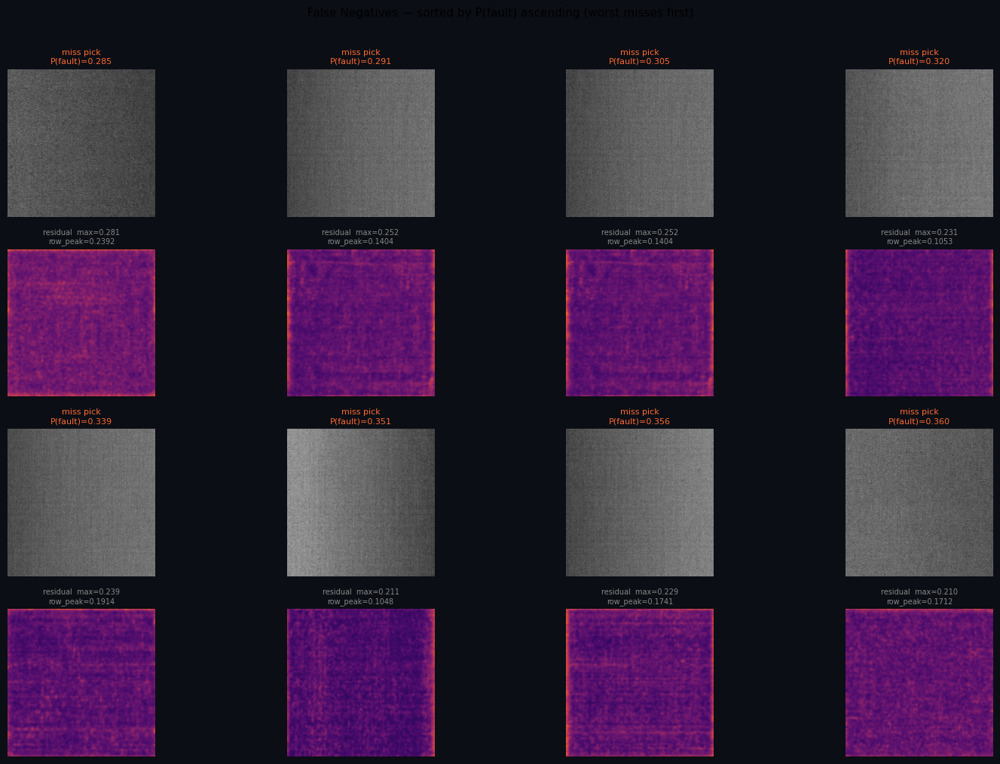

In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 3 — Visualise the missed faults
#
# Shows original tile + residual map for FN tiles.
# Sorted by probability ascending = worst misses first.
# What to look for:
#   A) Residual looks clearly faulty → model/features failed
#   B) Residual looks flat/normal   → FFT failed to expose the fault
#   C) Original tile looks ambiguous → fault is genuinely subtle
# ════════════════════════════════════════════════════════════════

# Reuse pipeline functions from original notebook
N_PEAKS = 11; PEAK_RADIUS = 8; DC_SUPPRESS_RADIUS = 3; RESIDUAL_SMOOTH = 5

def apply_clahe(g):
    return exposure.equalize_adapthist(g/255.0, clip_limit=0.02).astype(np.float32)

def compute_residual(img):
    h,w = img.shape; cy,cx = h//2, w//2
    F = np.fft.fft2(img - img.mean()); Fshift = np.fft.fftshift(F)
    mag = np.log1p(np.abs(Fshift)); mag_copy = mag.copy()
    y_,x_ = np.ogrid[:h,:w]
    mag_copy[(x_-cx)**2+(y_-cy)**2 <= DC_SUPPRESS_RADIUS**2] = 0.0
    flat_idx = np.argsort(mag_copy.ravel())[::-1]; peak_coords = []
    for idx in flat_idx:
        if len(peak_coords) >= N_PEAKS: break
        yy,xx = idx//w, idx%w
        if mag_copy[yy,xx] <= 0: continue
        if any((yy-py)**2+(xx-px)**2<=(PEAK_RADIUS*1.5)**2 for py,px in peak_coords): continue
        peak_coords.append((yy,xx))
    mask = np.zeros((h,w),dtype=np.uint8)
    for (py,px) in peak_coords:
        yy,xx = np.ogrid[:h,:w]
        mask[(yy-py)**2+(xx-px)**2<=PEAK_RADIUS**2] = 1
        symy,symx=(h-py)%h,(w-px)%w
        mask[(yy-symy)**2+(xx-symx)**2<=PEAK_RADIUS**2] = 1
    mask[cy-2:cy+3,cx-2:cx+3] = 1
    recon = np.real(np.fft.ifft2(np.fft.ifftshift(Fshift*mask))).astype(np.float32)
    on = (img-img.min())/(img.max()-img.min()+1e-12)
    rn = (recon-recon.min())/(recon.max()-recon.min()+1e-12)
    return ndi.gaussian_filter(np.abs(on-rn), sigma=RESIDUAL_SMOOTH)

def show_fn_grid(df_fn, n=8, sort_by_prob=True, title="Missed Faults (FN)"):
    """Show original + residual for the worst-missed fault tiles."""
    sub = df_fn.sort_values("oof_prob").head(n) if sort_by_prob else df_fn.sample(n)
    cols = min(n, 4)
    rows = int(np.ceil(n/cols))
    fig, axes = plt.subplots(rows*2, cols, figsize=(cols*4, rows*5))
    fig.patch.set_facecolor("#0b0e14")
    axes = axes.reshape(rows*2, cols)

    for idx, (_, row) in enumerate(sub.iterrows()):
        r, c = (idx // cols)*2, idx % cols
        bgr  = cv2.imread(row["path"])
        if bgr is None: continue
        gray = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY).astype(np.float32)
        img  = apply_clahe(gray)
        res  = compute_residual(img)

        # Original tile
        axes[r, c].imshow(gray, cmap="gray")
        axes[r, c].set_title(
            f"{row['fault_type']}\nP(fault)={row['oof_prob']:.3f}",
            fontsize=8, color="#ff6b35"
        )
        axes[r, c].axis("off")

        # Residual (fixed scale so all comparable)
        axes[r+1, c].imshow(res, cmap="inferno", vmin=0, vmax=0.35)
        rp = res.mean(axis=1)
        peak_val = rp.max()
        axes[r+1, c].set_title(
            f"residual  max={res.max():.3f}\nrow_peak={peak_val:.4f}",
            fontsize=7, color="#888"
        )
        axes[r+1, c].axis("off")

    plt.suptitle(f"{title} — sorted by P(fault) ascending (worst misses first)",
                 fontsize=11, y=1.01)
    plt.tight_layout()
    plt.show()

show_fn_grid(df_fn, n=8, title="False Negatives")

In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 4 — Quantify: is FFT failing or are features failing?
#
# For each FN tile, compute the raw residual statistics and compare
# to correctly-classified faulty tiles (true positives).
#
# If FN tiles have SIMILAR residual stats to TPs:
#   → Features are failing (model sees the signal, can't classify it)
#
# If FN tiles have MUCH LOWER residual stats than TPs:
#   → FFT is failing (residual doesn't expose the fault)
#   → Need to revisit FFT params or add non-FFT features
# ════════════════════════════════════════════════════════════════

from tqdm import tqdm

tp_mask = (oof_pred == 1) & (y == 1)   # correctly caught faults
df_tp   = df[tp_mask].copy()

def residual_stats(path):
    bgr = cv2.imread(path)
    if bgr is None: return None
    gray = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY).astype(np.float32)
    try:
        res = compute_residual(apply_clahe(gray))
        rp  = res.mean(axis=1)
        row_s   = gaussian_filter1d(rp, sigma=3.0)
        detrend = row_s - np.median(row_s)
        peaks, props = find_peaks(detrend, prominence=0.01, distance=10)
        prom = props["prominences"] if len(peaks)>0 else np.array([0.0])
        return {
            "res_mean"          : float(res.mean()),
            "res_p95"           : float(np.percentile(res, 95)),
            "res_max"           : float(res.max()),
            "row_max_prominence": float(prom.max()),
        }
    except Exception:
        return None

# Sample 60 TP and all FN for comparison (cap TP to keep it fast)
tp_sample = df_tp.sample(min(60, len(df_tp)), random_state=42)

print("Computing residual stats for TP tiles (correctly caught faults)...")
tp_stats = [s for p in tqdm(tp_sample["path"])
            if (s := residual_stats(p)) is not None]

print("Computing residual stats for FN tiles (missed faults)...")
fn_stats = [s for p in tqdm(df_fn["path"])
            if (s := residual_stats(p)) is not None]

df_tp_stats = pd.DataFrame(tp_stats)
df_fn_stats = pd.DataFrame(fn_stats)

print("\n" + "═"*60)
print("Residual stats: TRUE POSITIVES vs FALSE NEGATIVES")
print("═"*60)
print(f"{'Metric':22s}  {'TP (caught)':>12s}  {'FN (missed)':>12s}  {'ratio':>8s}")
print("─"*60)
for col in ["res_mean","res_p95","res_max","row_max_prominence"]:
    tp_val = df_tp_stats[col].mean()
    fn_val = df_fn_stats[col].mean()
    ratio  = fn_val / (tp_val + 1e-12)
    flag   = " ← very low" if ratio < 0.4 else " ← low" if ratio < 0.65 else ""
    print(f"  {col:20s}  {tp_val:>12.4f}  {fn_val:>12.4f}  {ratio:>8.2f}x{flag}")
print("═"*60)

print("""
Interpretation:
  ratio < 0.4  → FFT is NOT exposing these faults in the residual.
                 The fault is invisible after FFT subtraction.
                 → Revisit N_PEAKS, PEAK_RADIUS, or try non-FFT features.

  ratio 0.4–0.7 → FFT partially exposes fault but signal is weak.
                  → Could help with better features or lower threshold.

  ratio > 0.7  → FFT is exposing the fault. Features or model are
                 the bottleneck, not the residual computation.
                 → These are genuinely borderline/ambiguous tiles.
""")

Computing residual stats for TP tiles (correctly caught faults)...


100%|██████████| 60/60 [00:28<00:00,  2.10it/s]


Computing residual stats for FN tiles (missed faults)...


100%|██████████| 169/169 [00:57<00:00,  2.96it/s]


════════════════════════════════════════════════════════════
Residual stats: TRUE POSITIVES vs FALSE NEGATIVES
════════════════════════════════════════════════════════════
Metric                   TP (caught)   FN (missed)     ratio
────────────────────────────────────────────────────────────
  res_mean                    0.1106        0.0953      0.86x
  res_p95                     0.1617        0.1262      0.78x
  res_max                     0.2674        0.2239      0.84x
  row_max_prominence          0.0791        0.0225      0.28x ← very low
════════════════════════════════════════════════════════════

Interpretation:
  ratio < 0.4  → FFT is NOT exposing these faults in the residual.
                 The fault is invisible after FFT subtraction.
                 → Revisit N_PEAKS, PEAK_RADIUS, or try non-FFT features.

  ratio 0.4–0.7 → FFT partially exposes fault but signal is weak.
                  → Could help with better features or lower threshold.

  ratio > 0.7  → FFT is 

In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 1 — Export suspicious tiles for human review
#
# Tiles labeled FAULTY but model is confident they're NORMAL.
# These are your likely mislabeled tiles.
#
# Output: CSV + image grid for your data team to review.
# They confirm: "yes mislabeled" or "genuine subtle fault".
# ════════════════════════════════════════════════════════════════

import numpy as np
import pandas as pd
import cv2
import matplotlib.pyplot as plt
import os, shutil

# oof_proba and df must be in memory from previous cells
# df["oof_prob"] and df["oof_pred"] already set

# Suspicious = labeled faulty, model says clearly normal (prob well below threshold)
# We use 0.40 as cutoff: model is below 40% confident it's faulty
SUSPICION_THRESHOLD = 0.40

fn_mask      = (df["label"] == 1) & (df["oof_prob"] < thresh_final)
suspicious   = df[fn_mask & (df["oof_prob"] < SUSPICION_THRESHOLD)].copy()
borderline   = df[fn_mask & (df["oof_prob"] >= SUSPICION_THRESHOLD)].copy()

print(f"Fault tiles the model missed: {fn_mask.sum()}")
print(f"  Suspicious (P < {SUSPICION_THRESHOLD})  : {len(suspicious)}  ← likely mislabeled")
print(f"  Borderline ({SUSPICION_THRESHOLD}–{thresh_final:.2f})  : {len(borderline)}  ← genuinely subtle")
print()
print("Suspicious breakdown by fault type:")
for ft in suspicious["fault_type"].unique():
    sub   = suspicious[suspicious.fault_type == ft]
    total = (df.fault_type == ft).sum()
    print(f"  {ft:20s}: {len(sub):4d} / {total}  ({len(sub)/total*100:.1f}%)")

# Export CSV for data team
suspicious_export = suspicious[["path","fault_type","oof_prob"]].copy()
suspicious_export.columns = ["tile_path","annotated_label","model_p_fault"]
suspicious_export["review_verdict"] = ""   # data team fills: "mislabeled" or "keep"
suspicious_export = suspicious_export.sort_values("model_p_fault")
suspicious_export.to_csv("suspicious_tiles.csv", index=False)
print(f"\nExported suspicious_tiles.csv ({len(suspicious_export)} tiles)")
print("Data team fills 'review_verdict' column: 'mislabeled' or 'keep'")

# Copy suspicious tiles to a review folder for visual inspection
REVIEW_DIR = "review_tiles/suspicious"
os.makedirs(REVIEW_DIR, exist_ok=True)
for _, row in suspicious.iterrows():
    dst = os.path.join(REVIEW_DIR,
          f"P{row['oof_prob']:.3f}_{row['fault_type'].replace(' ','_')}_"
          f"{os.path.basename(row['path'])}")
    shutil.copy2(row["path"], dst)
print(f"Copied tiles to {REVIEW_DIR}/")
print("Filename format: P<model_prob>_<fault_type>_<original_name>")
print("Sorted by probability — lowest first = most suspicious")

Fault tiles the model missed: 169
  Suspicious (P < 0.4)  : 24  ← likely mislabeled
  Borderline (0.4–0.64)  : 145  ← genuinely subtle

Suspicious breakdown by fault type:
  miss pick           :   24 / 1097  (2.2%)

Exported suspicious_tiles.csv (24 tiles)
Data team fills 'review_verdict' column: 'mislabeled' or 'keep'
Copied tiles to review_tiles/suspicious/
Filename format: P<model_prob>_<fault_type>_<original_name>
Sorted by probability — lowest first = most suspicious


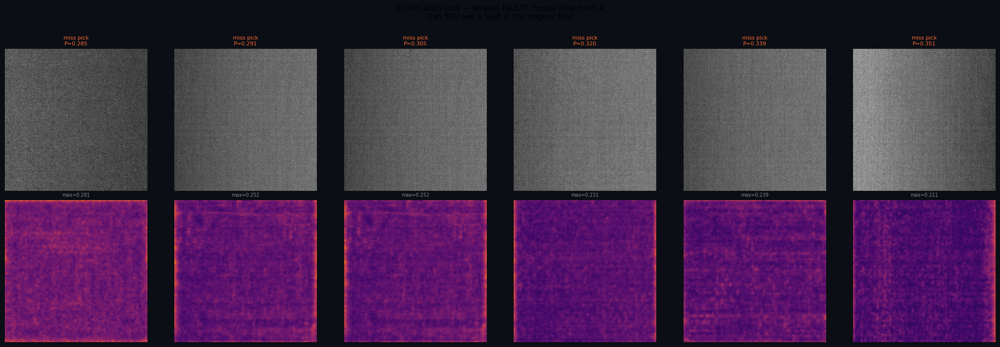

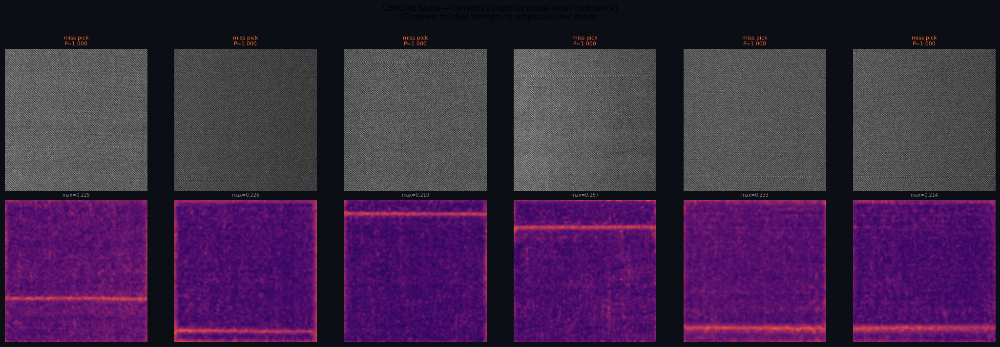

In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 2 — Visualise: suspicious vs genuine faults side by side
#
# Shows what the model sees as "clearly normal" despite faulty label
# vs what it correctly catches. This is the key visual sanity check
# for your data team before they review the CSV.
# ════════════════════════════════════════════════════════════════

from scipy import ndimage as ndi
from skimage import exposure

def apply_clahe(g):
    return exposure.equalize_adapthist(g/255.0, clip_limit=0.02).astype(np.float32)

def compute_residual(img):
    N_PEAKS=11; PEAK_RADIUS=8; DC_SUPPRESS_RADIUS=3; RESIDUAL_SMOOTH=5
    h,w=img.shape; cy,cx=h//2,w//2
    F=np.fft.fft2(img-img.mean()); Fshift=np.fft.fftshift(F)
    mag=np.log1p(np.abs(Fshift)); mag_copy=mag.copy()
    y_,x_=np.ogrid[:h,:w]
    mag_copy[(x_-cx)**2+(y_-cy)**2<=DC_SUPPRESS_RADIUS**2]=0.0
    flat_idx=np.argsort(mag_copy.ravel())[::-1]; peak_coords=[]
    for idx in flat_idx:
        if len(peak_coords)>=N_PEAKS: break
        yy,xx=idx//w,idx%w
        if mag_copy[yy,xx]<=0: continue
        if any((yy-py)**2+(xx-px)**2<=(PEAK_RADIUS*1.5)**2 for py,px in peak_coords): continue
        peak_coords.append((yy,xx))
    mask=np.zeros((h,w),dtype=np.uint8)
    for (py,px) in peak_coords:
        yy,xx=np.ogrid[:h,:w]
        mask[(yy-py)**2+(xx-px)**2<=PEAK_RADIUS**2]=1
        symy,symx=(h-py)%h,(w-px)%w
        mask[(yy-symy)**2+(xx-symx)**2<=PEAK_RADIUS**2]=1
    mask[cy-2:cy+3,cx-2:cx+3]=1
    recon=np.real(np.fft.ifft2(np.fft.ifftshift(Fshift*mask))).astype(np.float32)
    on=(img-img.min())/(img.max()-img.min()+1e-12)
    rn=(recon-recon.min())/(recon.max()-recon.min()+1e-12)
    return ndi.gaussian_filter(np.abs(on-rn), sigma=RESIDUAL_SMOOTH)

def tile_grid(paths_probs, title, vmax=0.35, n=6):
    """Show n tiles: top row = original, bottom row = residual."""
    sample = paths_probs[:n]
    fig, axes = plt.subplots(2, len(sample), figsize=(len(sample)*3.5, 7))
    fig.patch.set_facecolor("#0b0e14")
    if len(sample) == 1: axes = axes.reshape(2,1)
    for j, (path, prob, ft) in enumerate(sample):
        bgr  = cv2.imread(path)
        gray = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY).astype(np.float32)
        img  = apply_clahe(gray)
        res  = compute_residual(img)
        axes[0,j].imshow(gray, cmap="gray")
        axes[0,j].set_title(f"{ft}\nP={prob:.3f}", fontsize=8, color="#ff6b35")
        axes[0,j].axis("off")
        axes[1,j].imshow(res, cmap="inferno", vmin=0, vmax=vmax)
        axes[1,j].set_title(f"max={res.max():.3f}", fontsize=7, color="#888")
        axes[1,j].axis("off")
    plt.suptitle(title, fontsize=11, y=1.01)
    plt.tight_layout(); plt.show()

# Suspicious: model says clearly normal despite faulty label
susp_list = [(r["path"], r["oof_prob"], r["fault_type"])
             for _, r in suspicious.sort_values("oof_prob").head(6).iterrows()]
tile_grid(susp_list,
          f"SUSPICIOUS tiles — labeled FAULTY, model P(fault)<{SUSPICION_THRESHOLD}\n"
          "Can YOU see a fault in the original tile?")

# Genuine: correctly caught faults for comparison
tp_df = df[(df["label"]==1) & (df["oof_pred"]==1)].nlargest(6, "oof_prob")
tp_list = [(r["path"], r["oof_prob"], r["fault_type"])
           for _, r in tp_df.iterrows()]
tile_grid(tp_list,
          "GENUINE faults — correctly caught by model (high confidence)\n"
          "Compare residual strength to suspicious tiles above")

In [ ]:
# ════════════════════════════════════════════════════════════════
# CELL 3 — Retrain after cleaning
#
# Two cleaning strategies, run whichever applies:
#
# STRATEGY A — Conservative (recommended first):
#   Drop tiles where model P(fault) < SUSPICION_THRESHOLD.
#   No manual review needed. Removes most likely mislabeled tiles.
#   Risk: might drop a few genuine subtle faults.
#
# STRATEGY B — Manual review (gold standard):
#   Load suspicious_tiles.csv after data team fills review_verdict.
#   Only drop tiles marked "mislabeled".
#   Slower but more precise.
#
# Either way: retrain and compare metrics.
# ════════════════════════════════════════════════════════════════

from sklearn.svm import SVC
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import StratifiedKFold, cross_validate, cross_val_predict
from sklearn.metrics import (f1_score, precision_score, recall_score,
                             precision_recall_curve, confusion_matrix)
import joblib, warnings
warnings.filterwarnings("ignore")

CLEANING_STRATEGY = "A"   # change to "B" after manual review

if CLEANING_STRATEGY == "A":
    # Drop suspicious tiles automatically
    drop_mask = (df["label"] == 1) & (df["oof_prob"] < SUSPICION_THRESHOLD)
    df_clean  = df[~drop_mask].copy()
    print(f"Strategy A: dropped {drop_mask.sum()} suspicious fault tiles")

elif CLEANING_STRATEGY == "B":
    review_df = pd.read_csv("suspicious_tiles.csv")
    mislabeled_paths = set(
        review_df[review_df["review_verdict"] == "mislabeled"]["tile_path"]
    )
    drop_mask = df["path"].isin(mislabeled_paths)
    df_clean  = df[~drop_mask].copy()
    print(f"Strategy B: dropped {drop_mask.sum()} manually confirmed mislabeled tiles")

print(f"\nDataset before cleaning: {len(df)} tiles  "
      f"({(df.label==0).sum()} N / {(df.label==1).sum()} F)")
print(f"Dataset after  cleaning: {len(df_clean)} tiles  "
      f"({(df_clean.label==0).sum()} N / {(df_clean.label==1).sum()} F)")

FEATURE_COLS = [c for c in df_clean.columns if c not in ("label","fault_type","path","oof_prob","oof_pred","correct")]
X_clean = df_clean[FEATURE_COLS].values
y_clean = df_clean["label"].values

clf_clean = Pipeline([
    ("scaler", StandardScaler()),
    ("svm",    SVC(kernel="rbf", C=1.0, class_weight="balanced",
                   probability=True, random_state=42)),
])

cv      = StratifiedKFold(5, shuffle=True, random_state=42)
results = cross_validate(clf_clean, X_clean, y_clean, cv=cv,
                         scoring=["f1","roc_auc","precision","recall"],
                         return_train_score=True)

PREV = {"f1":0.905, "roc_auc":0.948, "precision":0.996, "recall":0.830}
print("\n5-Fold CV — after dataset cleaning")
print("═"*65)
print(f"  {'Metric':12s}  {'Test':>16s}  {'Train':>8s}  {'Gap':>7s}  {'vs dirty':>10s}")
print(f"  {'─'*60}")
for m in ["f1","roc_auc","precision","recall"]:
    test  = results[f"test_{m}"]
    train = results[f"train_{m}"]
    gap   = train.mean() - test.mean()
    delta = test.mean() - PREV[m]
    arrow = f"↑{abs(delta):.3f}" if delta>0.002 else f"↓{abs(delta):.3f}" if delta<-0.002 else f"={abs(delta):.3f}"
    flag  = " ⚠" if gap>0.10 else " ✓"
    print(f"  {m:12s}  {test.mean():.3f} ± {test.std():.3f}   "
          f"{train.mean():.3f}   {gap:+.3f}{flag}   {arrow}")
print("═"*65)

# Per-fault-type recall on clean dataset
oof_pred_clean = cross_val_predict(clf_clean, X_clean, y_clean, cv=cv)
print("\nPer-fault-type recall (clean dataset):")
for ft in df_clean["fault_type"].unique():
    mask = df_clean["fault_type"] == ft
    if ft == "normal":
        spec = (oof_pred_clean[mask] == 0).mean()
        print(f"  normal           specificity={spec:.3f}")
    else:
        rec = recall_score(y_clean[mask], oof_pred_clean[mask], zero_division=0)
        print(f"  {ft:20s} recall={rec:.3f}  (n={mask.sum()})")

# Threshold tuning
oof_proba_clean = cross_val_predict(clf_clean, X_clean, y_clean,
                                    cv=cv, method="predict_proba")[:,1]
pr_arr, rec_arr, thr_arr = precision_recall_curve(y_clean, oof_proba_clean)
valid = rec_arr[:-1] >= 0.90
if valid.any():
    best_idx    = np.where(valid)[0][np.argmax(pr_arr[:-1][valid])]
    best_thresh = float(thr_arr[best_idx])
    best_f1     = f1_score(y_clean, (oof_proba_clean>=best_thresh).astype(int))
    cm          = confusion_matrix(y_clean, (oof_proba_clean>=best_thresh).astype(int))
    print(f"\nQC threshold={best_thresh:.3f}  F1={best_f1:.3f}")
    print(f"  FN (missed faults) : {cm[1,0]}")
    print(f"  FP (false alarms)  : {cm[0,1]}")
else:
    best_thresh = 0.5
    print("⚠ Could not reach recall=0.90")

# Save clean model
clf_clean.fit(X_clean, y_clean)
os.makedirs("model_clean", exist_ok=True)
joblib.dump(clf_clean,    "model_clean/fault_detector.pkl")
joblib.dump(best_thresh,  "model_clean/qc_threshold.pkl")
joblib.dump(FEATURE_COLS, "model_clean/feature_cols.pkl")
joblib.dump({"edge_margin": 0, "cleaning_strategy": CLEANING_STRATEGY,
             "suspicion_threshold": SUSPICION_THRESHOLD},
            "model_clean/pipeline_config.pkl")
df_clean[["path","label","fault_type"]].to_csv(
    "model_clean/training_manifest.csv", index=False)

print(f"\nSaved to model_clean/")
print(f"Training manifest: {len(df_clean)} tiles "
      f"({drop_mask.sum()} dropped vs original)")

Strategy A: dropped 24 suspicious fault tiles

Dataset before cleaning: 1406 tiles  (207 N / 1199 F)
Dataset after  cleaning: 1382 tiles  (207 N / 1175 F)

5-Fold CV — after dataset cleaning
═════════════════════════════════════════════════════════════════
  Metric                    Test     Train      Gap    vs dirty
  ────────────────────────────────────────────────────────────
  f1            0.902 ± 0.010   0.902   -0.000 ✓   ↓0.003
  roc_auc       0.927 ± 0.012   0.938   +0.011 ✓   ↓0.021
  precision     0.998 ± 0.003   0.998   -0.000 ✓   =0.002
  recall        0.823 ± 0.017   0.823   -0.000 ✓   ↓0.007
═════════════════════════════════════════════════════════════════

Per-fault-type recall (clean dataset):
  normal           specificity=0.990
  miss pick            recall=0.816  (n=1073)
  double pick          recall=0.871  (n=85)
  broken pick          recall=1.000  (n=17)

QC threshold=0.541  F1=0.930
  FN (missed faults) : 117
  FP (false alarms)  : 43

Saved to model_clean/
T

# Fabric Fault Detection — Concepts Reference
### Everything we used to make decisions, explained from scratch

---

## Part 1 — The Core Problem Setup

### What is binary classification?

You have tiles. Each tile is either NORMAL or FAULTY. A classifier is a function that takes a tile and outputs one of two answers. That's it.

The challenge is that "faulty" is not a single thing — miss-pick, double-pick, broken-pick are all faulty, but they look different. For Stage 1, we treat all fault types as one class. The model only needs to answer: "is something wrong here?"

### What is a feature?

A feature is a single number computed from a tile's residual map that carries information about whether the tile is faulty. Instead of feeding the raw 896×896 image (which is 802,816 numbers) to the model, we compress it into 12 carefully chosen numbers.

Good features: high for faulty tiles, low for normal tiles (or vice versa), consistently.

Bad features: similar for both classes, or high variance within the same class.

The entire first phase of our work was finding which 12 numbers best separate the two classes.

---

## Part 2 — How We Chose Features: The KS Statistic

### The Kolmogorov-Smirnov (KS) statistic

Before training any model, we need to know: does this feature actually carry signal? Is the distribution of this feature different between normal and faulty tiles?

The KS statistic measures exactly this. Here is the intuition:

Imagine plotting a histogram of `residual_mean` for all 207 normal tiles (green bars) and all 1199 faulty tiles (orange bars). If the two histograms completely overlap, the feature is useless — knowing the residual_mean of a tile tells you nothing about whether it's faulty. If the histograms are completely separated with no overlap, the feature is perfect.

KS stat = 0.0 → histograms are identical → feature is useless
KS stat = 1.0 → histograms don't overlap at all → feature is perfect
KS stat = 0.45 → moderate separation → useful feature

More precisely: the KS statistic is the maximum vertical distance between the two cumulative distribution functions. But you don't need to remember that — just remember higher KS = better separation.

**The p-value** that appears alongside KS answers a different question: "could this separation have happened by random chance?" A p-value of 0.0001 means there is a 0.01% chance the two distributions are actually the same and we just got unlucky with our sample. A p-value of 0.82 (like we saw for `new_mean`) means 82% chance the two distributions are identical — that feature is noise.

**Our key findings from KS analysis:**

| Feature | KS stat | What it means |
|---|---|---|
| row_max_prominence | 0.720 | Very strong — row spike reliably distinguishes classes |
| grid_mean_std | 0.460 | Strong — spatial non-uniformity separates classes |
| old_mean (new normalisation) | 0.100, p=0.82 | Useless — new normalisation destroyed this feature |

The KS analysis directly told us to keep old-style normalisation and confirmed that row projection features were the strongest signal.

---

## Part 3 — Evaluating the Model: Precision, Recall, F1

Once you have a model, you need to measure how good it is. There are four possible outcomes for any tile:

```
                    Model says NORMAL    Model says FAULTY
Tile IS normal   →  True Negative (TN)   False Positive (FP)  ← false alarm
Tile IS faulty   →  False Negative (FN)  True Positive (TP)   ← caught fault
```

**FN = missed fault.** A faulty tile the model called normal.
**FP = false alarm.** A normal tile the model called faulty.

In a QC context, FN is almost always the more costly error — a missed fault reaches the customer. FP just means unnecessary re-inspection.

### Precision

Of all the tiles the model CALLED faulty, what fraction actually were faulty?

```
Precision = TP / (TP + FP)
```

Precision = 0.99 means: when the model says "faulty," it's right 99% of the time. Very few false alarms.

Low precision = many false alarms. Inspectors get called in constantly for tiles that are actually fine. They start ignoring the model.

### Recall (also called Sensitivity or True Positive Rate)

Of all the tiles that ACTUALLY ARE faulty, what fraction did the model catch?

```
Recall = TP / (TP + FN)
```

Recall = 0.83 means: the model catches 83% of actual faults. 17% slip through.

Low recall = many missed faults. Bad in QC because faulty products reach customers.

**The tension between precision and recall:**

You can always increase recall to 100% by calling every tile faulty. You'll catch every fault but your precision will be terrible (lots of false alarms).

You can always increase precision to 100% by only calling a tile faulty when you're extremely certain. You'll have no false alarms but your recall will be terrible (lots of missed faults).

This is why you can't optimise both simultaneously. The threshold (the probability cutoff above which you call a tile faulty) controls the tradeoff.

### F1 Score

F1 is the harmonic mean of precision and recall. It combines both into a single number.

```
F1 = 2 × (Precision × Recall) / (Precision + Recall)
```

Harmonic mean specifically punishes imbalance — if either precision or recall is very low, F1 drops sharply even if the other is high.

F1 = 1.0 → perfect (both precision and recall are 1.0)
F1 = 0.0 → useless
F1 = 0.905 → what we achieved

F1 is appropriate when you care about both precision and recall and your classes are imbalanced (many more faulty than normal tiles in our case, or vice versa).

### ROC-AUC (Area Under the ROC Curve)

ROC stands for Receiver Operating Characteristic. The ROC curve plots True Positive Rate (recall) against False Positive Rate at every possible threshold.

AUC (Area Under the Curve) summarises the entire curve as a single number:

AUC = 0.50 → the model is no better than random guessing
AUC = 1.00 → perfect model
AUC = 0.948 → what we achieved

The key property of AUC: it is **threshold-independent**. It measures the model's inherent ability to rank faulty tiles above normal tiles, regardless of where you set the cutoff. This makes it useful for comparing two models independent of threshold tuning.

**When to use which metric:**

- F1: when you want to summarise single-threshold performance
- AUC: when comparing models independent of threshold choice
- Recall: when missing faults is the primary concern (QC context)
- Precision: when false alarms are costly (human inspection time)

---

## Part 4 — Validation: Cross-Validation and the Train/Test Gap

### Why you can't evaluate on training data

If you train a model on 1000 tiles and then test it on those same 1000 tiles, it will appear to perform perfectly — it has simply memorised the answers. This tells you nothing about how it performs on new tiles it's never seen.

You need to evaluate on data the model has never seen during training.

### Stratified K-Fold Cross-Validation

We used 5-fold stratified cross-validation throughout. Here's what that means:

1. Shuffle your dataset randomly
2. Split into 5 equal chunks (folds)
3. Train on folds 1+2+3+4, test on fold 5 → get F1₁
4. Train on folds 1+2+3+5, test on fold 4 → get F1₂
5. Train on folds 1+2+4+5, test on fold 3 → get F1₃
6. Train on folds 2+3+4+5, test on fold 1 → get F1₄
7. Train on folds 1+3+4+5, test on fold 2 → get F1₅
8. Final estimate = average of F1₁ through F1₅

"Stratified" means each fold preserves the original class ratio. If your dataset is 15% normal and 85% faulty, each fold is also 15/85. This is important when classes are imbalanced — without stratification, one fold might accidentally have no faulty tiles.

The result: `F1 = 0.905 ± 0.005` means the average across 5 folds was 0.905, and the standard deviation of those 5 values was 0.005 (very consistent).

### The Train/Test Gap

In the CV results we always reported both test and train scores:

```
f1    test=0.905  train=0.909   gap=+0.004 ✓
```

Gap = train score − test score.

**Small gap (~0.00–0.05):** The model generalises well. What it learned on training data holds on new data. This is what you want.

**Large gap (>0.15):** Overfitting. The model memorised the training data rather than learning general patterns. It performs well on tiles it's seen, but badly on new tiles.

We saw this early on with 51 features:
```
f1    test=0.792   train=0.974   gap=+0.183 ⚠
```

The fix was reducing to 6 features — with 400 samples and 51 features, there were only 8 samples per feature. Not enough for the model to learn general patterns. At 6 features we had 67 samples per feature and the gap collapsed to 0.003.

**Rule of thumb:** You want at least 20–30 training samples per feature for a Random Forest or SVM to generalise reliably.

### Out-of-Fold (OOF) Predictions

When we needed per-tile probability estimates (for threshold tuning, confusion matrices, error analysis), we used OOF predictions. Each tile is predicted exactly once, by the model fold that never saw it during training. This gives honest probability estimates for every tile simultaneously.

---

## Part 5 — The Model: SVM

### Why SVM and not a neural network?

You have ~1400 tiles. Neural networks typically need tens of thousands of examples to learn reliably. With 1400 tiles, a neural network would overfit badly.

SVM (Support Vector Machine) works well on small datasets because it finds a decision boundary (a hyperplane) that maximises the margin between classes. It's mathematically principled, has few parameters to tune, and doesn't need much data.

### The RBF kernel

We used `kernel="rbf"` (Radial Basis Function). This allows the SVM to draw non-linear decision boundaries. Without it, SVM can only separate classes with a straight line in feature space — which would miss curves and complex separations.

The RBF kernel maps your features into a higher-dimensional space where a linear boundary in that space corresponds to a curved boundary in the original space.

### `class_weight="balanced"`

Our dataset had 207 normal tiles and 1175 faulty tiles — a roughly 1:5.7 imbalance. Without correction, the SVM would learn to call everything faulty (it would be right 85% of the time just from statistics alone).

`class_weight="balanced"` automatically weights each sample inversely proportional to class frequency. Normal tiles get 5.7× more weight in the loss function than faulty tiles. This forces the model to take both classes seriously.

### StandardScaler

SVM is sensitive to the scale of features. `row_max_prominence` might have values in the range 0.00–0.15, while `kurt` might range from 0 to 50. Without scaling, the SVM would be dominated by the numerically larger features.

StandardScaler transforms each feature to have mean=0 and standard deviation=1. After scaling, all features are on the same footing.

---

## Part 6 — Threshold Tuning

The SVM outputs a probability: P(faulty). The default threshold is 0.50 — if P > 0.50, call it faulty.

But 0.50 is arbitrary. In a QC context where missing faults is worse than false alarms, you want a lower threshold — you'd rather flag more tiles for review than miss a fault.

The Precision-Recall curve sweeps through every possible threshold and shows what precision and recall you get at each one. From this curve we find the threshold that achieves our target recall (0.90) while maximising precision.

In our final model:

| Threshold | F1 | Precision | Recall | FN | FP |
|---|---|---|---|---|---|
| 0.50 (default) | 0.914 | 0.903 | 0.927 | 119 | 73 |
| 0.641 (QC-tuned) | 0.930 | 0.937 | 0.901 | 117 | 43 |

The QC threshold at 0.641 catches nearly as many faults (recall 0.901 vs 0.927) but with far fewer false alarms (43 vs 73). This is the threshold saved to `model_clean/qc_threshold.pkl`.

---

## Part 7 — The FFT Pipeline: Why It Works

### The core insight

Fabric has a periodic structure — every thread crossing happens at a predictable interval. The FFT decomposes the image into its frequency components. A periodic weave produces a small number of strong peaks in the frequency spectrum.

Faults break that periodicity. A miss-pick removes a weft thread — one row of crossings disappears. The FFT reconstruction (using only the weave peaks) captures the ideal background pattern. The residual = |original − reconstruction| is what's left over: the part that doesn't fit the periodic pattern.

Faults live in the residual. Normal tiles have near-zero residuals.

### Why we use log magnitude

Raw FFT magnitudes span an enormous range — from near-zero to ~100,000. If you plotted the raw magnitude spectrum, you'd see one extremely bright dot (the DC component, representing average brightness) and everything else would look black.

`log1p(|FFT|)` compresses this range. `log1p(x) = log(1+x)`, which maps 0→0 and 100000→11.5. Now the spectrum is visually meaningful and peak detection works reliably.

### Why we suppress DC

The DC component (the centre of the frequency spectrum) represents the average brightness of the tile. It has nothing to do with the weave pattern — it would be the tallest "peak" and would dominate the peak selection if not suppressed.

### Why OLD-style normalisation

Both `orig_norm` and `recon_norm` are independently min-max scaled to 0..1. This turned out to be better than shared normalisation (KS stat 0.70 vs 0.10 on row_max_prominence with independent normalisation).

The reason: independent normalisation acts as automatic gain control proportional to reconstruction error. Normal tiles fit well → small residual → small gain amplification. Faulty tiles fit poorly → larger error → larger amplification. The amplification is correlated with fault presence, which is exactly what you want.

### Why Tukey windowing failed

Tukey windows taper image edges to zero before FFT — designed to reduce spectral leakage. We tried it and the edge residuals got worse, not better.

The reason: the window tapers `(img − mean) × window` to zero at borders before FFT. So the IFFT reconstruction also goes to near-zero at borders. But `orig_norm` is the original unwindowed image — it has real pixel values at the borders. Residual = |orig_norm − near_zero| = large at borders. The window made the reconstruction artificially wrong at the edges.

Tukey works in the frequency domain. Our residual is computed in the spatial domain. Mismatch.

### The edge margin finding

We tested margin = 0, 32, 64, 96 pixels systematically using KS separation. Key finding:

`row_max_prominence` peaked at margin=0 (KS=0.720 → 0.707 at margin=32). This is because `find_peaks` requires a valley on both sides of a peak — array boundary values can never qualify as peaks. So the projection features had implicit edge protection all along.

Global stats (kurt, std, gini) peaked at margin=32. But their gains (+0.43, +0.33, +0.20) did not compensate for the loss in row_max_prominence (-0.013), because SVM weighs features by their discriminative power and row_max_prominence was by far the strongest feature.

Conclusion: margin=0 is correct. The model already uses the most powerful features correctly.

---

## Part 8 — Feature Design Logic

### Why these 12 features

Every feature was chosen to answer a specific question about the residual that is orthogonal to what other features measure.

**`p95` — How intense is the anomaly?**
95th percentile captures the brightest 5% of pixels. More robust than `max` (single-pixel noise) and more discriminative than `mean` (averaged over 95% near-zero pixels).

**`std` — How much does the residual vary?**
Normal tiles have low, uniform residuals — low std. Faulty tiles have high residual in the fault region and near-zero elsewhere — high std.

**`kurt` (kurtosis) — Are there extreme outlier pixels?**
Kurtosis measures tail heaviness. Normal tiles → roughly Gaussian residual distribution → moderate kurtosis. Faulty tiles → most pixels near zero + small number of very high pixels → heavy right tail → high kurtosis.

**`grid_mean_std` — Is the anomaly localised to part of the tile?**
Divide tile into 3×3 grid, compute mean residual in each of 9 cells, take std of those 9 means. Normal → all cells similar → low std. Faulty → some cells bright, others dark → high std. This was the strongest non-projection feature (KS=0.46).

**`grid_max_ratio` — How much does the hottest region stand out?**
Max grid cell mean divided by overall grid mean. Ratio near 1.0 → uniform → normal. High ratio → one region dominates → faulty.

**`grid_11_max` — Is the fault in the centre?**
Maximum value in the centre third of the tile (position [1,1] in the 3×3 grid). Tiles are often centred during imaging.

**`gini` — How concentrated is the anomaly?**
Borrowed from economics (income inequality). Gini=0 → perfectly uniform residual. Gini near 1 → all energy concentrated in one tiny region. Any localised fault → high gini.

**`grad_p95` — Does the fault have sharp edges?**
Gradient magnitude = how fast the residual changes between adjacent pixels. Real faults have sharp boundaries (high gradient). Normal residual noise is smooth (low gradient).

**`row_max_prominence` — Is there a horizontal stripe?**
The single strongest feature (KS=0.720). Sum residual values row by row → 1D signal. Miss-pick removes a horizontal thread → one row spikes above baseline. Prominence measures spike height above surrounding values, making it robust to overall brightness differences.

**`row_sum_prominence`** — Total stripe anomaly across all detected spikes.

**`row_proj_std`** — How non-uniform is the row projection? Flat → normal. Spiked → faulty.

**`row_peak_width`** — How many rows exceed half the spike height? Thin faults → narrow spike. Wide faults → broad spike. Encodes physical fault thickness.

---

## Part 9 — Dataset Quality and the Contamination Finding

### Label noise

We found 24 tiles labeled "FAULTY" that the model assigned P(fault) < 0.40. Visual inspection confirmed: no fault was visible in the original tile or the residual.

These were mislabeled tiles — normal tiles accidentally placed in the fault directory. This is common at annotation scale: fatigue, file management errors, tiles from adjacent (non-faulty) regions being included.

14.1% apparent FN rate before cleaning → 10% FN rate after dropping 24 tiles. The model wasn't failing — the labels were.

### The 145 borderline tiles

The remaining missed faults (P = 0.40–0.64) are a different problem. These are faults the model is genuinely uncertain about. Likely causes:

- Subtle faults (1 thread missing in a 896×896 tile is visually very hard to spot)
- Inconsistent annotation (the same fault would be labeled differently by different annotators)
- Fault at tile boundary (cut into the tile from the edge, not fully captured)

This is not solvable with better features or more model complexity. It requires cleaner labels and a clear definition from the domain team: "a fault of N threads or less is acceptable and should be labeled NORMAL."

---

## Part 10 — What We Learned About the Bottlenecks

Throughout this project, every time performance plateaued we diagnosed the actual bottleneck before adding complexity. Here's the complete sequence:

**F1=0.601 with 3 features (mean, p99, max)**
Bottleneck: features were measuring the same thing (all intensity, correlated at r>0.85). Added structural features.

**F1=0.792 with 51 features**
Bottleneck: too many features, train/test gap=0.183 (overfitting). 400 samples / 51 features = 8:1 ratio, too low. Pruned to 6 uncorrelated features.

**F1=0.739 with 6 features**
Bottleneck: hit the feature ceiling. Learning curve showed test F1 had plateaued — more data would not help. Added domain-specific row projection features.

**F1=0.878 with 10 features**
`row_max_prominence` alone contributed KS=0.720. This is the most important lesson: domain knowledge (knowing that miss-picks are horizontal stripes) was worth more than any statistical technique.

**F1=0.905 with 12 features, 1406 tiles**
Bottleneck: label noise. 24 mislabeled tiles and 145 genuinely subtle/ambiguous tiles account for most remaining errors.

**F1=0.930 after cleaning**
QC-optimised (recall ≥ 0.90). Current state. Further gains require cleaner data and more examples of subtle faults.

---

## Part 11 — What Still Needs Systematic Work

**FFT parameters (N_PEAKS, PEAK_RADIUS) were never systematically tuned.**
They were set by visual inspection on miss-pick data. The correct approach is a grid search where you sweep (N_PEAKS ∈ {7,9,11,13}, PEAK_RADIUS ∈ {5,6,7,8,9,10}) and measure KS separation on a held-out set. Do this after you have 150+ tiles per fault type — doing it now would just overfit to miss-pick geometry.

**Column projection features are not included.**
`row_max_prominence` detects horizontal stripes. A broken warp fault (missing vertical thread) would create a vertical stripe — detectable via column projection (`col_max_prominence`). Currently excluded because column KS was near-zero on miss-pick-only data. When you have more broken warp data, add these.

**The model is miss-pick biased.**
All feature engineering was validated on miss-pick data (1097 tiles). Double-pick (85 tiles) and broken-pick (17 tiles) are underrepresented. The model catches them via general features (gini, grid_mean_std) but hasn't been explicitly designed for their specific geometry.

FAULTY: 100%|██████████| 150/150 [01:13<00:00,  2.04it/s]



Feature                      OLD KS    NEW KS    Winner        Δ
──────────────────────────────────────────────────────────────────────
  p95                           0.373     0.220     OLD ✓   +0.153
  std                           0.400     0.120     OLD ✓   +0.280
  kurt                          0.227     0.180     OLD ✓   +0.047
  grid_mean_std                 0.493     0.180     OLD ✓   +0.313
  grid_max_ratio                0.487     0.180     OLD ✓   +0.307
  grid_11_max                   0.393     0.180     OLD ✓   +0.213
  gini                          0.327     0.087     OLD ✓   +0.240
  grad_p95                      0.407     0.093     OLD ✓   +0.313
  row_max_prominence            0.740     0.247     OLD ✓   +0.493
  row_sum_prominence            0.607     0.207     OLD ✓   +0.400
  row_proj_std                  0.440     0.180     OLD ✓   +0.260
  row_peak_width                0.607     0.193     OLD ✓   +0.413

  OLD wins: 12/12 features
  NEW wins: 0/12 features
  Tot

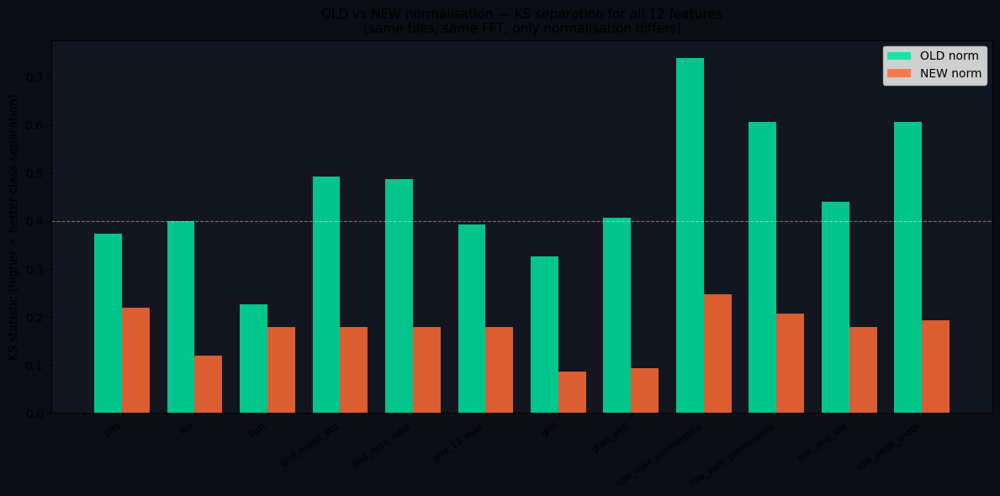


───────────────────────────────────────────────────────
                            OLD norm      NEW norm
  ──────────────────────────────────────────────────
  F1                    0.878±0.034   0.725±0.053  ← OLD
  AUC                   0.957±0.021   0.775±0.048  ← OLD
───────────────────────────────────────────────────────

Verdict:
  OLD normalisation is better (AUC 0.957 vs 0.775, Δ=+0.182)
  Original decision was correct.


In [ ]:
# ════════════════════════════════════════════════════════════════
# Definitive OLD vs NEW normalisation comparison
#
# What the early test missed: it only used mean, p99, max.
# This cell extracts all 12 features from BOTH normalisations
# on the same tiles and compares KS separation + model AUC.
# ════════════════════════════════════════════════════════════════

import numpy as np
import pandas as pd
import cv2
import glob, random
import matplotlib.pyplot as plt
from scipy import ndimage as ndi
from scipy.signal import find_peaks
from scipy.ndimage import gaussian_filter1d
from scipy.stats import ks_2samp
from skimage import exposure
from sklearn.svm import SVC
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import StratifiedKFold, cross_validate
import warnings
warnings.filterwarnings("ignore")
random.seed(42)

# ── Config ────────────────────────────────────────────────────────
NORMAL_DIR   = "tiles_896/normal"
FAULT_DIR    = "tiles_896/Faults/miss pick"
N_SAMPLE     = 150   # per class — enough for stable KS
N_PEAKS      = 11
PEAK_RADIUS  = 8
DC_SUPPRESS_RADIUS = 3
SMOOTH_SIGMA = 5

# ── Core functions ────────────────────────────────────────────────
def apply_clahe(gray):
    return exposure.equalize_adapthist(gray / 255.0, clip_limit=0.02).astype(np.float32)

def fft_components(img):
    h, w   = img.shape
    cy, cx = h // 2, w // 2
    F      = np.fft.fft2(img - img.mean())
    Fshift = np.fft.fftshift(F)
    mag    = np.log1p(np.abs(Fshift))
    mag_copy = mag.copy()
    y_, x_   = np.ogrid[:h, :w]
    mag_copy[(x_-cx)**2 + (y_-cy)**2 <= DC_SUPPRESS_RADIUS**2] = 0.0
    flat_idx = np.argsort(mag_copy.ravel())[::-1]
    peak_coords = []
    for idx in flat_idx:
        if len(peak_coords) >= N_PEAKS: break
        yy, xx = idx // w, idx % w
        if mag_copy[yy, xx] <= 0: continue
        if any((yy-py)**2+(xx-px)**2 <= (PEAK_RADIUS*1.5)**2
               for py, px in peak_coords): continue
        peak_coords.append((yy, xx))
    mask = np.zeros((h, w), dtype=np.uint8)
    for (py, px) in peak_coords:
        yy, xx = np.ogrid[:h, :w]
        mask[(yy-py)**2+(xx-px)**2 <= PEAK_RADIUS**2] = 1
        symy, symx = (h-py)%h, (w-px)%w
        mask[(yy-symy)**2+(xx-symx)**2 <= PEAK_RADIUS**2] = 1
    mask[cy-2:cy+3, cx-2:cx+3] = 1
    recon_raw = np.real(np.fft.ifft2(np.fft.ifftshift(Fshift * mask))).astype(np.float32)
    return img, recon_raw   # original CLAHE image + raw reconstruction

def residual_OLD(img, recon_raw):
    """Independent min-max normalisation of each."""
    on = (img       - img.min())       / (img.max()       - img.min()       + 1e-12)
    rn = (recon_raw - recon_raw.min()) / (recon_raw.max() - recon_raw.min() + 1e-12)
    return ndi.gaussian_filter(np.abs(on - rn), sigma=SMOOTH_SIGMA)

def residual_NEW(img, recon_raw):
    """Shared min-max normalisation."""
    combined_min = min(img.min(),       recon_raw.min())
    combined_max = max(img.max(),       recon_raw.max())
    scale        = combined_max - combined_min + 1e-12
    on = (img       - combined_min) / scale
    rn = (recon_raw - combined_min) / scale
    return ndi.gaussian_filter(np.abs(on - rn), sigma=SMOOTH_SIGMA)

def extract_features(res):
    """All 12 features — identical to production pipeline."""
    h, w  = res.shape
    flat  = res.ravel()
    f     = {}
    f["p95"]  = float(np.percentile(flat, 95))
    f["std"]  = float(flat.std())
    f["kurt"] = float(pd.Series(flat).kurt())
    grid_means = [res[i*h//3:(i+1)*h//3, j*w//3:(j+1)*w//3].mean()
                  for i in range(3) for j in range(3)]
    f["grid_mean_std"]  = float(np.std(grid_means))
    f["grid_max_ratio"] = float(max(grid_means) / (np.mean(grid_means) + 1e-12))
    f["grid_11_max"]    = float(res[h//3:2*h//3, w//3:2*w//3].max())
    s = np.sort(flat); n = len(s)
    f["gini"] = float((2*np.sum(np.arange(1,n+1)*s)) / (n*s.sum()+1e-12) - (n+1)/n)
    gy, gx = np.gradient(res)
    f["grad_p95"] = float(np.percentile(np.sqrt(gx**2+gy**2), 95))
    row_proj = res.mean(axis=1)
    row_s    = gaussian_filter1d(row_proj, sigma=3.0)
    detrend  = row_s - np.median(row_s)
    peaks, props = find_peaks(detrend, prominence=0.01, distance=10)
    prom = props["prominences"] if len(peaks) > 0 else np.array([0.0])
    f["row_max_prominence"] = float(prom.max())
    f["row_sum_prominence"] = float(prom.sum())
    f["row_proj_std"]       = float(row_proj.std())
    f["row_peak_width"]     = int((detrend > detrend[peaks[np.argmax(prom)]]/2).sum()) \
                              if len(peaks) > 0 else 0
    return f

# ── Sample tiles ──────────────────────────────────────────────────
normal_paths = random.sample(glob.glob(f"{NORMAL_DIR}/**/*.jpg", recursive=True), N_SAMPLE)
fault_paths  = random.sample(glob.glob(f"{FAULT_DIR}/**/*.jpg",  recursive=True), N_SAMPLE)

# ── Extract features for BOTH normalisations from SAME tiles ──────
from tqdm import tqdm

records_old, records_new = [], []

for paths, label in [(normal_paths, 0), (fault_paths, 1)]:
    desc = "NORMAL" if label == 0 else "FAULTY"
    for p in tqdm(paths, desc=f"{desc:6s}"):
        bgr = cv2.imread(p)
        if bgr is None: continue
        gray = cv2.cvtColor(bgr, cv2.COLOR_BGR2GRAY).astype(np.float32)
        try:
            img, recon_raw = fft_components(apply_clahe(gray))
            res_old = residual_OLD(img, recon_raw)
            res_new = residual_NEW(img, recon_raw)
            # Same tile, same FFT, only normalisation differs
            f_old = extract_features(res_old); f_old["label"] = label
            f_new = extract_features(res_new); f_new["label"] = label
            records_old.append(f_old)
            records_new.append(f_new)
        except Exception:
            pass

df_old = pd.DataFrame(records_old)
df_new = pd.DataFrame(records_new)
FEATURE_COLS = [c for c in df_old.columns if c != "label"]

# ── KS comparison: all 12 features ───────────────────────────────
print(f"\n{'Feature':25s}  {'OLD KS':>8s}  {'NEW KS':>8s}  {'Winner':>8s}  {'Δ':>7s}")
print("─" * 70)

ks_results = []
for feat in FEATURE_COLS:
    n_old = df_old[df_old.label==0][feat]; f_old_v = df_old[df_old.label==1][feat]
    n_new = df_new[df_new.label==0][feat]; f_new_v = df_new[df_new.label==1][feat]
    ks_old, _ = ks_2samp(n_old, f_old_v)
    ks_new, _ = ks_2samp(n_new, f_new_v)
    delta  = ks_old - ks_new
    winner = "OLD ✓" if ks_old > ks_new else "NEW ✓" if ks_new > ks_old else "TIE"
    ks_results.append({"feature": feat, "ks_old": ks_old, "ks_new": ks_new,
                        "delta": delta, "winner": winner})
    print(f"  {feat:25s}  {ks_old:8.3f}  {ks_new:8.3f}  {winner:>8s}  {delta:+7.3f}")

ks_df = pd.DataFrame(ks_results)
old_wins = (ks_df.winner == "OLD ✓").sum()
new_wins = (ks_df.winner == "NEW ✓").sum()
total_ks_gain_old = ks_df["ks_old"].sum()
total_ks_gain_new = ks_df["ks_new"].sum()

print(f"\n  OLD wins: {old_wins}/{len(FEATURE_COLS)} features")
print(f"  NEW wins: {new_wins}/{len(FEATURE_COLS)} features")
print(f"  Total KS (OLD): {total_ks_gain_old:.3f}")
print(f"  Total KS (NEW): {total_ks_gain_new:.3f}")

# ── Visual: KS bar chart comparison ──────────────────────────────
fig, ax = plt.subplots(figsize=(12, 6))
fig.patch.set_facecolor("#0b0e14")
x      = np.arange(len(FEATURE_COLS))
width  = 0.38
bars_o = ax.bar(x - width/2, ks_df["ks_old"], width, label="OLD norm", color="#00e5a0", alpha=0.85)
bars_n = ax.bar(x + width/2, ks_df["ks_new"], width, label="NEW norm", color="#ff6b35", alpha=0.85)
ax.set_xticks(x)
ax.set_xticklabels(ks_df["feature"], rotation=35, ha="right", fontsize=8)
ax.set_ylabel("KS statistic (higher = better class separation)")
ax.set_title("OLD vs NEW normalisation — KS separation for all 12 features\n"
             "(same tiles, same FFT, only normalisation differs)", fontsize=11)
ax.legend(); ax.set_facecolor("#111620")
ax.axhline(0.40, color="#ffffff", linestyle="--", linewidth=0.8, alpha=0.4, label="KS=0.40 reference")
plt.tight_layout(); plt.show()

# ── Model AUC comparison: same CV setup, both normalisations ─────
cv = StratifiedKFold(5, shuffle=True, random_state=42)
svm = lambda: Pipeline([("sc", StandardScaler()),
                         ("svm", SVC(kernel="rbf", C=1.0, class_weight="balanced",
                                     probability=True, random_state=42))])

X_old = df_old[FEATURE_COLS].fillna(0).values; y_old = df_old["label"].values
X_new = df_new[FEATURE_COLS].fillna(0).values; y_new = df_new["label"].values

res_old_cv = cross_validate(svm(), X_old, y_old, cv=cv,
                             scoring=["f1","roc_auc"], return_train_score=True)
res_new_cv = cross_validate(svm(), X_new, y_new, cv=cv,
                             scoring=["f1","roc_auc"], return_train_score=True)

print(f"\n{'─'*55}")
print(f"  {'':20s}  {'OLD norm':>12s}  {'NEW norm':>12s}")
print(f"  {'─'*50}")
for m, label in [("test_f1","F1"), ("test_roc_auc","AUC")]:
    vo = res_old_cv[m]; vn = res_new_cv[m]
    winner = "← OLD" if vo.mean() > vn.mean() else "← NEW"
    print(f"  {label:20s}  {vo.mean():.3f}±{vo.std():.3f}   {vn.mean():.3f}±{vn.std():.3f}  {winner}")
print(f"{'─'*55}")
print(f"\nVerdict:")
auc_old = res_old_cv["test_roc_auc"].mean()
auc_new = res_new_cv["test_roc_auc"].mean()
if auc_old > auc_new + 0.01:
    print(f"  OLD normalisation is better (AUC {auc_old:.3f} vs {auc_new:.3f}, Δ={auc_old-auc_new:+.3f})")
    print(f"  Original decision was correct.")
elif auc_new > auc_old + 0.01:
    print(f"  NEW normalisation is better (AUC {auc_new:.3f} vs {auc_old:.3f}, Δ={auc_new-auc_old:+.3f})")
    print(f"  ← Original decision was WRONG. Retrain with NEW normalisation.")
else:
    print(f"  Normalisations are equivalent within noise (Δ={abs(auc_old-auc_new):.3f})")
    print(f"  Either is acceptable. Keep OLD for consistency.")